# 0. Import Libraries and Define Basic Functions

In [2]:
from sklearn.cluster import KMeans
from tqdm.notebook import tqdm
import numpy as np
import os
import glob
import librosa

In [3]:
def load_file_f0s_hmags(data_files):
    file_names = []
    f0s_all = []
    hmags_all = []
    for file in data_files:
        # Extract the first two characters of the filename
        file_name = os.path.basename(file)
        file_names.append(file_name)
        
        # Extract f0s and hmags
        data = np.load(file)
        f0s = data['f0']
        f0s_all.append(f0s)
        hmags = data['hmag']
        hmags_all.append(hmags)
    f0s_all_concat = np.concatenate(f0s_all, axis=0)
    hmags_all_concat = np.concatenate(hmags_all, axis=0)
    return file_names, f0s_all, hmags_all, f0s_all_concat, hmags_all_concat

In [4]:
def normalize_hmags(hmags_all):
    weights = np.linalg.norm(hmags_all, axis=1)
    normalized_hmags = (hmags_all / weights[:, np.newaxis]).astype(np.float32)  # Ensure data is float32
    return normalized_hmags, weights

In [5]:
def predict_indices_distances(normalized_hmags, n_clusters = 64):
    kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(normalized_hmags)
    indices = kmeans.predict(normalized_hmags)
    distances = kmeans.transform(normalized_hmags)
    return indices, distances

# 1. Timbre Data(hmag) Analysis
Show 25 Harmonic Distribution  
x: hmag value, y: occurence

In [56]:
!pwd

/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP/constrained-harmonic-resynthesis


In [57]:
f_npz = np.load("../ViolinEtudes-zenodo-downsample_2025/anal/train/02wFsdCE1o4kw00000186.npz")
print(f_npz, type(f_npz))
f_npz['time'].shape, f_npz['f0'].shape, f_npz['hfreq'].shape, f_npz['hmag'].shape

NpzFile '../ViolinEtudes-zenodo-downsample_2025/anal/train/02wFsdCE1o4kw00000186.npz' with keys: time, f0, hfreq, hmag <class 'numpy.lib.npyio.NpzFile'>


((59046,), (59046,), (59046, 25), (59046, 25))

In [58]:
data_files = glob.glob('../ViolinEtudes-zenodo-downsample_2025/anal/train/*.npz')
print(len(data_files))
file_names, f0s_all, hmags_all, f0s_all_concat, hmags_all_concat = load_file_f0s_hmags(data_files)

30


In [59]:
normalized_hmags_concat, _ = normalize_hmags(hmags_all_concat)

In [61]:
normalized_hmags_concat.shape

(929018, 25)

In [6]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
# Load npz files and apply scaling methods
#npz_dir = '../ViolinEtudes-zenodo-test/anal/with_timestamps/train_set'
#npz_dir = '../ViolinEtudes-zenodo-downsample_2025/anal/crepe'
basic_dir = '/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP'
npz_dir = '../ViolinEtudes-zenodo-downsample_2025/train/anal/crepe'
hmag_list = []


for file in os.listdir(npz_dir):
    if file.endswith('.npz'):
        file_path = os.path.join(npz_dir, file)
        data = np.load(file_path)
        hmag = data['hmag']

        hmag_list.append(hmag)


# Combine all data
hmag_combined = np.vstack(hmag_list)

In [7]:
len(hmag_list), hmag_list[1].shape, type(hmag_list[1]), hmag_list[1].shape

(30, (13264, 25), numpy.ndarray, (13264, 25))

In [8]:
hmag_combined.shape

(964191, 25)

## 1.0 hmag Statistics

In [9]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Define function to plot histograms with KDE for each harmonic magnitude
def plot_histograms_with_kde(hmag_data, title):
    plt.figure(figsize=(20, 20))
    for i in range(25):
        plt.subplot(5, 5, i+1)
        #filtered_data = hmag_data[hmag_data[:, i] != -100, i]  # Filter out values equal to -100
        #filtered_data = hmag_data
        filtered_data = hmag_data[~np.isnan(hmag_data[:, i]), i]  # Filter out NaN values
        sns.histplot(filtered_data, kde=True, bins=30)
        plt.title(f'Harmonic {i+1}')
        plt.xlabel('Magnitude')
        plt.ylabel('Frequency')
    plt.suptitle(title)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

# Define function to calculate and print skewness
def calculate_skewness(hmag_data, title):
    skewness_values = []
    for i in range(25):
        #filtered_data = hmag_data[hmag_data[:, i] != -100, i]  # Filter out values equal to -100
        filtered_data = hmag_data[~np.isnan(hmag_data[:, i]), i]  # Filter out NaN values
        skewness = stats.skew(filtered_data, nan_policy='omit')
        skewness_values.append(skewness)
        print(f'Harmonic {i+1} Skewness: {skewness:.4f}')
    avg_skewness = np.mean(skewness_values)
    print(f'Average Skewness for {title}: {avg_skewness:.4f}')

In [10]:
# Filter out the clipped value -100
hmag_filtered = np.where(hmag_combined == -100, np.nan, hmag_combined)

# Ensure that -100 values are properly filtered out
print("Checking for -100 values in the filtered data:", np.any(hmag_filtered == -100))

Checking for -100 values in the filtered data: False


In [11]:
np.nanmax(hmag_filtered), np.nanmin(hmag_filtered)

(-8.166750954996964, -89.99983811444447)

In [12]:
type(hmag_filtered), hmag_filtered.shape

(numpy.ndarray, (964191, 25))

In [13]:
type(hmag_combined), hmag_combined.shape

(numpy.ndarray, (964191, 25))

In [14]:
import os
import numpy as np
import pandas as pd
import json

# Save filtered data as NPY (efficient binary format)
np.save("./hmag_analysis/hmag_filtered.npy", hmag_filtered)
print("Filtered data saved: hmag_filtered.npy")

# Calculate statistical summary for each harmonic
summary = {
    "harmonic_mean": np.nanmean(hmag_filtered, axis=0).tolist(),
    "harmonic_std": np.nanstd(hmag_filtered, axis=0).tolist(),
    "harmonic_min": np.nanmin(hmag_filtered, axis=0).tolist(),
    "harmonic_25%": np.nanpercentile(hmag_filtered, 25, axis=0).tolist(),
    "harmonic_50%": np.nanpercentile(hmag_filtered, 50, axis=0).tolist(),
    "harmonic_75%": np.nanpercentile(hmag_filtered, 75, axis=0).tolist(),
    "harmonic_max": np.nanmax(hmag_filtered, axis=0).tolist(),
    "nan_percentage": (np.isnan(hmag_filtered).sum(axis=0) / hmag_filtered.shape[0] * 100).tolist(),
    "total_frames": hmag_filtered.shape[0],
    "total_harmonics": hmag_filtered.shape[1]
}

# Save summary to JSON
with open("./hmag_analysis/hmag_summary.json", "w") as f:
    json.dump(summary, f, indent=2)
print("Statistical summary saved: hmag_summary.json")

# Random sample of 1000 frames
np.random.seed(42)  # For reproducibility
sample_indices = np.random.choice(hmag_filtered.shape[0], 1000, replace=False)
sample_data = hmag_filtered[sample_indices]

# Save sample to CSV
pd.DataFrame(sample_data, columns=[f"harmonic_{i+1}" for i in range(25)]).to_csv("./hmag_analysis/hmag_sample_1000.csv", index=False)
print("Sample data saved: hmag_sample_1000.csv")

# Print preview of summary statistics
print("\nSummary preview (first harmonic only):")
for stat, values in summary.items():
    if isinstance(values, list) and len(values) > 0:
        print(f"{stat}: {round(values[0], 4)}")
    else:
        print(f"{stat}: {values}")

Filtered data saved: hmag_filtered.npy
Statistical summary saved: hmag_summary.json
Sample data saved: hmag_sample_1000.csv

Summary preview (first harmonic only):
harmonic_mean: -33.9439
harmonic_std: 11.5111
harmonic_min: -89.9457
harmonic_25%: -41.2654
harmonic_50%: -33.1735
harmonic_75%: -25.4517
harmonic_max: -8.1668
nan_percentage: 0.383
total_frames: 964191
total_harmonics: 25


## 1.1. Original hmag Distribution

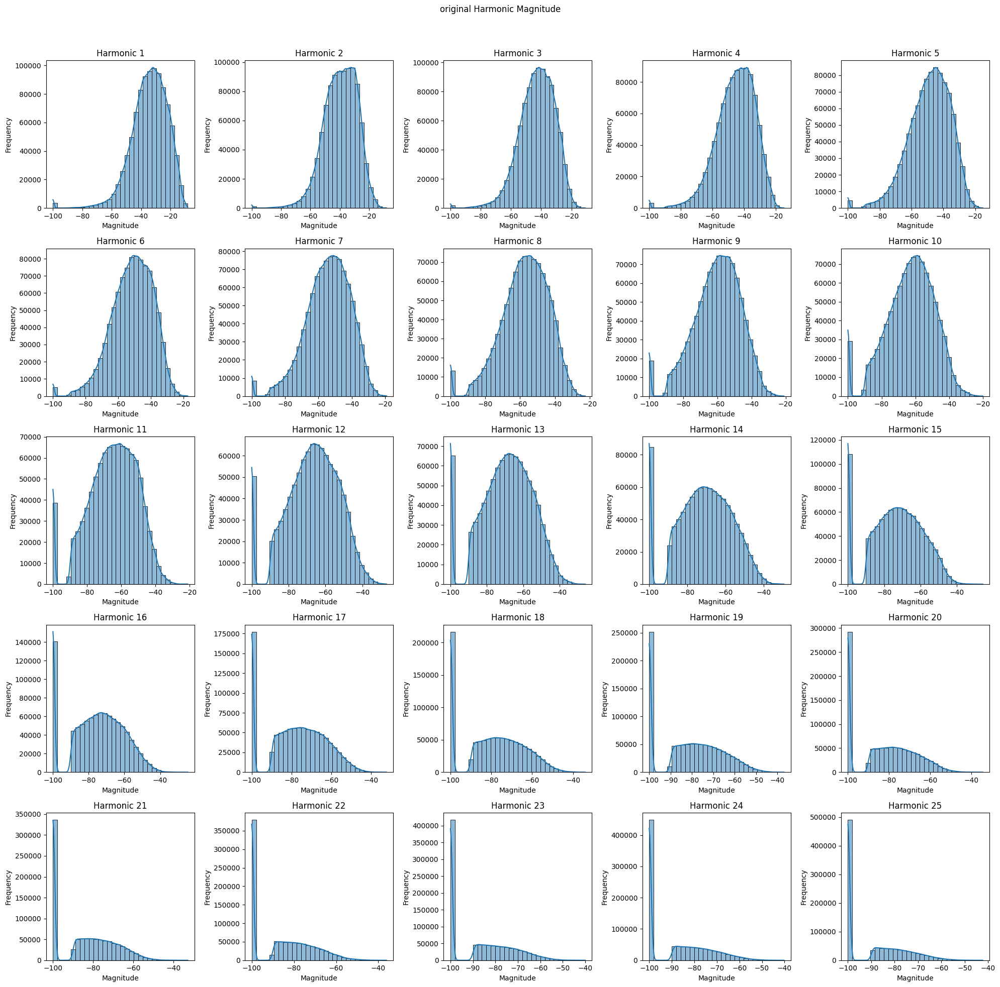

In [15]:
# Plot original data
plot_histograms_with_kde(hmag_combined, "original Harmonic Magnitude")

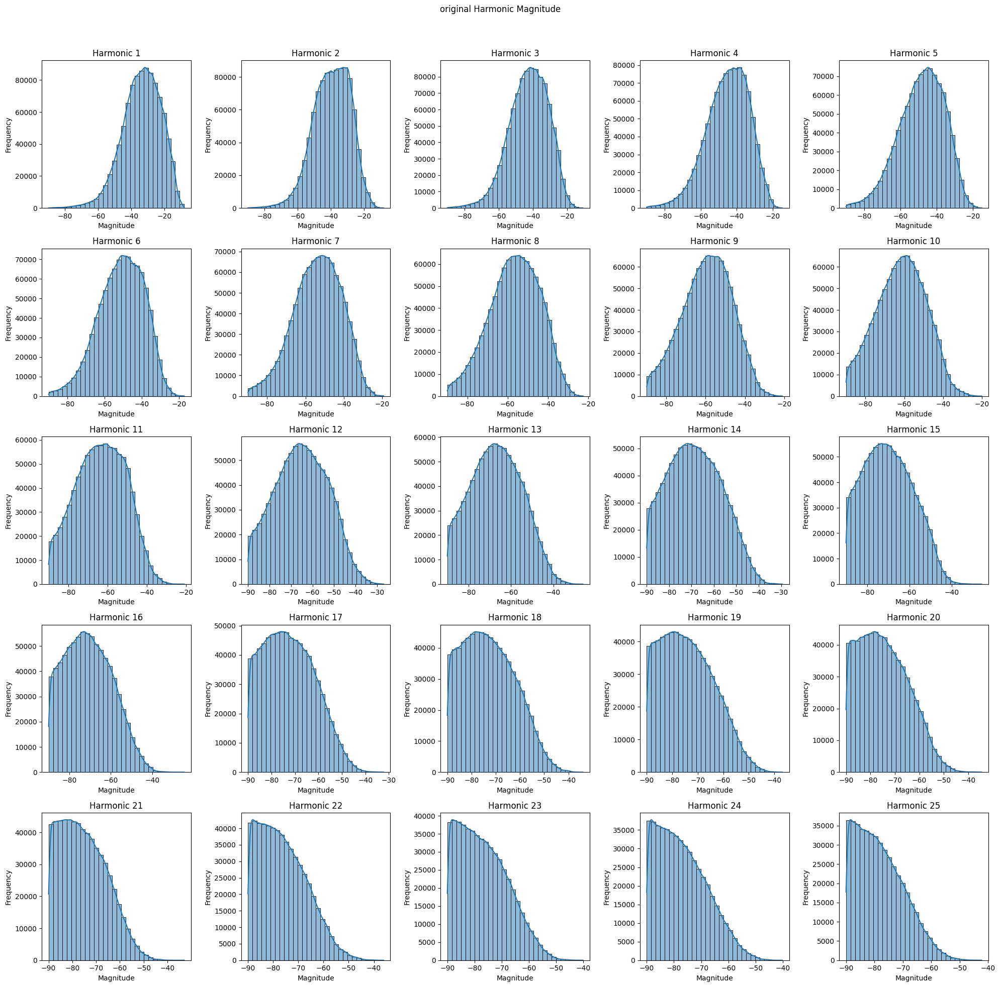

In [16]:
# Plot original data
plot_histograms_with_kde(hmag_filtered, "original Harmonic Magnitude")

In [334]:
calculate_skewness(hmag_combined, "original Harmonic Magnitude (combined)")

Harmonic 1 Skewness: -0.9991
Harmonic 2 Skewness: -0.5842
Harmonic 3 Skewness: -0.6094
Harmonic 4 Skewness: -0.7120
Harmonic 5 Skewness: -0.6179
Harmonic 6 Skewness: -0.5669
Harmonic 7 Skewness: -0.5452
Harmonic 8 Skewness: -0.5393
Harmonic 9 Skewness: -0.4840
Harmonic 10 Skewness: -0.4232
Harmonic 11 Skewness: -0.4027
Harmonic 12 Skewness: -0.3723
Harmonic 13 Skewness: -0.3339
Harmonic 14 Skewness: -0.2533
Harmonic 15 Skewness: -0.2147
Harmonic 16 Skewness: -0.1632
Harmonic 17 Skewness: -0.0941
Harmonic 18 Skewness: -0.0133
Harmonic 19 Skewness: 0.0701
Harmonic 20 Skewness: 0.1536
Harmonic 21 Skewness: 0.2631
Harmonic 22 Skewness: 0.4096
Harmonic 23 Skewness: 0.4779
Harmonic 24 Skewness: 0.5948
Harmonic 25 Skewness: 0.6959
Average Skewness for original Harmonic Magnitude (combined): -0.2105


In [17]:
calculate_skewness(hmag_filtered, "original Harmonic Magnitude (filtered)")

Harmonic 1 Skewness: -0.5394
Harmonic 2 Skewness: -0.4316
Harmonic 3 Skewness: -0.4444
Harmonic 4 Skewness: -0.4894
Harmonic 5 Skewness: -0.4203
Harmonic 6 Skewness: -0.3615
Harmonic 7 Skewness: -0.2924
Harmonic 8 Skewness: -0.2418
Harmonic 9 Skewness: -0.1765
Harmonic 10 Skewness: -0.0678
Harmonic 11 Skewness: -0.0391
Harmonic 12 Skewness: 0.0365
Harmonic 13 Skewness: 0.1042
Harmonic 14 Skewness: 0.1856
Harmonic 15 Skewness: 0.2370
Harmonic 16 Skewness: 0.2807
Harmonic 17 Skewness: 0.3251
Harmonic 18 Skewness: 0.3496
Harmonic 19 Skewness: 0.3990
Harmonic 20 Skewness: 0.4210
Harmonic 21 Skewness: 0.4517
Harmonic 22 Skewness: 0.5635
Harmonic 23 Skewness: 0.5127
Harmonic 24 Skewness: 0.5732
Harmonic 25 Skewness: 0.6067
Average Skewness for original Harmonic Magnitude (filtered): 0.0617


# 2. KMeans Clustering

In [18]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

## 2.1. NaN Analysis

In [19]:
# Presume hmag_filtered is in my notebook：
# type(hmag_filtered), hmag_filtered.shape -> (numpy.ndarray, (1165192, 25))

# 1. First，caculate every column NaN ratio，and decide if discard high-NaN-ratio columns or not
nan_pct = np.isnan(hmag_filtered).mean(axis=0)
nan_rate = 0.5                 # only retain hmags with NaN ratio < 50%
keep_cols = nan_pct < nan_rate    

print(f"In original 25 dimensions，high NaN: {nan_rate:.2%} column number：", (nan_pct >= nan_rate).sum())
for i in range(len(keep_cols)):
    if not keep_cols[i]:
        print(f"harmonic_{i+1} : (NaN rate: {nan_pct[i]:.2%})")

In original 25 dimensions，high NaN: 50.00% column number： 1
harmonic_25 : (NaN rate: 50.95%)


In [20]:
keep_cols

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True, False])

In [21]:
nan_pct

array([0.00383015, 0.00123731, 0.00175899, 0.00339248, 0.00463601,
       0.00517947, 0.00877523, 0.01378772, 0.01947954, 0.03037572,
       0.04008231, 0.05239729, 0.06758308, 0.08782285, 0.11240926,
       0.14583625, 0.18394385, 0.22477289, 0.26120032, 0.30337765,
       0.34918808, 0.39383794, 0.43281777, 0.46613067, 0.50953183])

In [22]:
nan_pct.shape

(25,)

## 2.2. Data Preprocessing

In [23]:
# Re-import necessary packages after kernel reset
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, QuantileTransformer
from sklearn.impute import SimpleImputer
import numpy as np

def preprocess_hmag(
    X: np.ndarray,
    scale: str = "standard",
    log: bool = False,
    rel: bool = False,
    lin: bool = False,
    
    drop_high_nan: bool = False,
    nan_threshold: float = 0.6,
) -> np.ndarray:
    """
    General preprocessing function for hmag features.

    Parameters
    ----------
    X : np.ndarray
        Raw hmag array (frames x harmonics) with NaNs.
    drop_high_nan : bool
        Whether to drop harmonic columns with too many NaNs.
    nan_threshold : float
        Drop columns with NaN ratio >= this threshold.
    log : bool
        If True, apply log1p transformation after shifting to non-negative.
    lin: bool
        If True, convert dBFS to linear amplitude and normalize each row.
    rel : bool
        If True, normalize each row to sum to 1 (relative magnitudes).
    scale : str
        Scaling method: "standard", "minmax", "robust", or "quantile".

    Returns
    -------
    X_proc : np.ndarray
        Processed array.
    """
    # 1. Drop high-NaN columns
    if drop_high_nan:
        nan_pct = np.isnan(X).mean(axis=0)
        X = X[:, nan_pct < nan_threshold]

    # 2. Impute missing values using column median
    #X = SimpleImputer(strategy="median").fit_transform(X)
    
    # 2. Fill remaining NaNs with the floor dB value
    X = X.copy()
    X[np.isnan(X)] = -100

    # Convert from dBFS to linear amplitude
    #    linear_amplitude = 10^(dBFS / 20)
    if lin:
        X = 10 ** (X / 20.0)

    # 3. Optional: row-wise normalization (relative hmag in linear scale)
    if rel:
        # Convert dBFS to linear amplitude
        X_lin = 10 ** (X / 20.0)
        row_sum = X_lin.sum(axis=1, keepdims=True)
        row_sum[row_sum == 0] = 1
        X = X_lin / row_sum

    # 4. Optional: shift to non-negative then apply log1p
    if log:
        min_val = X.min()
        X = np.log1p(X - min_val)

    # 5. Scaling
    if scale == "standard":
        scaler = StandardScaler()
    elif scale == "minmax":
        scaler = MinMaxScaler()
    elif scale == "robust":
        scaler = RobustScaler()
    elif scale == "quantile":
        scaler = QuantileTransformer(output_distribution="normal", random_state=42)
    else:
        raise ValueError(f"Unsupported scale type: {scale}")

    X = scaler.fit_transform(X)
    return X

### 2.2.1. Scaling

#### a. Original hmag as reference

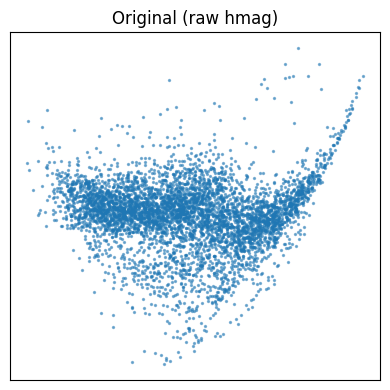

In [368]:
# original hmag_combined
X_ori = hmag_combined.copy()
# X = SimpleImputer(strategy="median").fit_transform(X)

# Randomly select a portion of points (accelaration + visulisation clarity)
idx = np.random.RandomState(0).choice(len(X_ori), size=5000, replace=False)
X_ori_sample = X_ori[idx]

# PCA dimensionality reduction
pca2 = PCA(n_components=2, random_state=42).fit_transform(X_ori_sample)

# Plotting
plt.figure(figsize=(4, 4))
plt.scatter(pca2[:, 0], pca2[:, 1], s=2, alpha=0.5)
plt.title("Original (raw hmag)")
plt.xticks([]); plt.yticks([])
plt.tight_layout()
plt.show()

##### linear scale

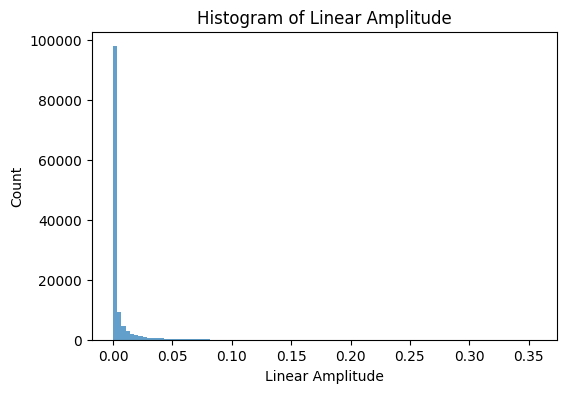

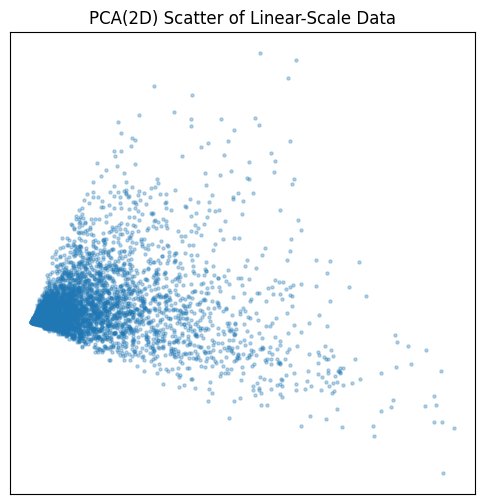

In [395]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Assume `hmag_combined` is your (N, 25) array of dBFS values
X = hmag_combined

# 1) Randomly sample a subset of frames to avoid plotting too many points at once
sample_size = 5000
idx = np.random.RandomState(42).choice(len(X), size=sample_size, replace=False)
X_sample = X[idx]

# 2) Convert from dBFS to linear amplitude
#    linear_amplitude = 10^(dBFS / 20)
X_linear = 10 ** (X_sample / 20.0)

# 3) Plot histogram of linear amplitudes
plt.figure(figsize=(6, 4))
plt.hist(X_linear.flatten(), bins=100, alpha=0.7)
plt.title("Histogram of Linear Amplitude")
plt.xlabel("Linear Amplitude")
plt.ylabel("Count")
plt.show()

# 4) Project linear data to 2D via PCA and scatter-plot
pca2 = PCA(n_components=2, random_state=42).fit_transform(X_linear)
plt.figure(figsize=(6, 6))
plt.scatter(pca2[:, 0], pca2[:, 1], s=5, alpha=0.3)
plt.title("PCA(2D) Scatter of Linear-Scale Data")
plt.xticks([])
plt.yticks([])
plt.show()


#### b. std, min-max, robust, quantile

In [369]:
# Prepare pipelines：  
pipelines = {
    "Std": preprocess_hmag(hmag_filtered, "standard"),
    "MinMax": preprocess_hmag(hmag_filtered, "minmax"),
    "Robust": preprocess_hmag(hmag_filtered, "robust"),
    "Quantile": preprocess_hmag(hmag_filtered, "quantile"),
}

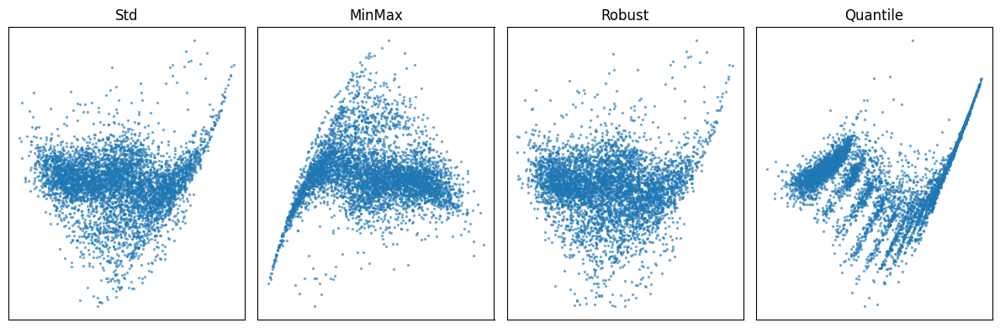

In [370]:
plt.figure(figsize=(12,4))
for i, (name, Xp) in enumerate(pipelines.items(), 1):
    idx = np.random.RandomState(0).choice(len(Xp), size=5000, replace=False)
    pca2 = PCA(n_components=2, random_state=42).fit_transform(Xp[idx])
    plt.subplot(1,4,i)
    plt.scatter(pca2[:,0], pca2[:,1], s=2, alpha=0.5)
    plt.title(name)
    plt.xticks([]); plt.yticks([])
plt.tight_layout()
plt.show()

#### f. 4 scalings + dbFS to linear

In [403]:
pipelines_lin = {
    "Std + lin": preprocess_hmag(hmag_filtered, "standard", lin=True),
    "MinMax + lin": preprocess_hmag(hmag_filtered, "minmax", lin=True),
    "Robust + lin": preprocess_hmag(hmag_filtered, "robust", lin=True),
    "Quantile + lin": preprocess_hmag(hmag_filtered, "quantile", lin=True),
}

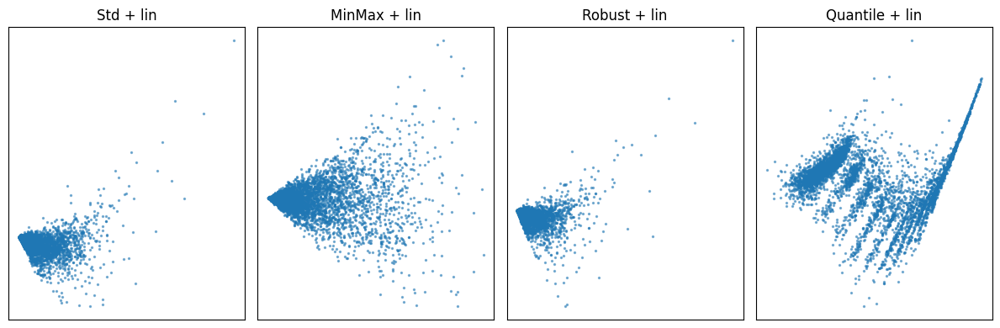

In [404]:
plt.figure(figsize=(12,4))
for i, (name, Xp) in enumerate(pipelines_lin.items(), 1):
    idx = np.random.RandomState(0).choice(len(Xp), size=5000, replace=False)
    pca2 = PCA(n_components=2, random_state=42).fit_transform(Xp[idx])
    plt.subplot(1,4,i)
    plt.scatter(pca2[:,0], pca2[:,1], s=2, alpha=0.5)
    plt.title(name)
    plt.xticks([]); plt.yticks([])
plt.tight_layout()
plt.show()

#### c. 4 scalings + rel

In [371]:
# Prepare 3 pipelines：  
pipelines_rel = {
    "Std + rel": preprocess_hmag(hmag_filtered, "standard", rel=True),
    "MinMax + rel": preprocess_hmag(hmag_filtered, "minmax", rel=True),
    "Robust + rel": preprocess_hmag(hmag_filtered, "robust", rel=True),
    "Quantile + rel": preprocess_hmag(hmag_filtered, "quantile", rel=True),
}

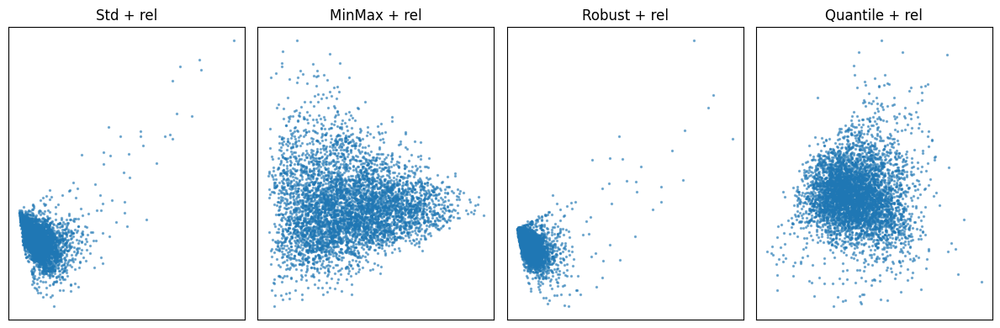

In [372]:
plt.figure(figsize=(12,4))
for i, (name, Xp) in enumerate(pipelines_rel.items(), 1):
    idx = np.random.RandomState(0).choice(len(Xp), size=5000, replace=False)
    pca2 = PCA(n_components=2, random_state=42).fit_transform(Xp[idx])
    plt.subplot(1,4,i)
    plt.scatter(pca2[:,0], pca2[:,1], s=2, alpha=0.5)
    plt.title(name)
    plt.xticks([]); plt.yticks([])
plt.tight_layout()
plt.show()

#### d. 4 scalings + log

In [373]:
# Prepare 3 pipelines： 
pipelines_log = {
    "Std + log ": preprocess_hmag(hmag_filtered, "standard", log=True),
    "MinMax + log": preprocess_hmag(hmag_filtered, "minmax", log=True),
    "Robust + log": preprocess_hmag(hmag_filtered, "robust", log=True),
    "Quantile + log": preprocess_hmag(hmag_filtered, "quantile", log=True),
}

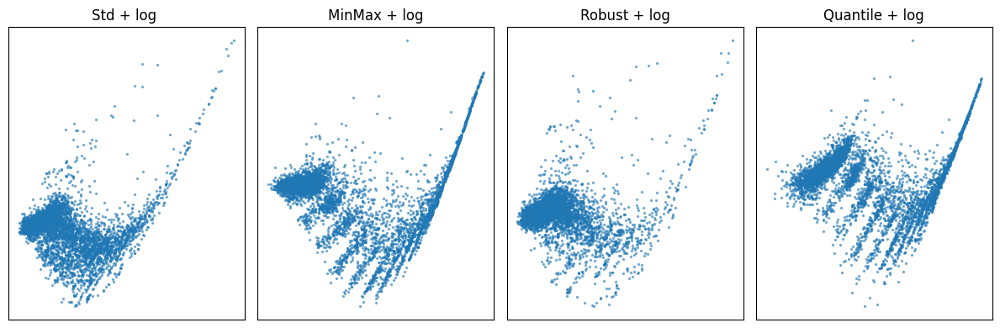

In [374]:
plt.figure(figsize=(12,4))
for i, (name, Xp) in enumerate(pipelines_log.items(), 1):
    idx = np.random.RandomState(0).choice(len(Xp), size=5000, replace=False)
    pca2 = PCA(n_components=2, random_state=42).fit_transform(Xp[idx])
    plt.subplot(1,4,i)
    plt.scatter(pca2[:,0], pca2[:,1], s=2, alpha=0.5)
    plt.title(name)
    plt.xticks([]); plt.yticks([])
plt.tight_layout()
plt.show()

#### e. 4 scalings + log + rel

In [375]:
# Prepare 3 pipelines：  
pipelines_log_rel = {
    "Std + log + rel": preprocess_hmag(hmag_filtered, "standard", log=True, rel=True),
    "MinMax + log + rel": preprocess_hmag(hmag_filtered, "minmax", log=True, rel=True),
    "Robust + log + rel": preprocess_hmag(hmag_filtered, "robust", log=True, rel=True),
    "Quantile + log + rel": preprocess_hmag(hmag_filtered, "quantile", log=True, rel=True),
}

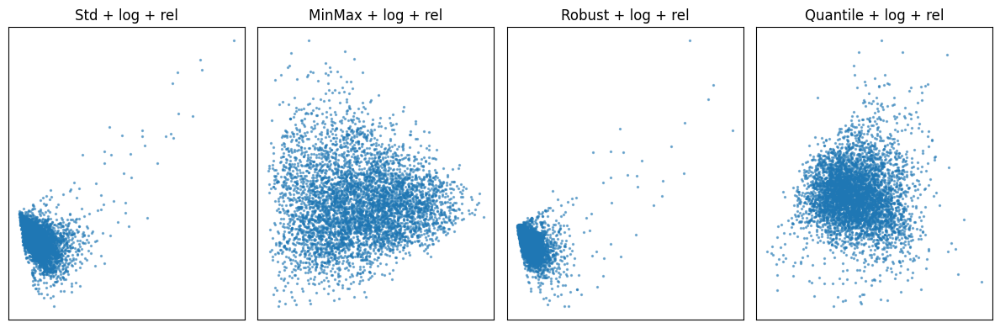

In [376]:
plt.figure(figsize=(12,4))
for i, (name, Xp) in enumerate(pipelines_log_rel.items(), 1):
    idx = np.random.RandomState(0).choice(len(Xp), size=5000, replace=False)
    pca2 = PCA(n_components=2, random_state=42).fit_transform(Xp[idx])
    plt.subplot(1,4,i)
    plt.scatter(pca2[:,0], pca2[:,1], s=2, alpha=0.5)
    plt.title(name)
    plt.xticks([]); plt.yticks([])
plt.tight_layout()
plt.show()

In [ ]:
# Plot original data
plot_histograms_with_kde(hmag_filtered, "original Harmonic Magnitude")

In [ ]:
calculate_skewness(

## 2.3. KMeans Clustering Modelling

### 2.3.1. Preliminary KMeans Test

In [387]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

def plot_scaling_silhouette(
    X_raw: np.ndarray,
    n_clusters: int,
    rel: bool = False,
    log: bool = False,
    pca_variance: float = None,
    sample_size: int = 5000,
    random_state: int = 0
):
    """
    Plots PCA scatter + silhouette for different scalers with different rel + log.
    
    Parameters
    ----------
    X_raw : np.ndarray
        Original hmag_filtered data.
    n_clusters : int
        Number of clusters for KMeans.
    rel : bool 
        Whether to do row normalisation first.
    log : bool 
        whether to do log1p transform first.
    pca_variance : float or None
        Defaults to None (no dimensionality reduction)
        If NOT None, PCA(n_components=pca_variance) is used to downscale to a subspace that 
        preserves the variance of that proportion before doing subsequent clustering.
    sample_size : int
        Number of frames to sample for plotting.
    random_state : int
        Seed for reproducibility.
    """
    scalers = ["standard", "minmax", "robust", "quantile"]
    fig, axes = plt.subplots(1, len(scalers), figsize=(4 * len(scalers), 4))
    
    for ax, scale in zip(axes, scalers):
        # Preprocess with rel=True, log=False
        Xp = preprocess_hmag(X_raw, scale=scale, rel=rel, log=log)

        # Optional: PCA variance preserving dimensionality reduction 
        if pca_variance is not None:
            pca_pre = PCA(n_components=pca_variance, random_state=random_state)
            Xp = pca_pre.fit_transform(Xp)
            print(f"[{scale}] PCA reduced to {Xp.shape[1]} comps (retain {pca_variance*100:.0f}% var)")
        
        # Sample frames
        idx = np.random.RandomState(random_state).choice(len(Xp), size=sample_size, replace=False)
        Xs = Xp[idx]
        
        # KMeans and silhouette
        labels = KMeans(n_clusters=n_clusters, n_init="auto", random_state=random_state).fit_predict(Xs)
        sil = silhouette_score(Xs, labels)
        
        # Plot
        ## PCA to 2D
        pca2 = PCA(n_components=2, random_state=random_state).fit_transform(Xs)
        ax.scatter(pca2[:, 0], pca2[:, 1], c=labels, s=5, alpha=0.3, cmap='tab10')
        rel_str = " + rel" if rel else ""
        log_str = " + log" if log else ""
        ax.set_title(f"{scale.capitalize()} {rel_str} {log_str}, K={n_clusters}\nSilhouette={sil:.3f}")
        ax.set_xticks([])
        ax.set_yticks([])
    
    plt.tight_layout()
    plt.show()

# Use case
# plot_scaling_silhouette(hmag_filtered, n_clusters=10)

#### a. Original hmag - Calculate Silhouette

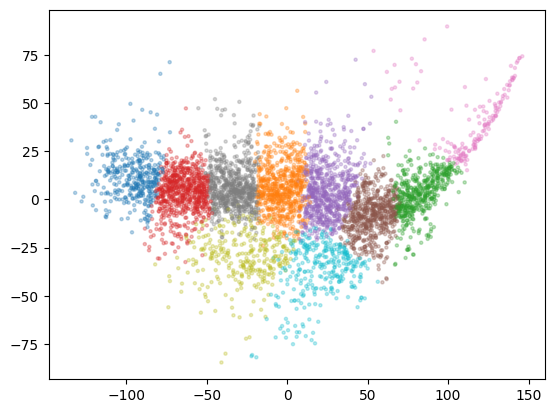

Silhouette: 0.1026328599085138


In [405]:
import numpy as np
from sklearn.cluster import KMeans
# Randomly select 5k points
idx = np.random.choice(len(hmag_combined), size=5000, replace=False)
Xs = hmag_combined[idx]

# PCA2 down to two dimensions
X2 = PCA(n_components=2).fit_transform(Xs)
labels = KMeans(n_clusters=10, random_state=0).fit_predict(Xs)
plt.scatter(X2[:,0], X2[:,1], c=labels, s=5, alpha=0.3, cmap='tab10')
plt.show()

from sklearn.metrics import silhouette_score
sil = silhouette_score(Xs, labels)
print("Silhouette:", sil)

#### b. 4 Scalings

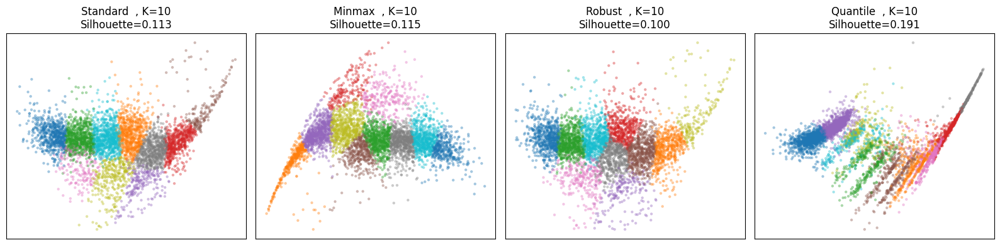

In [379]:
plot_scaling_silhouette(hmag_filtered, 10)

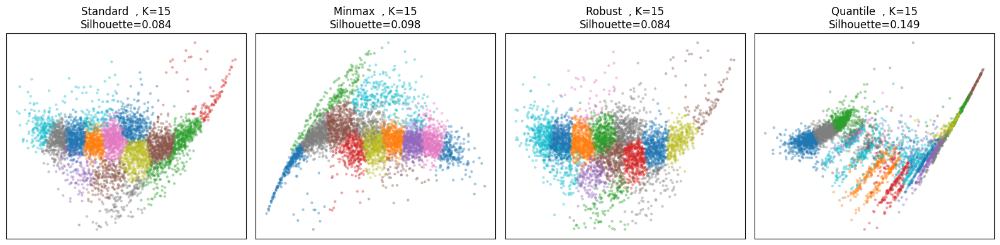

In [409]:
plot_scaling_silhouette(hmag_filtered, 15)

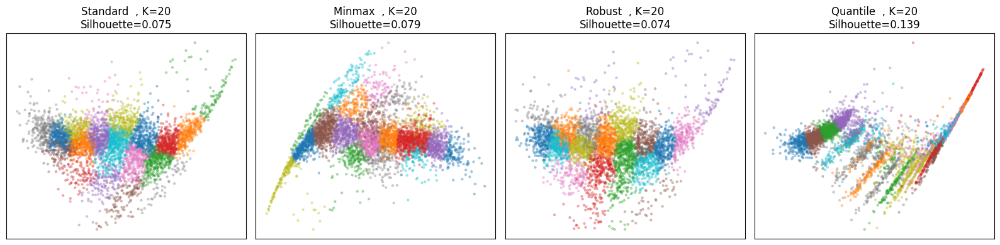

In [410]:
plot_scaling_silhouette(hmag_filtered, 20)

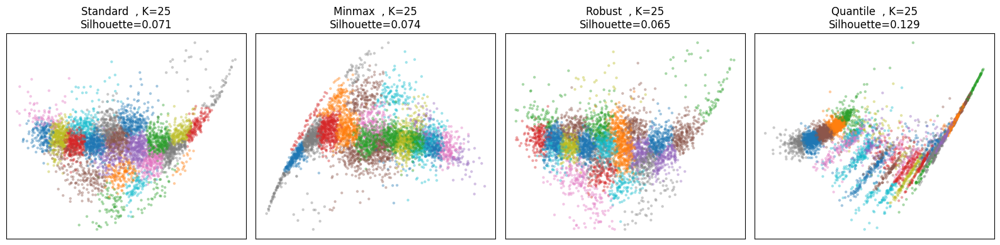

In [411]:
plot_scaling_silhouette(hmag_filtered, 25)

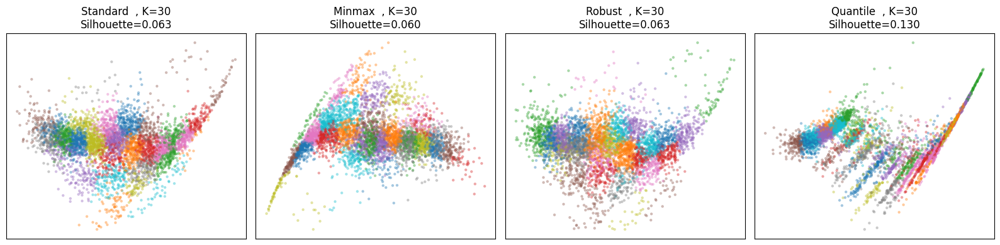

In [412]:
plot_scaling_silhouette(hmag_filtered, 30)

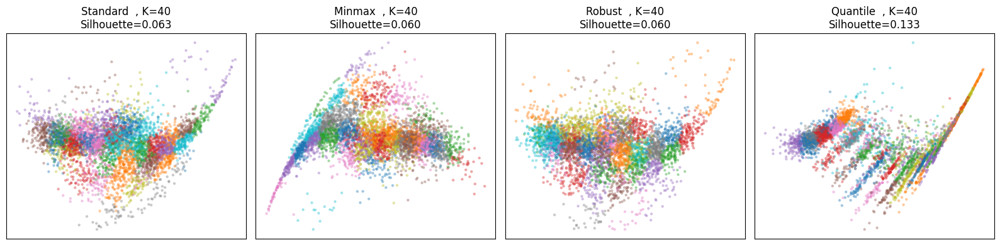

In [420]:
plot_scaling_silhouette(hmag_filtered, 40)

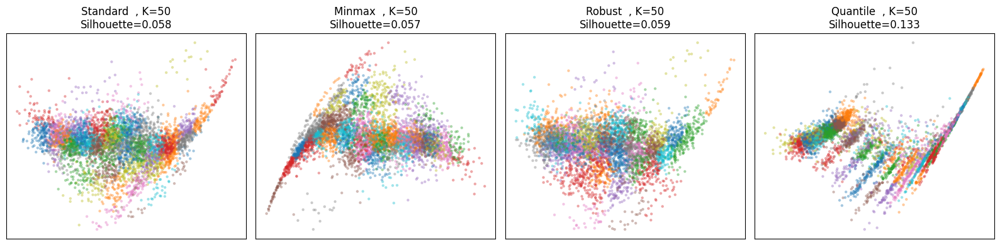

In [421]:
plot_scaling_silhouette(hmag_filtered, 50)

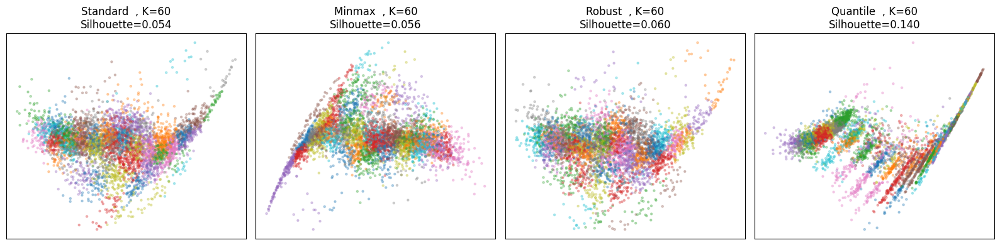

In [422]:
plot_scaling_silhouette(hmag_filtered, 60)

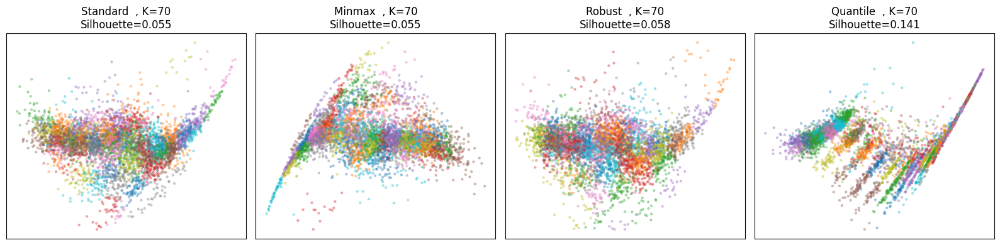

In [423]:
plot_scaling_silhouette(hmag_filtered, 70)

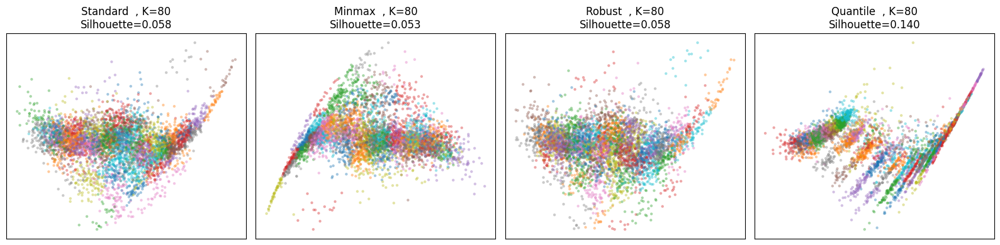

In [424]:
plot_scaling_silhouette(hmag_filtered, 80)

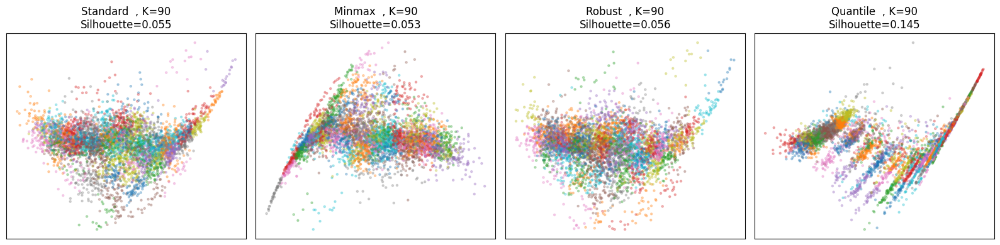

In [426]:
plot_scaling_silhouette(hmag_filtered, 90)

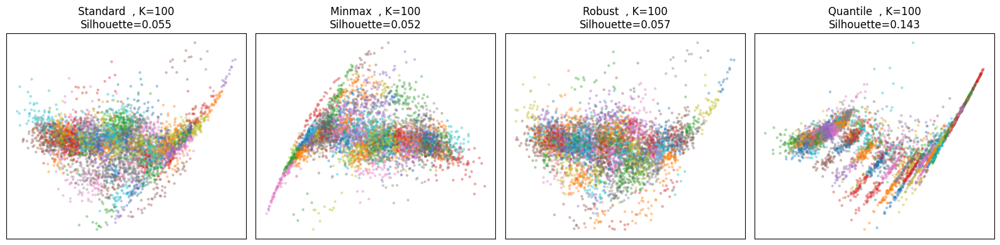

In [427]:
plot_scaling_silhouette(hmag_filtered, 100)

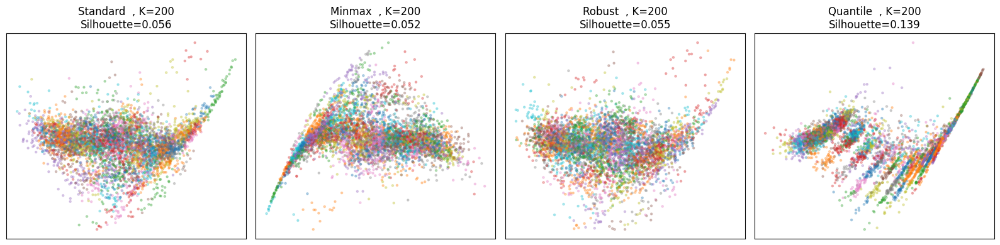

In [432]:
plot_scaling_silhouette(hmag_filtered, 200)

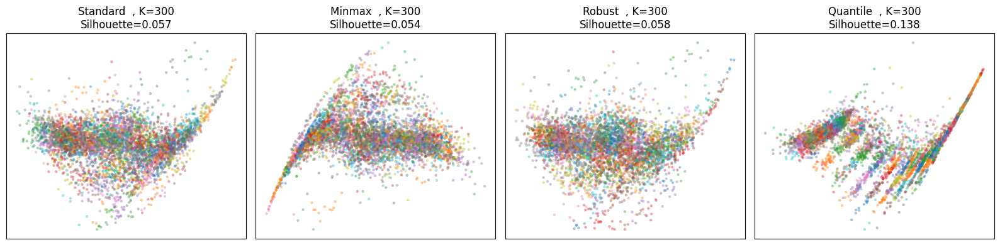

In [433]:
plot_scaling_silhouette(hmag_filtered, 300)

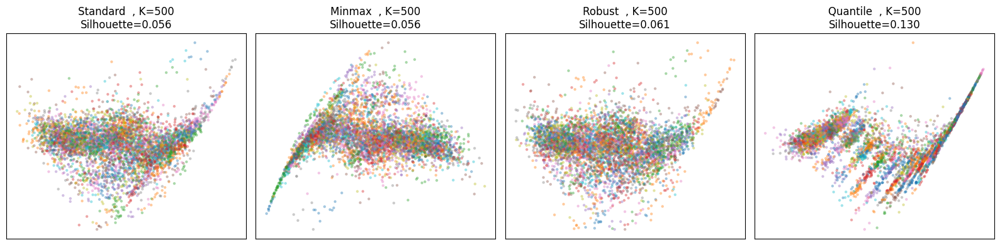

In [437]:
plot_scaling_silhouette(hmag_filtered, 500)

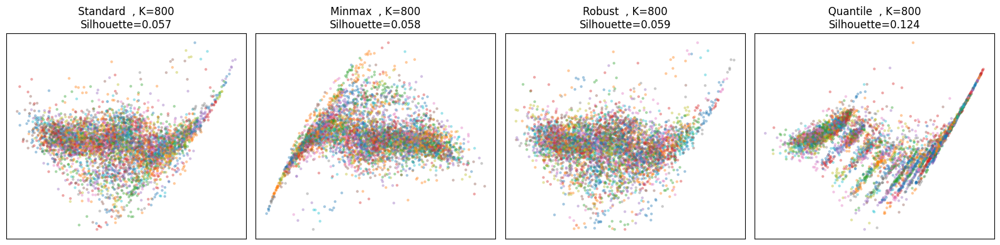

In [438]:
plot_scaling_silhouette(hmag_filtered, 800)

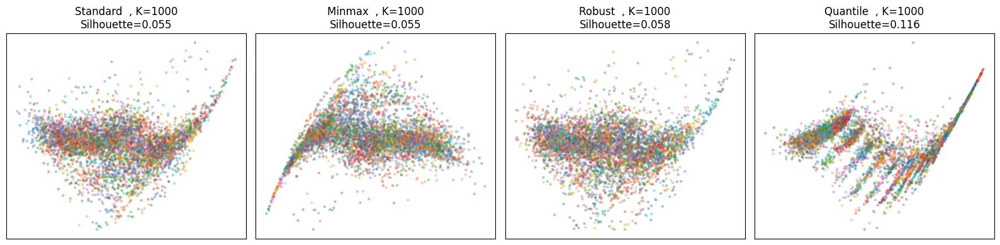

In [439]:
plot_scaling_silhouette(hmag_filtered, 1000)

#### b1. 4 Scalings + PCA 95%
PCA retains 95% variance

[standard] PCA reduced to 18 comps (retain 95% var)
[minmax] PCA reduced to 18 comps (retain 95% var)
[robust] PCA reduced to 17 comps (retain 95% var)
[quantile] PCA reduced to 14 comps (retain 95% var)


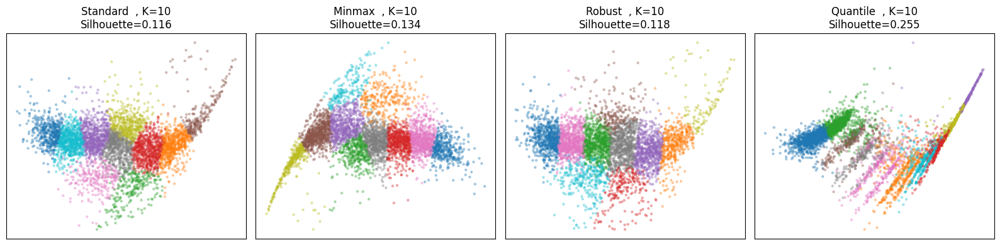

In [390]:
plot_scaling_silhouette(hmag_filtered, n_clusters=10,
                        rel=False, log=False,
                        pca_variance=0.95,
                        sample_size=5000)

#### c. 4 Scalings + rel

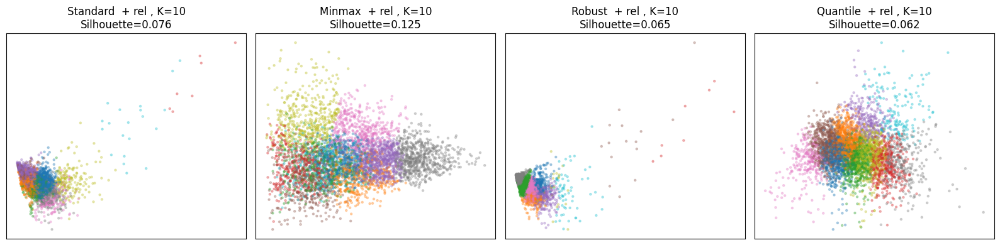

In [380]:
plot_scaling_silhouette(hmag_filtered, 10, rel=True)

#### c1. 4 Scalings + rel + PCA 95%

[standard] PCA reduced to 21 comps (retain 95% var)
[minmax] PCA reduced to 11 comps (retain 95% var)
[robust] PCA reduced to 21 comps (retain 95% var)
[quantile] PCA reduced to 20 comps (retain 95% var)


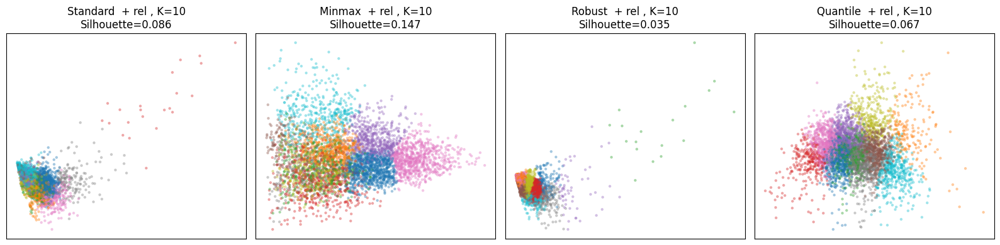

In [391]:
plot_scaling_silhouette(hmag_filtered, n_clusters=10,
                        rel=True, log=False,
                        pca_variance=0.95,
                        sample_size=5000)

#### d. 4 Scalings + log

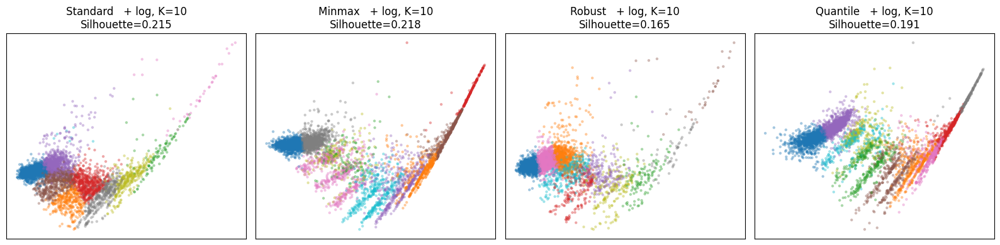

In [381]:
plot_scaling_silhouette(hmag_filtered, 10, log=True)

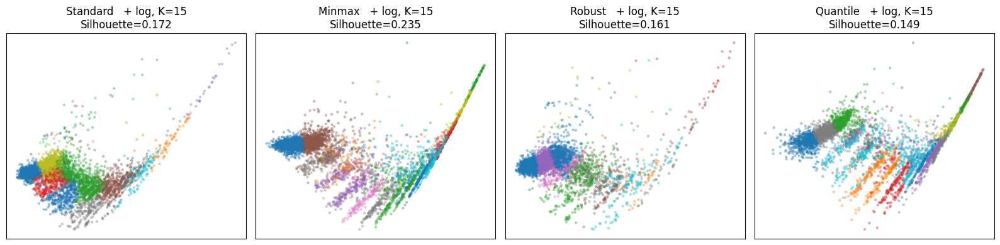

In [429]:
plot_scaling_silhouette(hmag_filtered, 15, log=True)

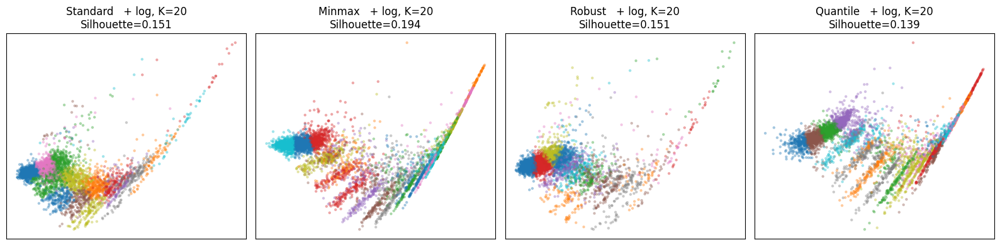

In [406]:
plot_scaling_silhouette(hmag_filtered, 20, log=True)

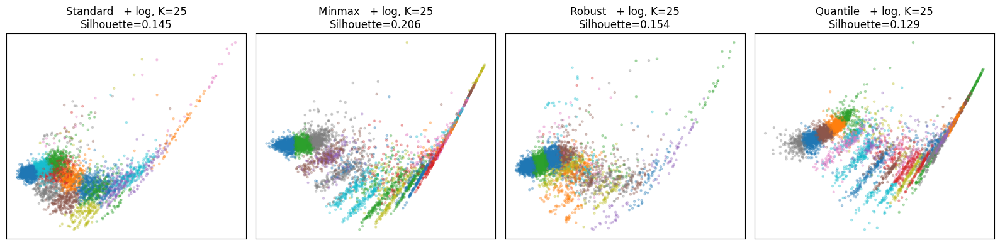

In [430]:
plot_scaling_silhouette(hmag_filtered, 25, log=True)

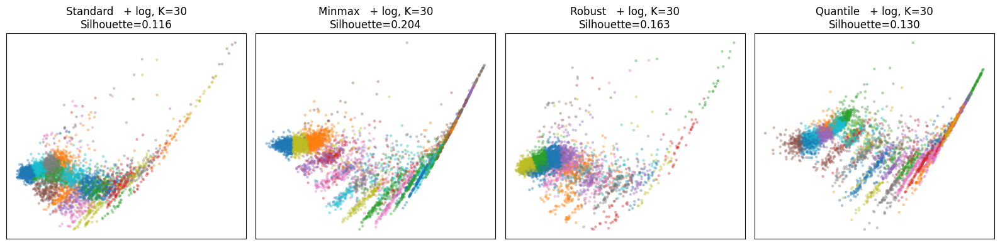

In [408]:
plot_scaling_silhouette(hmag_filtered, 30, log=True)

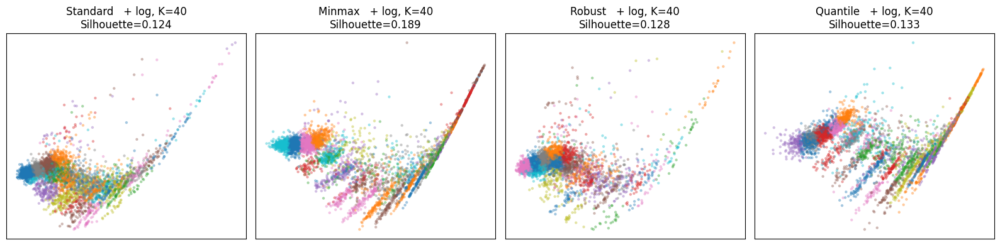

In [414]:
plot_scaling_silhouette(hmag_filtered, 40, log=True)

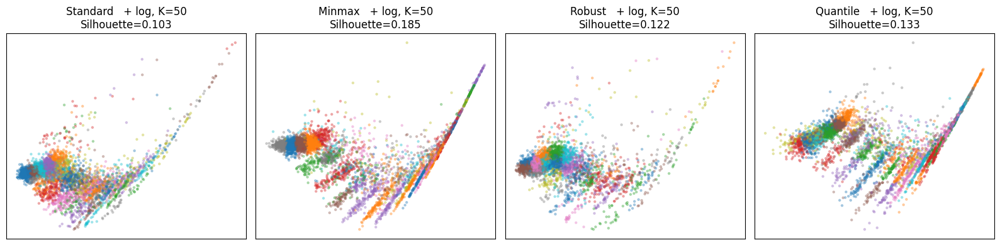

In [416]:
plot_scaling_silhouette(hmag_filtered, 50, log=True)

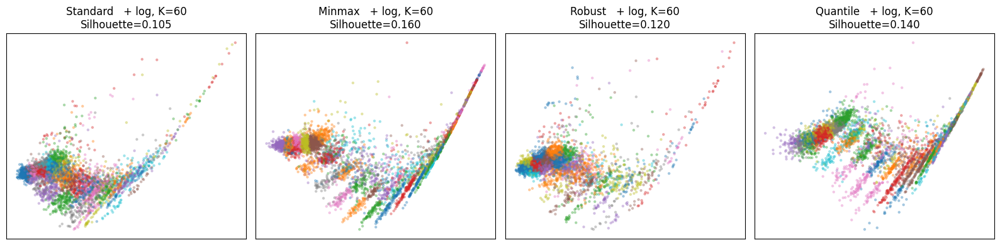

In [417]:
plot_scaling_silhouette(hmag_filtered, 60, log=True)

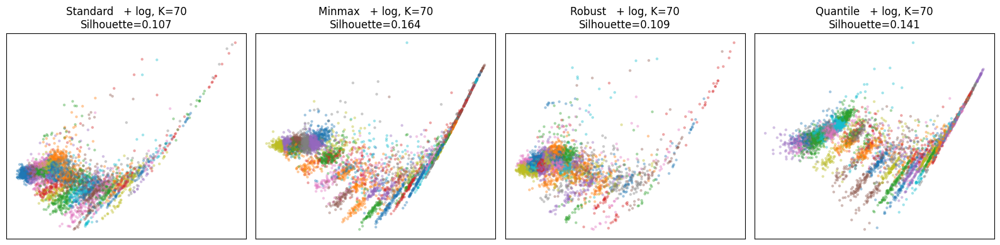

In [418]:
plot_scaling_silhouette(hmag_filtered, 70, log=True)

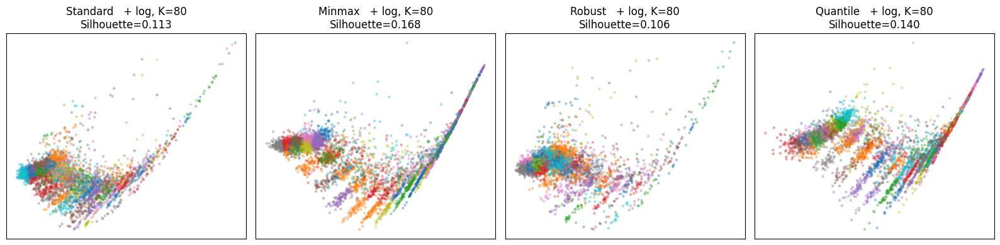

In [419]:
plot_scaling_silhouette(hmag_filtered, 80, log=True)

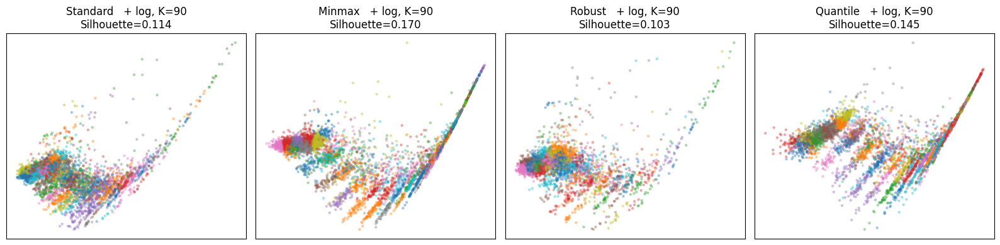

In [425]:
plot_scaling_silhouette(hmag_filtered, 90, log=True)

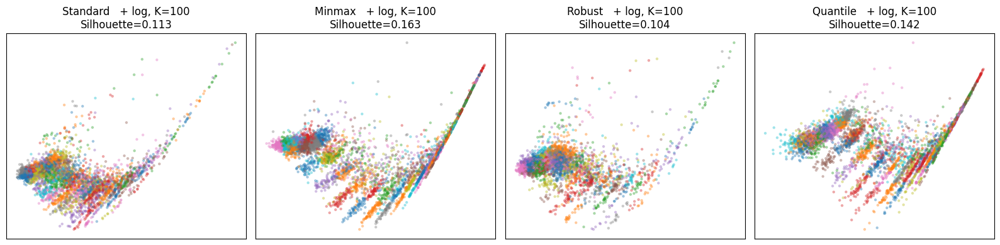

In [428]:
plot_scaling_silhouette(hmag_filtered, 100, log=True)

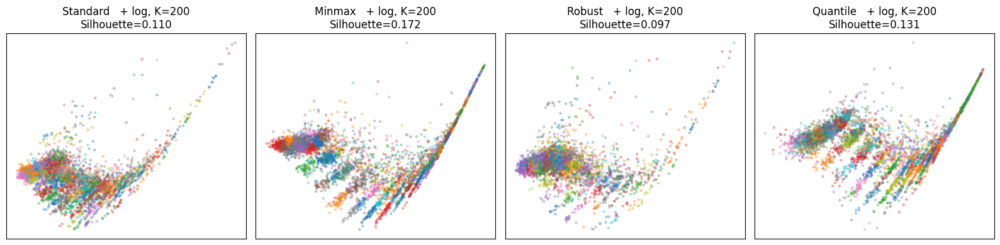

In [431]:
plot_scaling_silhouette(hmag_filtered, 200, log=True)

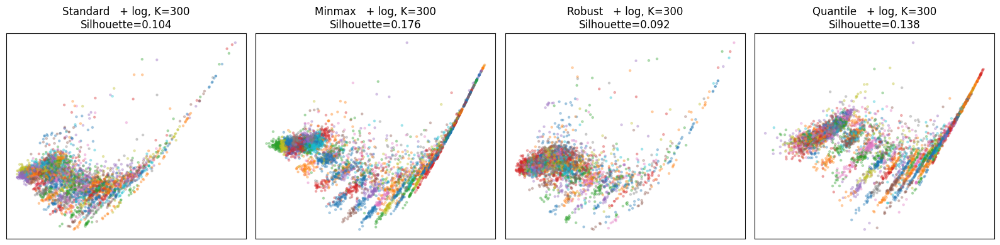

In [434]:
plot_scaling_silhouette(hmag_filtered, 300, log=True)

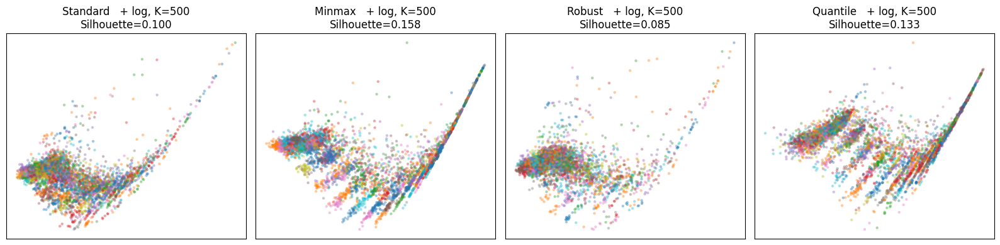

In [435]:
plot_scaling_silhouette(hmag_filtered, 500, log=True)

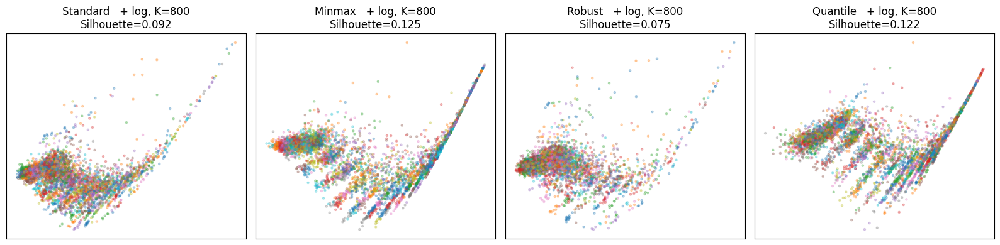

In [436]:
plot_scaling_silhouette(hmag_filtered, 800, log=True)

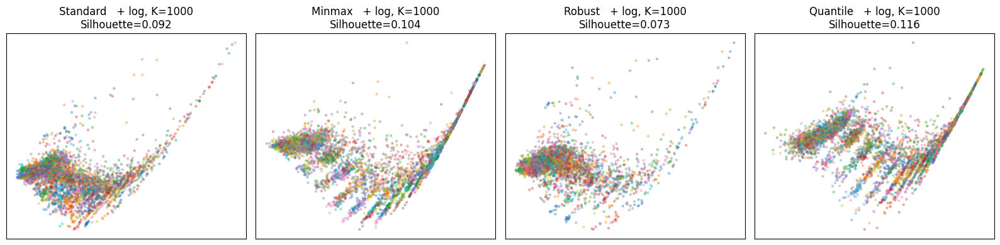

In [440]:
plot_scaling_silhouette(hmag_filtered, 1000, log=True)

#### d1. 4 Scalings + log + PCA 95%

[standard] PCA reduced to 19 comps (retain 95% var)
[minmax] PCA reduced to 13 comps (retain 95% var)
[robust] PCA reduced to 16 comps (retain 95% var)
[quantile] PCA reduced to 14 comps (retain 95% var)


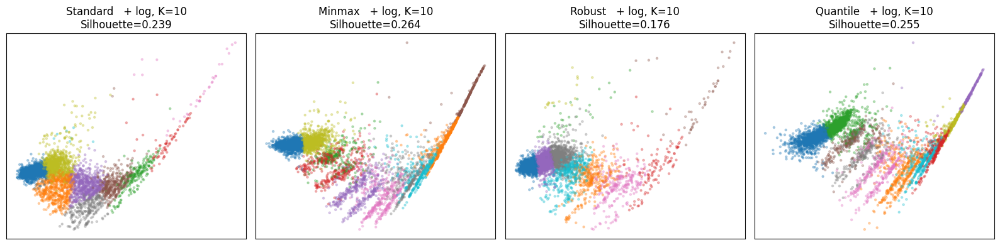

In [392]:
plot_scaling_silhouette(hmag_filtered, n_clusters=10,
                        rel=False, log=True,
                        pca_variance=0.95,
                        sample_size=5000)

#### e. 4 Scalings + rel + log

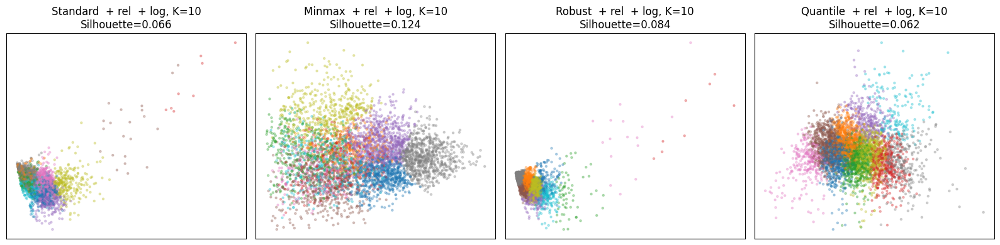

In [382]:
plot_scaling_silhouette(hmag_filtered, 10, rel=True, log=True)

#### e1. 4 Scalings + rel + log + PCA 95%

[standard] PCA reduced to 21 comps (retain 95% var)
[minmax] PCA reduced to 10 comps (retain 95% var)
[robust] PCA reduced to 21 comps (retain 95% var)
[quantile] PCA reduced to 20 comps (retain 95% var)


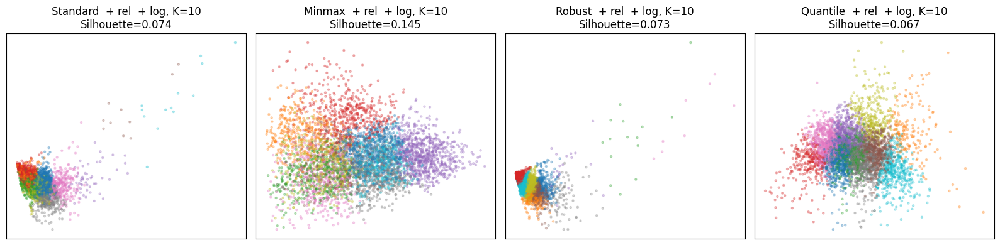

In [393]:
plot_scaling_silhouette(hmag_filtered, n_clusters=10,
                        rel=True, log=True,
                        pca_variance=0.95,
                        sample_size=5000)

#### Calculate skewness on chosen preprocesed hmag

In [445]:
hmag_minmax_log = preprocess_hmag(hmag_filtered, scale="minmax", log=True, rel=False)

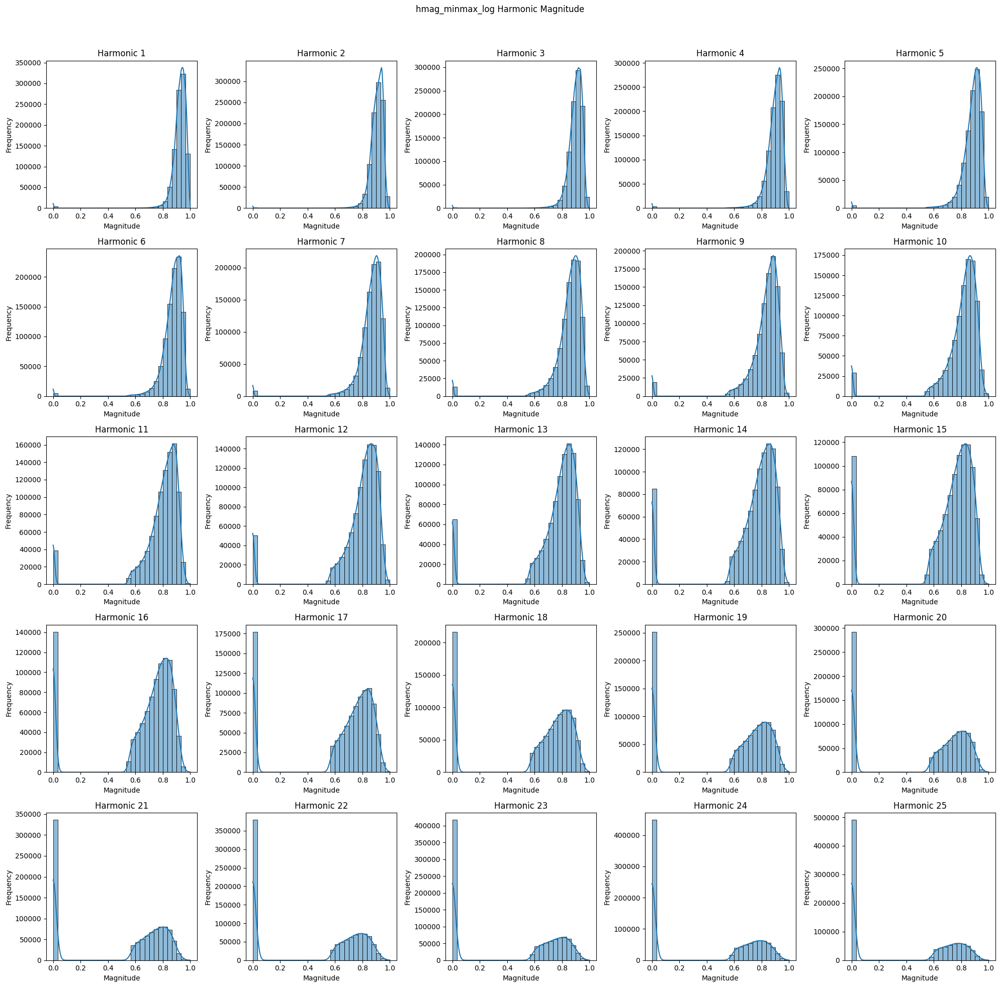

In [453]:
plot_histograms_with_kde(hmag_minmax_log, "hmag_minmax_log Harmonic Magnitude")

In [451]:
calculate_skewness(hmag_minmax_log, "hmag_minmax_log Harmonic Magnitude")

Harmonic 1 Skewness: -8.6257
Harmonic 2 Skewness: -6.4814
Harmonic 3 Skewness: -6.2528
Harmonic 4 Skewness: -6.2851
Harmonic 5 Skewness: -5.4189
Harmonic 6 Skewness: -5.2645
Harmonic 7 Skewness: -4.9226
Harmonic 8 Skewness: -4.5200
Harmonic 9 Skewness: -4.0281
Harmonic 10 Skewness: -3.5411
Harmonic 11 Skewness: -3.1946
Harmonic 12 Skewness: -2.9015
Harmonic 13 Skewness: -2.5969
Harmonic 14 Skewness: -2.2594
Harmonic 15 Skewness: -1.9655
Harmonic 16 Skewness: -1.6511
Harmonic 17 Skewness: -1.3630
Harmonic 18 Skewness: -1.1090
Harmonic 19 Skewness: -0.9129
Harmonic 20 Skewness: -0.7124
Harmonic 21 Skewness: -0.5119
Harmonic 22 Skewness: -0.3275
Harmonic 23 Skewness: -0.1773
Harmonic 24 Skewness: -0.0474
Harmonic 25 Skewness: 0.1150
Average Skewness for hmag_minmax_log Harmonic Magnitude: -2.9982


In [449]:
hmag_quantile = preprocess_hmag(hmag_filtered, scale="quantile")

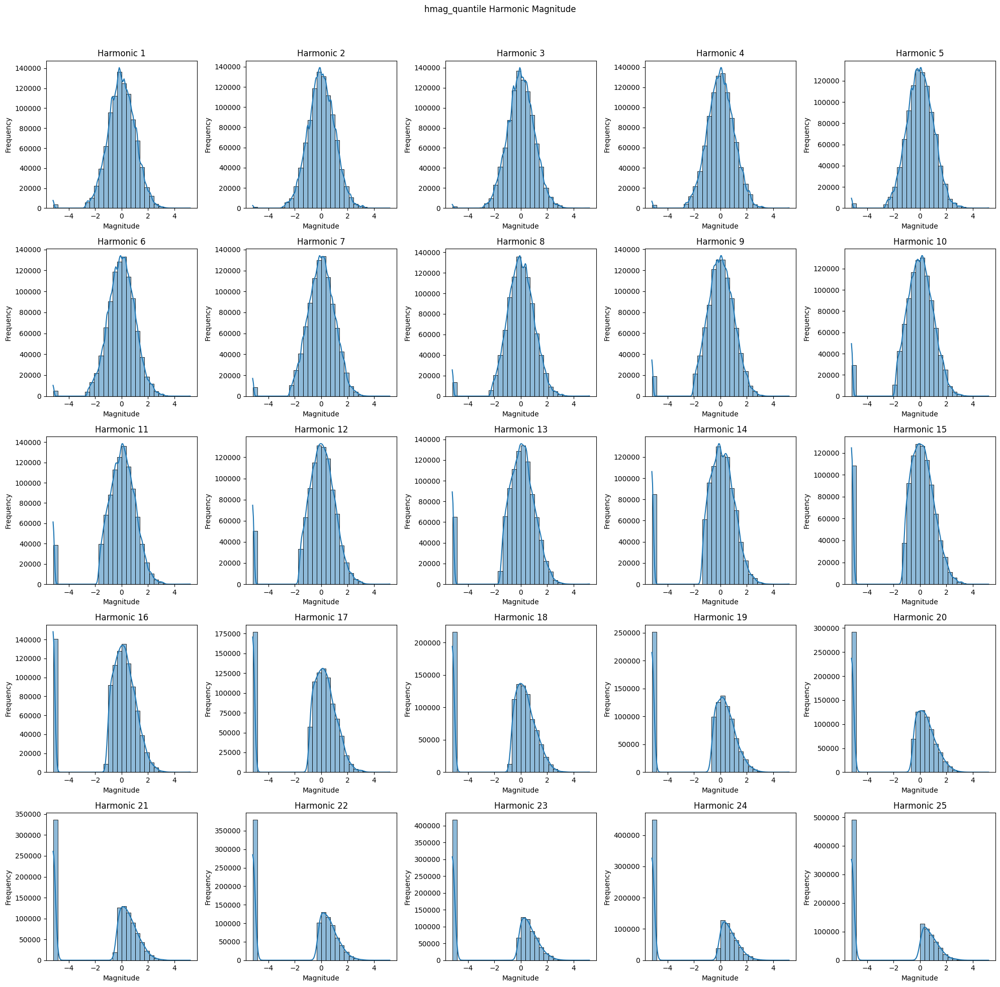

In [454]:
plot_histograms_with_kde(hmag_quantile, "hmag_quantile Harmonic Magnitude")

In [455]:
calculate_skewness(hmag_quantile, "hmag_quantile Harmonic Magnitude")

Harmonic 1 Skewness: -0.3871
Harmonic 2 Skewness: -0.1130
Harmonic 3 Skewness: -0.1596
Harmonic 4 Skewness: -0.3277
Harmonic 5 Skewness: -0.4355
Harmonic 6 Skewness: -0.4893
Harmonic 7 Skewness: -0.7893
Harmonic 8 Skewness: -1.0540
Harmonic 9 Skewness: -1.3437
Harmonic 10 Skewness: -1.5901
Harmonic 11 Skewness: -1.7667
Harmonic 12 Skewness: -1.8013
Harmonic 13 Skewness: -1.8211
Harmonic 14 Skewness: -1.7376
Harmonic 15 Skewness: -1.6103
Harmonic 16 Skewness: -1.4528
Harmonic 17 Skewness: -1.2441
Harmonic 18 Skewness: -1.0445
Harmonic 19 Skewness: -0.8777
Harmonic 20 Skewness: -0.6889
Harmonic 21 Skewness: -0.5068
Harmonic 22 Skewness: -0.3341
Harmonic 23 Skewness: -0.1875
Harmonic 24 Skewness: -0.0626
Harmonic 25 Skewness: 0.0998
Average Skewness for hmag_quantile Harmonic Magnitude: -0.8690


### 2.3.2. Select the Best K

In [492]:
import numpy as np
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
import matplotlib.pyplot as plt
from tqdm import tqdm
import os
import joblib

def select_best_k(X, sample_size=50000, k_range=range(2, 80, 2), random_state=42):
    """
    Select best K for KMeans using elbow method, silhouette score, and Davies-Bouldin index with progress bar.
    
    Parameters
    ----------
    X : np.ndarray
        Preprocessed data.
    sample_size : int
        Number of samples to use.
    k_range : range
        Range of K values to test.
    random_state : int
        Seed for reproducibility.
    save_models : bool
        Whether to save KMeans models for best_k_sil and best_k_db.
    save_dir : str
        Directory to save models if save_models is True.
    
    Returns
    -------
    best_k_sil : int
        Optimal number of clusters based on silhouette score.
    best_k_db : int
        Optimal number of clusters based on Davies-Bouldin index.
    best_sil_model : KMeans or None
        Saved KMeans model for best_k_sil if save_models is True, else None.
    best_db_model : KMeans or None
        Saved KMeans model for best_k_db if save_models is True, else None.
    wcss : list of tuples
        List of (k, wcss) pairs for each K value.
    sil_scores : list of tuples
        List of (k, silhouette_score) pairs for each K value.
    db_scores : list of tuples
        List of (k, davies_bouldin_score) pairs for each K value.
    """
    
    # Sample data
    idx = np.random.RandomState(random_state).choice(len(X), size=sample_size, replace=False)
    X_sample = X[idx]
    
    # Initialize models to save
    best_sil_model = None
    best_db_model = None
    
    # Compute metrics with progress bar
    wcss = []
    sil_scores = []
    db_scores = []
    for k in tqdm(k_range, desc="Evaluating K values"):
        kmeans = KMeans(n_clusters=k, n_init="auto", random_state=random_state)
        labels = kmeans.fit_predict(X_sample)
        wcss.append((k, kmeans.inertia_))
        if k > 1:
            sil_scores.append((k, silhouette_score(X_sample, labels)))
            db_scores.append((k, davies_bouldin_score(X_sample, labels)))
        else:
            sil_scores.append((k, 0))
            db_scores.append((k, 0))
    
    # Plot metrics
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 3, 1)
    plt.plot([w[0] for w in wcss], [w[1] for w in wcss], marker='o', color='#1f77b4')
    plt.title('Elbow Method')
    plt.xlabel('Number of Clusters (K)')
    plt.ylabel('WCSS')
    
    plt.subplot(1, 3, 2)
    plt.plot([s[0] for s in sil_scores], [s[1] for s in sil_scores], marker='o', color='#ff7f0e')
    plt.title('Silhouette Score')
    plt.xlabel('Number of Clusters (K)')
    plt.ylabel('Silhouette Score')
    
    plt.subplot(1, 3, 3)
    plt.plot([d[0] for d in db_scores], [d[1] for d in db_scores], marker='o', color='#2ca02c')
    plt.title('Davies-Bouldin Index')
    plt.xlabel('Number of Clusters (K)')
    plt.ylabel('DB Index')
    plt.tight_layout()
    plt.show()
    
    # Select best K
    # best_k_sil = k_range[np.argmax([s[1] for s in sil_scores])] if max([s[1] for s in sil_scores]) > 0 else 2
    # best_k_db = k_range[np.argmin([d[1] for d in db_scores])] if min([d[1] for d in db_scores]) > 0 else 2
    # print(f"Best K (Silhouette): {best_k_sil}, Best K (Davies-Bouldin): {best_k_db}")
    
    return wcss, sil_scores, db_scores

# Example usage
# import os
# X_preprocessed = preprocess_hmag(hmag_combined, scale="minmax", log=True, rel=False)
# best_k_sil, best_k_db, best_sil_model, best_db_model, wcss, sil_scores, db_scores = select_best_k(X_preprocessed, save_models=True)

#### a. MinMax + log, Best K=23

In [470]:
X_minmax_log = preprocess_hmag(hmag_filtered, scale="minmax", log=True, rel=False)

Evaluating K values: 100%|██████████████████████| 39/39 [16:07<00:00, 24.82s/it]


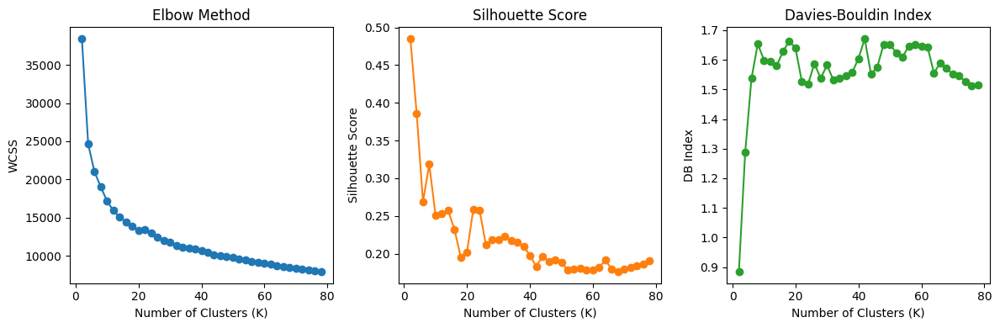

In [495]:
wcss_minmax_log, sil_scores_minmax_log, db_scores_minmax_log = select_best_k(X_minmax_log)

In [502]:
wcss_minmax_log, sil_scores_minmax_log, db_scores_minmax_log

([(2, 38425.26686493442),
  (4, 24611.149400314105),
  (6, 20993.573300201733),
  (8, 19028.930413045266),
  (10, 17141.602161460756),
  (12, 15926.193665297587),
  (14, 15018.023680988028),
  (16, 14446.358352106186),
  (18, 13902.77488586706),
  (20, 13289.995848631548),
  (22, 13428.023988578607),
  (24, 12955.677332564414),
  (26, 12405.074938178459),
  (28, 11966.224970744635),
  (30, 11744.385228006879),
  (32, 11372.403617551116),
  (34, 11111.89453904708),
  (36, 11028.216763207467),
  (38, 10834.590942945022),
  (40, 10650.693115071137),
  (42, 10479.958442091403),
  (44, 10124.077206515345),
  (46, 9978.863235299083),
  (48, 9860.28887856336),
  (50, 9728.636921313435),
  (52, 9568.941820858407),
  (54, 9452.43248806029),
  (56, 9265.726732760926),
  (58, 9124.686850182758),
  (60, 9051.620902094639),
  (62, 8876.541915919039),
  (64, 8709.23732648199),
  (66, 8595.71878490449),
  (68, 8473.52242476723),
  (70, 8361.675377768564),
  (72, 8271.456735668597),
  (74, 8136.503682

Evaluating K values: 100%|██████████████████████| 16/16 [06:28<00:00, 24.27s/it]


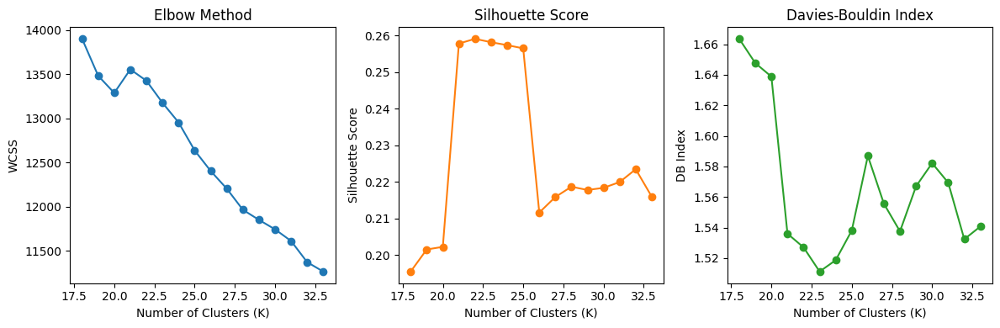

In [505]:
wcss_minmax_log_step18_34, sil_scores_minmax_log_step18_34, db_scores_minmax_log_step18_34 = 
select_best_k(X_minmax_log, k_range=range(18, 34))

In [504]:
wcss_minmax_log_step18_34, sil_scores_minmax_log_step18_34, db_scores_minmax_log_step18_34

([(18, 13902.77488586706),
  (19, 13484.352932631573),
  (20, 13289.995848631548),
  (21, 13556.39061771013),
  (22, 13428.023988578607),
  (23, 13178.358480272396),
  (24, 12955.677332564414),
  (25, 12638.735339550512),
  (26, 12405.07493817846),
  (27, 12205.105248673124),
  (28, 11966.224970744635),
  (29, 11851.672932742527),
  (30, 11744.385228006879),
  (31, 11612.323149736007),
  (32, 11372.403617551116),
  (33, 11265.911357784185)],
 [(18, 0.1954939728682036),
  (19, 0.2015357371992096),
  (20, 0.20224677333044783),
  (21, 0.25780980151621724),
  (22, 0.2591005469968604),
  (23, 0.2581792787625177),
  (24, 0.25737646821359006),
  (25, 0.25649855959687784),
  (26, 0.21161944541078984),
  (27, 0.2158681105109976),
  (28, 0.21868200547198818),
  (29, 0.21778760391973348),
  (30, 0.21837460452933075),
  (31, 0.21995503986372797),
  (32, 0.22345878942043096),
  (33, 0.21593390952548558)],
 [(18, 1.6635451455629182),
  (19, 1.6476512739103588),
  (20, 1.6388235832187312),
  (21, 1.5

In [471]:
 # (2, 80, 5)

Evaluating K values: 100%|██████████████████████| 16/16 [07:02<00:00, 26.38s/it]


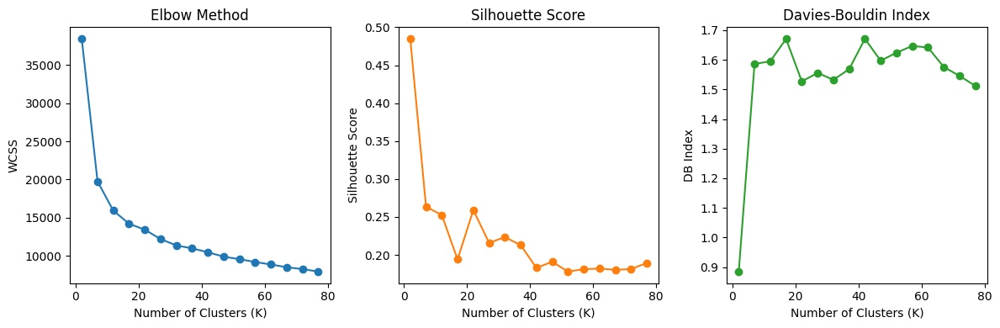

In [493]:
wcss_minmax_log_step5, sil_scores_minmax_log_step5, db_scores_minmax_log_step5 = select_best_k(X_minmax_log, k_range=range(2, 80, 5))

In [501]:
wcss_minmax_log_step5, sil_scores_minmax_log_step5

([(2, 38425.26686493442),
  (7, 19766.58540623256),
  (12, 15926.193665297587),
  (17, 14215.912373852014),
  (22, 13428.023988578607),
  (27, 12205.105248673124),
  (32, 11372.403617551116),
  (37, 10985.003929986058),
  (42, 10479.958442091403),
  (47, 9897.5644670995),
  (52, 9568.941820858407),
  (57, 9199.741355012651),
  (62, 8876.541915919039),
  (67, 8516.870791412508),
  (72, 8271.456735668595),
  (77, 7951.186170481331)],
 [(2, 0.48479754563982214),
  (7, 0.2633847539463802),
  (12, 0.25266289641871054),
  (17, 0.1940456589808379),
  (22, 0.2591005469968604),
  (27, 0.2158681105109976),
  (32, 0.22345878942043096),
  (37, 0.21299700560422916),
  (42, 0.1829435912074531),
  (47, 0.19094365084652784),
  (52, 0.17807046789752523),
  (57, 0.18119421934347096),
  (62, 0.1820012888092478),
  (67, 0.18035452458891973),
  (72, 0.18137454567312536),
  (77, 0.18937502696614775)])

#### b. Quantile, Best K=22

In [477]:
X_quantile = preprocess_hmag(hmag_filtered, scale="quantile")

Evaluating K values: 100%|██████████████████████| 39/39 [16:08<00:00, 24.82s/it]


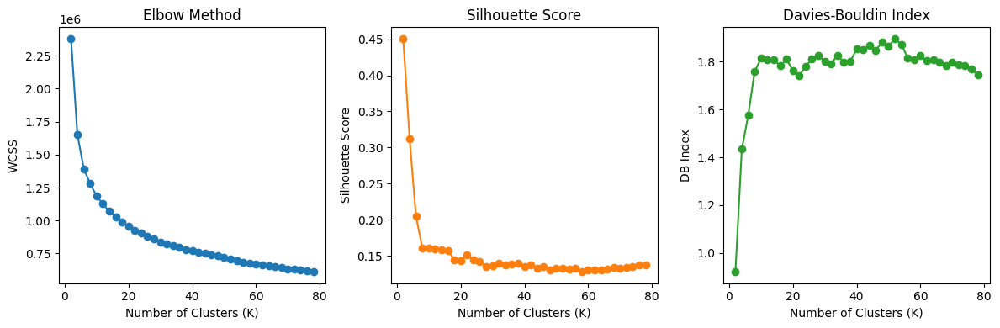

In [496]:
wcss_quantile, sil_scores_quantile, db_scores_quantile =select_best_k(X_quantile)

In [506]:
wcss_quantile, sil_scores_quantile, db_scores_quantile

([(2, 2377418.121481919),
  (4, 1652416.459232348),
  (6, 1391824.7936851433),
  (8, 1281277.4169139103),
  (10, 1184866.89821987),
  (12, 1126715.6115483404),
  (14, 1068566.9065763366),
  (16, 1025316.173664297),
  (18, 989404.761042411),
  (20, 956882.9053413784),
  (22, 924242.8159682075),
  (24, 904235.5107988087),
  (26, 880575.3344324892),
  (28, 859154.5978655668),
  (30, 838045.5813030619),
  (32, 820262.0545954639),
  (34, 810658.4490453211),
  (36, 794945.1192310506),
  (38, 780015.2213225256),
  (40, 772435.1359859625),
  (42, 758871.1537251186),
  (44, 751568.8615603237),
  (46, 739314.6870763185),
  (48, 730862.5821828747),
  (50, 719608.6138300844),
  (52, 710118.630922796),
  (54, 697198.3798269564),
  (56, 684522.6183713204),
  (58, 677006.2864982887),
  (60, 670942.558523771),
  (62, 662553.8542138226),
  (64, 658466.1681152845),
  (66, 650692.6867207014),
  (68, 643170.7241258832),
  (70, 634169.8662820037),
  (72, 631428.2662654554),
  (74, 625392.9059559997),
  (76

Evaluating K values: 100%|██████████████████████| 16/16 [07:01<00:00, 26.34s/it]


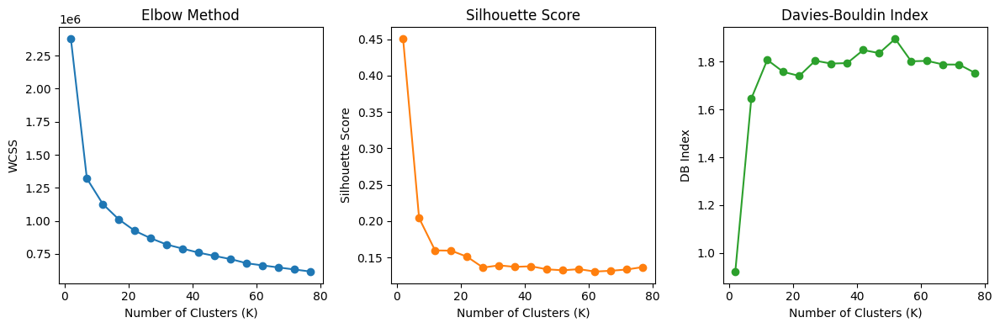

In [494]:
wcss_quantile_step5, sil_scores_quantile_step5, db_scores_quantile_step5 =select_best_k(X_quantile, k_range=range(2, 80, 5))

In [498]:
wcss_quantile_step5, sil_scores_quantile_step5

([(2, 2377418.1214819187),
  (7, 1320168.4551546013),
  (12, 1126715.6115483402),
  (17, 1010630.1022347128),
  (22, 924242.8159682075),
  (27, 867775.3250356824),
  (32, 820262.0545954639),
  (37, 789194.139374698),
  (42, 758871.1537251186),
  (47, 734099.0603551194),
  (52, 710118.630922796),
  (57, 678838.9269501409),
  (62, 662553.8542138226),
  (67, 646951.5438946162),
  (72, 631428.2662654554),
  (77, 616049.960642986)],
 [(2, 0.45062942812674434),
  (7, 0.20410022668629157),
  (12, 0.1595510255794731),
  (17, 0.15927533242550695),
  (22, 0.15088429556239952),
  (27, 0.13598499342197443),
  (32, 0.1390202053638755),
  (37, 0.13690130392229352),
  (42, 0.13776775968253782),
  (47, 0.1335454073924884),
  (52, 0.13222582252750129),
  (57, 0.13381143289237704),
  (62, 0.13047902562551542),
  (67, 0.13157880669223704),
  (72, 0.13333802646418239),
  (77, 0.13667813317164978)])

Evaluating K values: 100%|██████████████████████| 16/16 [06:01<00:00, 22.59s/it]


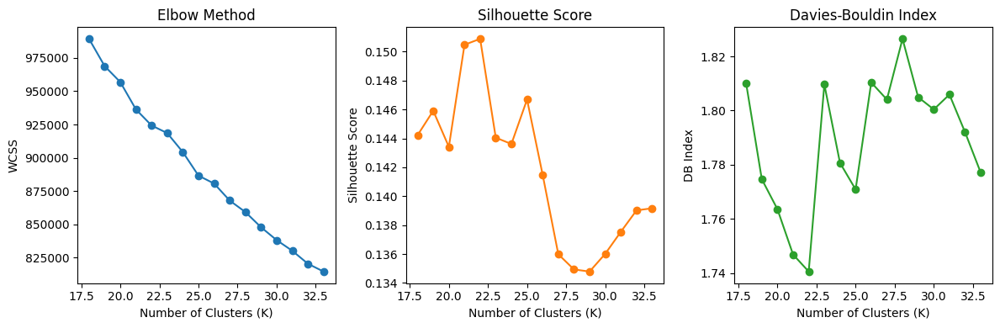

In [508]:
wcss_quantile_step18_34, sil_quantile_step18_34, db_quantile_step18_34 = select_best_k(X_quantile, k_range=range(18, 34))

In [509]:
wcss_quantile_step18_34, sil_quantile_step18_34, db_quantile_step18_34

([(18, 989404.7610424109),
  (19, 968883.1362851654),
  (20, 956882.9053413784),
  (21, 936352.0695253542),
  (22, 924242.8159682075),
  (23, 918549.9468683307),
  (24, 904235.5107988087),
  (25, 886556.4777858788),
  (26, 880575.3344324892),
  (27, 867775.3250356824),
  (28, 859154.5978655668),
  (29, 847740.8152431042),
  (30, 838045.5813030619),
  (31, 830028.8063727687),
  (32, 820262.0545954639),
  (33, 814406.7205086777)],
 [(18, 0.14422193470394457),
  (19, 0.1459091731049065),
  (20, 0.14341577125910554),
  (21, 0.15047392500304915),
  (22, 0.15088429556239952),
  (23, 0.14404837919960148),
  (24, 0.1436130737250533),
  (25, 0.1466845914306612),
  (26, 0.14147536601778557),
  (27, 0.13598499342197443),
  (28, 0.13493697124343482),
  (29, 0.13479014811451615),
  (30, 0.13601678262682107),
  (31, 0.13754186122331788),
  (32, 0.1390202053638755),
  (33, 0.13916829978851333)],
 [(18, 1.8100151494635617),
  (19, 1.7746572698509182),
  (20, 1.7635690110551625),
  (21, 1.7468326770204

### 2.3.3. Fit All Data
Fit hmag_combined_all (925 songs)

In [528]:
import os

basic_dir = '/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP'
npz_dir = 'ViolinEtudes-zenodo-downsample_2025/train/anal/crepe'

# Join and get absolute path
combined_path = os.path.join(basic_dir, npz_dir)
absolute_path = os.path.abspath(combined_path)

print(combined_path)
print(absolute_path)
if os.path.exists(absolute_path):
    print("Path exists ✅")
else:
    print("Path does NOT exist ❌")

/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP/ViolinEtudes-zenodo-downsample_2025/train/anal/crepe
/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP/ViolinEtudes-zenodo-downsample_2025/train/anal/crepe
Path exists ✅


In [526]:
from pathlib import Path

basic_dir = Path('/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP')
npz_dir = Path('ViolinEtudes-zenodo-downsample_2025/train/anal/crepe')

# Join and resolve
combined_path = (basic_dir / npz_dir).resolve()

print(combined_path)

if os.path.exists(combined_path):
    print("Path exists ✅")
else:
    print("Path does NOT exist ❌")

/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP/ViolinEtudes-zenodo-downsample_2025/train/anal/crepe
Path exists ✅


In [24]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
# Load npz files and apply scaling methods

npz_dir_sub_train = '../ViolinEtudes-zenodo-downsample_2025/train/anal/crepe'
hmag_list_sub_train = []


for file in os.listdir(npz_dir_sub_train):
    if file.endswith('.npz'):
        file_path = os.path.join(npz_dir_sub_train, file)
        data = np.load(file_path)
        hmag = data['hmag']

        hmag_list_sub_train.append(hmag)

npz_dir_sub_all = '../ViolinEtudes-zenodo-downsample_2025/anal/crepe'
hmag_list_sub_all = []
for file in os.listdir(npz_dir_sub_all):
    if file.endswith('.npz'):
        file_path = os.path.join(npz_dir_sub_all, file)
        data = np.load(file_path)
        hmag = data['hmag']

        hmag_list_sub_all.append(hmag)


npz_dir_all = '../ViolinEtudes-zenodo_2025/anal/crepe'
hmag_list_all = []
for file in os.listdir(npz_dir_all):
    if file.endswith('.npz'):
        file_path = os.path.join(npz_dir_all, file)
        data = np.load(file_path)
        hmag = data['hmag']

        hmag_list_all.append(hmag)



# Combine all data
hmag_combined_sub_train = np.vstack(hmag_list_sub_train)
hmag_combined_sub_all = np.vstack(hmag_list_sub_all)
hmag_combined_all = np.vstack(hmag_list_all)

In [25]:
hmag_combined_sub_train.shape, hmag_combined_sub_all.shape, hmag_combined_all.shape

((964191, 25), (1165192, 25), (30738650, 25))

#### a. Fit MinMax + log Preprocessing on All

In [26]:
from sklearn.cluster import KMeans

# MinMax + log Preprocessing
X_minmax_log_all = preprocess_hmag(hmag_combined_all, scale="minmax", log=True, rel=False)
kmeans_minmax = KMeans(n_clusters=23, n_init="auto", random_state=42, verbose=1)
kmeans_minmax.fit(X_minmax_log_all)

Initialization complete
Iteration 0, inertia 9959910.221268201.
Iteration 1, inertia 7789620.287104956.
Iteration 2, inertia 7552705.035049511.
Iteration 3, inertia 7476238.243985606.
Iteration 4, inertia 7443111.209022684.
Iteration 5, inertia 7427308.399533105.
Iteration 6, inertia 7418441.212729283.
Iteration 7, inertia 7409966.945798223.
Iteration 8, inertia 7400596.091154597.
Iteration 9, inertia 7393421.454145238.
Iteration 10, inertia 7387969.554553155.
Iteration 11, inertia 7379886.086636595.
Iteration 12, inertia 7376565.151928805.
Iteration 13, inertia 7373774.587778658.
Iteration 14, inertia 7371346.260216389.
Iteration 15, inertia 7370233.295970244.
Iteration 16, inertia 7369509.6747882245.
Iteration 17, inertia 7368927.455780059.
Iteration 18, inertia 7368407.553200804.
Iteration 19, inertia 7367870.339341597.
Iteration 20, inertia 7367219.900834994.
Iteration 21, inertia 7366322.696386341.
Iteration 22, inertia 7365022.939186368.
Iteration 23, inertia 7363102.388675017.
I

KMeans(n_clusters=23, random_state=42, verbose=1)

##### a1. Save Trained KMeans Models and Cluster Labels

In [30]:
import joblib
joblib.dump(kmeans_minmax, 'models/kmeans_minmax_k23.joblib')
np.save('labels_minmax_k23.npy', kmeans_minmax.labels_)

#### b. Fit Quantile Preprocessing on All

In [28]:
# Quantile Processing
X_quantile_all = preprocess_hmag(hmag_combined_all, scale="quantile")
kmeans_quantile = KMeans(n_clusters=22, n_init="auto", random_state=42, verbose=1)
kmeans_quantile.fit(X_quantile_all)

Initialization complete
Iteration 0, inertia 810814940.8049941.
Iteration 1, inertia 613407662.2361288.
Iteration 2, inertia 601213124.3797104.
Iteration 3, inertia 593216039.8956177.
Iteration 4, inertia 589047547.2954755.
Iteration 5, inertia 586631938.6988901.
Iteration 6, inertia 585231844.2410526.
Iteration 7, inertia 584298763.68507.
Iteration 8, inertia 583450853.8787811.
Iteration 9, inertia 582610204.0141145.
Iteration 10, inertia 581706500.8327472.
Iteration 11, inertia 580712091.9199457.
Iteration 12, inertia 579658483.6973658.
Iteration 13, inertia 578426386.0684872.
Iteration 14, inertia 576557694.4289181.
Iteration 15, inertia 575566293.2426931.
Iteration 16, inertia 575054326.7905462.
Iteration 17, inertia 574341992.0329436.
Iteration 18, inertia 573805524.0952135.
Iteration 19, inertia 573650299.3293566.
Iteration 20, inertia 573545518.5439334.
Iteration 21, inertia 573431327.1218146.
Iteration 22, inertia 573245910.7384086.
Iteration 23, inertia 572919232.0189717.
Iter

KMeans(n_clusters=22, random_state=42, verbose=1)

##### b1.Save Trained KMeans Models and Cluster Labels

In [29]:
import joblib
joblib.dump(kmeans_quantile, 'models/kmeans_quantile_k22.joblib')
np.save('labels_quantile_k22.npy', kmeans_quantile.labels_)

### 2.3.4. Inverse Function for Preprocessed hmag

#### o. Define Functions

In [37]:
def preprocess_hmag_save(
    X: np.ndarray,
    scale: str = "standard",
    log: bool = False,
    rel: bool = False,
    drop_high_nan: bool = False,
    nan_threshold: float = 0.6,
    save_scaler: bool = False,
    save_dir: str = "models/"
) -> np.ndarray:
    """
    General preprocessing function for hmag features with option to save scaler.

    Parameters
    ----------
    X : np.ndarray
        Raw hmag array (frames x harmonics).
    scale : str
        Scaling method: "standard", "minmax", "robust", or "quantile".
    log : bool
        If True, apply log1p transformation after shifting to non-negative.
    rel : bool
        If True, convert dBFS to linear amplitude and normalize each row.
    drop_high_nan : bool
        Whether to drop harmonic columns with too many NaNs.
    nan_threshold : float
        Drop columns with NaN ratio >= this threshold.
    save_scaler : bool
        If True, save the scaler object to save_dir.
    save_dir : str
        Directory to save scaler if save_scaler is True.

    Returns
    -------
    X_proc : np.ndarray
        Processed array.
    scaler : MinMaxScaler or QuantileTransformer or None
        The fitted scaler object, or None if scale is not applicable.
    min_val : float or None
        The minimum value subtracted during log transformation, or None if log=False.
    """
    # Ensure save_dir exists
    if save_scaler and not os.path.exists(save_dir):
        os.makedirs(save_dir)

    # 1. Drop high-NaN columns
    if drop_high_nan:
        nan_pct = np.isnan(X).mean(axis=0)
        X = X[:, nan_pct < nan_threshold]

    # 2. No NaN handling needed as per user (original hmag has no NaNs)
    X = X.copy()

    # 3. Optional: row-wise normalization (relative hmag in linear scale)
    if rel:
        X_lin = 10 ** (X / 20.0)
        row_sum = X_lin.sum(axis=1, keepdims=True)
        row_sum[row_sum == 0] = 1
        X = X_lin / row_sum

    # 4. Optional: shift to non-negative then apply log1p
    if log:
        min_val = X.min()
        X = np.log1p(X - min_val)
    else:
        min_val = None

    # 5. Scaling
    scaler = None
    if scale == "standard":
        scaler = StandardScaler()
    elif scale == "minmax":
        scaler = MinMaxScaler()
    elif scale == "robust":
        scaler = RobustScaler()
    elif scale == "quantile":
        scaler = QuantileTransformer(output_distribution="normal", random_state=42)
    else:
        raise ValueError(f"Unsupported scale type: {scale}")

    if scaler is not None:
        X = scaler.fit_transform(X)
        if save_scaler:
            scaler_filename = os.path.join(save_dir, f"{scale}_scaler.joblib")
            joblib.dump(scaler, scaler_filename)
            print(f"Saved {scale} scaler to {scaler_filename}")

    return X, scaler, min_val

In [84]:
def inverse_preprocess_hmag(
    X_proc: np.ndarray,
    scaler: MinMaxScaler or QuantileTransformer or None,
    log: bool = False,
    min_val: float = None
) -> np.ndarray:
    """
    Inverse preprocessing function to revert hmag features back to original dBFS scale.

    Parameters
    ----------
    X_proc : np.ndarray
        Preprocessed hmag array (frames x harmonics).
    scaler : MinMaxScaler or QuantileTransformer or None
        The scaler object used during preprocessing (must be fitted).
    log : bool
        If True, assumes log1p transformation was applied and reverses it.
    min_val : float or None
        The minimum value subtracted during log transformation (typically -100).

    Returns
    -------
    X_orig : np.ndarray
        Reverted hmag array in dBFS scale (frames x harmonics).
    """
    # 1. Inverse scaling
    if scaler is not None:
        X = scaler.inverse_transform(X_proc)
    else:
        X = X_proc.copy()

    # 2. If log transformation was applied, reverse it
    if log:
        # Reverse log1p: expm1(x) = exp(x) - 1
        X = np.expm1(X) + min_val  # Add back the minimum value

    return X

In [73]:
import numpy as np
from sklearn.preprocessing import MinMaxScaler, QuantileTransformer, StandardScaler, RobustScaler

def preprocess_hmag_with_existing_scaler(
    X: np.ndarray,
    scaler: MinMaxScaler or QuantileTransformer or StandardScaler or RobustScaler,
    log: bool = False,
    rel: bool = False,
    min_val: float = -100
) -> np.ndarray:
    """
    Preprocess hmag features using an existing fitted scaler without refitting.

    Parameters
    ----------
    X : np.ndarray
        Raw hmag array (frames x harmonics) in dBFS.
    scaler : MinMaxScaler or QuantileTransformer or StandardScaler or RobustScaler
        The fitted scaler object to use for transformation.
    log : bool
        If True, apply log1p transformation after shifting to non-negative (requires min_val).
    rel : bool
        If True, convert dBFS to linear amplitude and normalize each row.
    min_val : float or None
        The minimum value subtracted during log transformation, required if log=True.

    Returns
    -------
    X_proc : np.ndarray
        Processed array, ready for KMeans or other analysis.
    """
    X = X.copy()

    # 1. Optional: row-wise normalization (relative hmag in linear scale)
    if rel:
        X_lin = 10 ** (X / 20.0)
        row_sum = X_lin.sum(axis=1, keepdims=True)
        row_sum[row_sum == 0] = 1
        X = X_lin / row_sum

    # 2. Optional: shift to non-negative then apply log1p
    if log:
        X = np.log1p(X - min_val)

    # 3. Scaling with existing scaler
    X = scaler.transform(X)

    return X

#### a. Example - MinMax + log

In [40]:
type(X_minmax_log_all)

numpy.ndarray

In [39]:
# Preprocess with MinMax + log
hmag_minmax_log_all, minmax_scaler, min_val = preprocess_hmag_save(
    hmag_combined_all, scale="minmax", log=True, rel=False, save_scaler=True
)

Saved minmax scaler to models/minmax_scaler.joblib


In [44]:
min_val

-100.0

In [43]:
are_equal = np.array_equal(X_minmax_log_all, hmag_minmax_log_all)
print(f"Arrays equal? {are_equal}")
are_close = np.allclose(X_minmax_log_all, hmag_minmax_log_all, atol=1e-8)
print(f"Arrays close? {are_close}")

Arrays equal? True
Arrays close? True


In [54]:
# Load scalers
minmax_scaler = joblib.load('models/minmax_scaler.joblib')

In [100]:
# Path to the .npz file
npz_file_02Z = '../ViolinEtudes-zenodo_2025/anal/crepe/02ZjqUy-RfVcU00000087.npz'
# npz_file_02Z = '../ViolinEtudes-zenodo_2025/anal/crepe/03gj--OE-LUJE00000137.npz'
# Load the .npz file
data_02Z = np.load(npz_file_02Z)

# Extract the 'hmag' array
hmag_02Z = data_02Z['hmag']

print(f"hmag shape: {hmag_02Z.shape}")
print(f"hmag dtype: {hmag_02Z.dtype}")

# If you want to inspect some values
print(hmag_02Z)

hmag shape: (27562, 25)
hmag dtype: float64
[[ -62.57125042  -60.00978451  -60.3283564  ...  -80.08270587
   -81.47643569  -86.84227693]
 [ -59.22685008  -68.48383844  -60.31859533 ...  -84.34647478
   -79.03581016  -86.02041666]
 [ -57.71452807  -65.3915747   -61.61173174 ...  -84.44040034
   -86.26463908  -83.47145889]
 ...
 [ -78.65405267  -74.67043758  -74.93246984 ... -100.
  -100.         -100.        ]
 [ -80.83904003  -75.0351246   -74.91220675 ... -100.
  -100.         -100.        ]
 [ -85.84303698  -75.85706547  -74.90702621 ... -100.
  -100.         -100.        ]]


In [101]:
minmax_scaler = joblib.load('models/minmax_scaler.joblib')
hmag_preprocessed_02Z = preprocess_hmag_with_existing_scaler(hmag_02Z, scaler=minmax_scaler, log=True, min_val=-100)
print(f"hmag_preprocessed shape: {hmag_preprocessed_02Z.shape}")
print(f"hmag_preprocessed dtype: {hmag_preprocessed_02Z.dtype}")

# If you want to inspect some values
print(hmag_preprocessed_02Z)

hmag_preprocessed shape: (27562, 25)
hmag_preprocessed dtype: float64
[[0.79929146 0.81514369 0.81541606 ... 0.70544626 0.69448951 0.62377827]
 [0.8175712  0.76430415 0.81546886 ... 0.65255841 0.72201817 0.63705942]
 [0.82536153 0.78424628 0.80836045 ... 0.65124617 0.62873083 0.67404521]
 ...
 [0.68052806 0.71797599 0.7175272  ... 0.         0.         0.        ]
 [0.65798792 0.71491422 0.71769819 ... 0.         0.         0.        ]
 [0.59549397 0.70785282 0.71774188 ... 0.         0.         0.        ]]


In [102]:
hmag_inversed_02Z = inverse_preprocess_hmag(hmag_preprocessed_02Z, minmax_scaler, log=True, min_val=min_val) # minval:-100

In [103]:
hmag_inversed_02Z, hmag_inversed_02Z.shape

(array([[ -62.57125042,  -60.00978451,  -60.3283564 , ...,  -80.08270587,
          -81.47643569,  -86.84227693],
        [ -59.22685008,  -68.48383844,  -60.31859533, ...,  -84.34647478,
          -79.03581016,  -86.02041666],
        [ -57.71452807,  -65.3915747 ,  -61.61173174, ...,  -84.44040034,
          -86.26463908,  -83.47145889],
        ...,
        [ -78.65405267,  -74.67043758,  -74.93246984, ..., -100.        ,
         -100.        , -100.        ],
        [ -80.83904003,  -75.0351246 ,  -74.91220675, ..., -100.        ,
         -100.        , -100.        ],
        [ -85.84303698,  -75.85706547,  -74.90702621, ..., -100.        ,
         -100.        , -100.        ]]),
 (27562, 25))

In [104]:
are_equal = np.array_equal(hmag_02Z, hmag_inversed_02Z)
print(f"Arrays equal? {are_equal}")
are_close = np.allclose(hmag_02Z, hmag_inversed_02Z, atol=1e-8)
print(f"Arrays close? {are_close}")

diff = np.abs(hmag_02Z - hmag_inversed_02Z)
max_diff = np.max(diff)
print(f"Maximum difference: {max_diff}")

Arrays equal? False
Arrays close? True
Maximum difference: 3.552713678800501e-14


In [72]:
hmag_02Z[40000], hmag_inversed_02Z[40000]

(array([ -40.7022889 ,  -45.37761642,  -49.99952006,  -55.60955559,
         -55.35987446,  -60.86785206,  -59.48882391,  -61.21711431,
         -59.05849716,  -64.26270695,  -68.7546056 ,  -67.21030139,
         -64.40785057,  -73.68926553,  -71.41910964,  -76.22478741,
         -70.23043682,  -81.06975886,  -83.91854585,  -82.19631353,
         -84.50367254,  -78.60625724,  -80.74271579,  -88.71434188,
        -100.        ]),
 array([ -40.7022889 ,  -45.37761642,  -49.99952006,  -55.60955559,
         -55.35987446,  -60.86785206,  -59.48882391,  -61.21711431,
         -59.05849716,  -64.26270695,  -68.7546056 ,  -67.21030139,
         -64.40785057,  -73.68926553,  -71.41910964,  -76.22478741,
         -70.23043682,  -81.06975886,  -83.91854585,  -82.19631353,
         -84.50367254,  -78.60625724,  -80.74271579,  -88.71434188,
        -100.        ]))

#### b. Example - Quantile

In [ ]:
# Preprocess with QuantileTransformer
hmag_quantile_all, quantile_scaler, _ = preprocess_hmag_save(
    hmag_combined_all, scale="quantile", save_scaler=True
)

In [117]:
# Load scalers
quantile_scaler = joblib.load('models/quantile_scaler.joblib')

In [121]:
npz_file_10n = '../ViolinEtudes-zenodo-downsample_2025/anal/crepe/10n30OtrMWkrE03020433.npz'
# Load the .npz file
data_10n = np.load(npz_file_10n)

# Extract the 'hmag' array
hmag_10n = data_10n['hmag']

print(f"hmag shape: {hmag_10n.shape}")
print(f"hmag dtype: {hmag_10n.dtype}")

# If you want to inspect some values
print(hmag_10n)

hmag shape: (42929, 25)
hmag dtype: float64
[[-49.42916756 -47.4749077  -52.72765442 ... -86.71870495 -80.19181716
  -83.15607698]
 [-47.63342087 -47.21066564 -52.08050197 ... -81.87989841 -79.15520582
  -79.56290693]
 [-45.99396403 -46.822208   -51.04503196 ... -78.29584105 -81.25530623
  -77.8004566 ]
 ...
 [-70.24936555 -65.0429266  -75.89579895 ... -88.8957626  -88.21279306
  -84.10929705]
 [-68.2441685  -65.73901693 -77.3188642  ... -88.13032717 -87.23961443
  -84.95866405]
 [-68.85577776 -65.77761255 -80.54422403 ... -88.53388032 -88.18393239
  -89.00304878]]


In [122]:
quantile_scaler = joblib.load('models/quantile_scaler.joblib')
hmag_quantile_proc_10n = preprocess_hmag_with_existing_scaler(hmag_10n, scaler=quantile_scaler)
print(f"hmag_preprocessed shape: {hmag_quantile_proc_10n.shape}")
print(f"hmag_preprocessed dtype: {hmag_quantile_proc_10n.dtype}")

# If you want to inspect some values
print(hmag_quantile_proc_10n)

hmag_preprocessed shape: (42929, 25)
hmag_preprocessed dtype: float64
[[-1.4290916  -0.93161735 -1.02595474 ... -0.07836803  0.43373715
   0.35504341]
 [-1.30344641 -0.90967359 -0.97317697 ...  0.21150192  0.49781638
   0.59142441]
 [-1.18709525 -0.87207021 -0.89285542 ...  0.44324859  0.3666028
   0.71797382]
 ...
 [-2.3958368  -2.20612622 -2.51629982 ... -0.20865574 -0.04680736
   0.29905466]
 [-2.33767727 -2.2445077  -2.56149849 ... -0.16365897  0.0096222
   0.25314632]
 [-2.35655179 -2.24685009 -2.70327028 ... -0.18872861 -0.0440839
   0.00691864]]


In [120]:
hmag_inversed_10n = inverse_preprocess_hmag(hmag_quantile_proc_10n, quantile_scaler) # minval:-100

In [123]:
hmag_inversed_10n, hmag_inversed_10n.shape

(array([[-49.42916756, -47.4749077 , -52.72765442, ..., -86.71870495,
         -80.19181716, -83.15607698],
        [-47.63342087, -47.21066564, -52.08050197, ..., -81.87989841,
         -79.15520582, -79.56290693],
        [-45.99396403, -46.822208  , -51.04503196, ..., -78.29584105,
         -81.25530623, -77.8004566 ],
        ...,
        [-70.24936555, -65.0429266 , -75.89579895, ..., -88.8957626 ,
         -88.21279306, -84.10929705],
        [-68.2441685 , -65.73901693, -77.3188642 , ..., -88.13032717,
         -87.23961443, -84.95866405],
        [-68.85577776, -65.77761255, -80.54422403, ..., -88.53388032,
         -88.18393239, -89.00304878]]),
 (42929, 25))

In [129]:
are_equal = np.array_equal(hmag_10n, hmag_inversed_10n)
print(f"Arrays equal? {are_equal}")
are_close = np.allclose(hmag_10n, hmag_inversed_10n, atol=1e1)
print(f"Arrays close? {are_close}")

diff = np.abs(hmag_10n - hmag_inversed_10n)
max_diff = np.max(diff)
print(f"Maximum difference: {max_diff}")

Arrays equal? False
Arrays close? True
Maximum difference: 1.2767395158422659


In [126]:
hmag_10n

array([[-49.42916756, -47.4749077 , -52.72765442, ..., -86.71870495,
        -80.19181716, -83.15607698],
       [-47.63342087, -47.21066564, -52.08050197, ..., -81.87989841,
        -79.15520582, -79.56290693],
       [-45.99396403, -46.822208  , -51.04503196, ..., -78.29584105,
        -81.25530623, -77.8004566 ],
       ...,
       [-70.24936555, -65.0429266 , -75.89579895, ..., -88.8957626 ,
        -88.21279306, -84.10929705],
       [-68.2441685 , -65.73901693, -77.3188642 , ..., -88.13032717,
        -87.23961443, -84.95866405],
       [-68.85577776, -65.77761255, -80.54422403, ..., -88.53388032,
        -88.18393239, -89.00304878]])

In [125]:
hmag_inversed_10n

array([[-49.42916756, -47.4749077 , -52.72765442, ..., -86.71870495,
        -80.19181716, -83.15607698],
       [-47.63342087, -47.21066564, -52.08050197, ..., -81.87989841,
        -79.15520582, -79.56290693],
       [-45.99396403, -46.822208  , -51.04503196, ..., -78.29584105,
        -81.25530623, -77.8004566 ],
       ...,
       [-70.24936555, -65.0429266 , -75.89579895, ..., -88.8957626 ,
        -88.21279306, -84.10929705],
       [-68.2441685 , -65.73901693, -77.3188642 , ..., -88.13032717,
        -87.23961443, -84.95866405],
       [-68.85577776, -65.77761255, -80.54422403, ..., -88.53388032,
        -88.18393239, -89.00304878]])

### 2.3.5. Load KMeans Model and Predict

#### a. Example - MinMax+log

In [36]:
import joblib
import numpy as np

# ============
# 1) Load the saved KMeans model
# ============

kmeans_minmax = joblib.load('models/kmeans_minmax_k23.joblib')

# ============
# 2) Print model information
# ============

print("KMeans-MinMax Model Info:")
print(f"Number of clusters: {kmeans_minmax.n_clusters}")
print(f"Inertia: {kmeans_minmax.inertia_}")
print(f"Number of iterations run: {kmeans_minmax.n_iter_}")
print(f"Cluster centers shape: {kmeans_minmax.cluster_centers_.shape}")
print(f"Example cluster centers:\n{kmeans_minmax.cluster_centers_[:2]}")  # show first two centers
print(f"kmeans minmax labels shape: {kmeans_minmax.labels_.shape}")

# ============
# 3) Predict the cluster for a single new sample
# ============

# Example new sample (must have same dimension as training data)
new_sample = hmag_combined_all[10000].reshape(1, -1)

# predict() requires 2D input: (1, n_features)
predicted_label = kmeans_minmax.predict(new_sample)

print(f"\nPredicted cluster for new sample: {predicted_label[0]}")

KMeans-MinMax Model Info:
Number of clusters: 23
Inertia: 7323723.554413024
Number of iterations run: 57
Cluster centers shape: (23, 25)
Example cluster centers:
[[0.89940816 0.88071079 0.86665348 0.85969569 0.84943584 0.83703942
  0.8256533  0.81261303 0.78351923 0.76550519 0.74805541 0.72211834
  0.70527675 0.68676086 0.63854374 0.62475739 0.57426279 0.51601578
  0.39813447 0.33463972 0.21564812 0.62394293 0.16575904 0.03396841
  0.04108208]
 [0.90234255 0.89179936 0.87123657 0.86795794 0.85658621 0.85159284
  0.83727522 0.82958073 0.80871185 0.79223973 0.77901541 0.76291646
  0.7493226  0.73781399 0.7144448  0.6994029  0.66978919 0.64886447
  0.63191062 0.67231288 0.6693846  0.66609699 0.65444221 0.65578052
  0.65137862]]
kmeans minmax labels shape: (30738650,)

Predicted cluster for new sample: 20


In [33]:
hmag_combined_all[10000].shape

(25,)

#### b. Batch Predict and Save Timbre CSV - MinMax+log
Euclidean distance: $\|x-c\|_2=\sqrt{\left(x_1-c_1\right)^2+\cdots+\left(x_n-c_n\right)^2}$

In [80]:
def batch_predict_npz_to_tb_csv(
    npz_dir: str,
    output_dir: str,
    kmeans_model_path: str,
    scaler_path: str,
    min_val: float = -100,
    log: bool = False,
    rel: bool = False
):
    """
    Batch process .npz files to predict timbre cluster indices and distances, saving to .tb.csv
    with a progress bar.

    Parameters
    ----------
    npz_dir : str
        Directory containing .npz files with keys: time, f0, hfreq, hmag.
    output_dir : str
        Directory to save .tb.csv files.
    kmeans_model_path : str
        Path to the saved KMeans model (.joblib).
    scaler_path : str
        Path to the saved scaler (.joblib).
    min_val : float
        The minimum value subtracted during log transformation, default -100.
    log : bool
        If True, apply log1p transformation during preprocessing.
    rel : bool
        If True, apply row-wise normalization during preprocessing.

    Returns
    -------
    None
        Saves .tb.csv files with columns: time, f0, label, distance.
    """
    # Ensure output directory exists
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    # Load KMeans model and scaler
    kmeans = joblib.load(kmeans_model_path)
    scaler = joblib.load(scaler_path)

    # Get list of .npz files
    npz_files = [f for f in os.listdir(npz_dir) if f.endswith('.npz')]
    total_files = len(npz_files)

    # Iterate through .npz files with progress bar
    for file in tqdm(npz_files, total=total_files, desc="Processing .npz files"):
        # Load .npz file
        file_path = os.path.join(npz_dir, file)
        data = np.load(file_path)
        time = data['time']
        f0 = data['f0']
        hmag = data['hmag']

        # Preprocess hmag with min_val
        hmag_proc = preprocess_hmag_with_existing_scaler(
            hmag, scaler, log=log, rel=rel, min_val=min_val
        )

        # Predict cluster labels
        labels = kmeans.predict(hmag_proc)

        # Compute distances to cluster centers (Euclidean)
        distances = np.linalg.norm(hmag_proc - kmeans.cluster_centers_[labels], axis=1)

        # Create DataFrame
        df = pd.DataFrame({
            'time': time,
            'f0': f0,
            'label': labels,
            'distance': distances
        })

        # Save to .tb.csv with matching filename
        output_file = os.path.join(output_dir, file.replace('.npz', '.tb.csv'))
        df.to_csv(output_file, index=False)
        print(f"Saved {output_file}")

In [79]:
np.min(hmag_combined_all)

-100.0

In [81]:
# Example usage
npz_dir = '../ViolinEtudes-zenodo_2025/anal/crepe'
output_dir = '../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23'
kmeans_model_path = 'models/kmeans_minmax_k23.joblib'
scaler_path = 'models/minmax_scaler.joblib'
min_val = -100.0 #np.min(hmag_combined_all)

batch_predict_npz_to_tb_csv(
    npz_dir=npz_dir,
    output_dir=output_dir,
    kmeans_model_path=kmeans_model_path,
    scaler_path=scaler_path,
    min_val = min_val,
    log=True,
    rel=False
)

Processing .npz files:   0%|          | 0/925 [00:00<?, ?it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/01-0bUx61EyIw00000047.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/04MyU9DEYfBKQ00000258.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/04Lb5qSknxNzw00000154.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/01VnMeLQx-Fgo01910239.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/01Zp_9Fk8xGCY02460281.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/01elzJqaaOl7002630329.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/02sFfG3iVS2U000000100.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/01KPOx6z3CsaE01310288.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/02b_OfyqFc_kI00000086.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/06zaB37w6Rgmo00000108.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/01zqIAze5bX0A00000059.tb.csv
Saved ../V

In [76]:
distances_loop.shape, distances_norm.shape

((1000,), (1000,))

#### c. Example - Quantile

In [131]:
import joblib
import numpy as np

# ============
# 1) Load the saved KMeans model
# ============

kmeans_quantile = joblib.load('models/kmeans_quantile_k22.joblib')

# ============
# 2) Print model information
# ============

print("KMeans-Quantile Model Info:")
print(f"Number of clusters: {kmeans_quantile.n_clusters}")
print(f"Inertia: {kmeans_quantile.inertia_}")
print(f"Number of iterations run: {kmeans_quantile.n_iter_}")
print(f"Cluster centers shape: {kmeans_quantile.cluster_centers_.shape}")
print(f"Example cluster centers:\n{kmeans_quantile.cluster_centers_[:2]}")  # show first two centers
print(f"kmeans quantile labels shape: {kmeans_quantile.labels_.shape}")

# ============
# 3) Predict the cluster for a single new sample
# ============

# Example new sample (must have same dimension as training data)
new_sample = hmag_combined_all[10000].reshape(1, -1)

# predict() requires 2D input: (1, n_features)
predicted_label = kmeans_quantile.predict(new_sample)

print(f"\nPredicted cluster for new sample: {predicted_label[0]}")

KMeans-Quantile Model Info:
Number of clusters: 22
Inertia: 569898088.6299587
Number of iterations run: 40
Cluster centers shape: (22, 25)
Example cluster centers:
[[-0.70029192 -0.79068853 -0.71743585 -0.71547201 -0.68437686 -0.70962087
  -0.68478836 -0.69784643 -0.71868553 -0.72512559 -0.7418568  -0.75280408
  -0.77226726 -0.85925628 -0.9242019  -1.03054267 -1.37107103 -1.87713481
  -2.63270135 -3.0659445  -0.22878555 -3.13139952 -4.30122638 -4.78981566
  -4.90688137]
 [ 0.13115972  0.15510638  0.10374855  0.15732875  0.25398761  0.24993687
   0.24789934  0.27784667  0.27525583  0.32245402  0.30423857  0.31881258
   0.31630998  0.31769611  0.33495362  0.33092005  0.32354251  0.35865739
   0.35929333  0.38188756  0.41677955  0.46532917  0.48396195  0.54587377
   0.58063179]]
kmeans quantile labels shape: (30738650,)

Predicted cluster for new sample: 3


In [138]:
predicted_label.shape, type(predicted_label)

((1,), numpy.ndarray)

## d. Batch Predict and Save Timbre CSV - Quantile

In [141]:
# Example usage
npz_dir = '../ViolinEtudes-zenodo_2025/anal/crepe'
output_dir = '../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22'
kmeans_model_path = 'models/kmeans_quantile_k22.joblib'
scaler_path = 'models/quantile_scaler.joblib'

batch_predict_npz_to_tb_csv(
    npz_dir=npz_dir,
    output_dir=output_dir,
    kmeans_model_path=kmeans_model_path,
    scaler_path=scaler_path,
)

Processing .npz files:   0%|                    | 1/925 [00:00<01:57,  7.87it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01-0bUx61EyIw00000047.tb.csv


Processing .npz files:   0%|                    | 2/925 [00:00<07:40,  2.00it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04MyU9DEYfBKQ00000258.tb.csv


Processing .npz files:   0%|                    | 4/925 [00:01<05:01,  3.06it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04Lb5qSknxNzw00000154.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo01910239.tb.csv


Processing .npz files:   1%|                    | 5/925 [00:01<03:51,  3.98it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Zp_9Fk8xGCY02460281.tb.csv


Processing .npz files:   1%|▏                   | 6/925 [00:01<03:35,  4.26it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01elzJqaaOl7002630329.tb.csv


Processing .npz files:   1%|▏                   | 7/925 [00:02<03:58,  3.86it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02sFfG3iVS2U000000100.tb.csv


Processing .npz files:   1%|▏                   | 8/925 [00:02<04:50,  3.16it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01KPOx6z3CsaE01310288.tb.csv


Processing .npz files:   1%|▏                   | 9/925 [00:02<04:33,  3.34it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02b_OfyqFc_kI00000086.tb.csv


Processing .npz files:   1%|▏                  | 11/925 [00:03<04:20,  3.50it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06zaB37w6Rgmo00000108.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A00000059.tb.csv


Processing .npz files:   1%|▏                  | 12/925 [00:03<05:17,  2.87it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05g_8ArBsjINM00000141.tb.csv


Processing .npz files:   2%|▎                  | 14/925 [00:04<05:30,  2.75it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01KCw1FBTHKYI00000224.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/146hV2WyJms7o00000075.tb.csv


Processing .npz files:   2%|▎                  | 16/925 [00:05<04:22,  3.46it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11wiOWiq16aUg00000061.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs03060361.tb.csv


Processing .npz files:   2%|▎                  | 18/925 [00:05<03:32,  4.27it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14Xp7BrIKvRe800000060.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/114n8oq4aIr_Y00000060.tb.csv


Processing .npz files:   2%|▍                  | 19/925 [00:05<04:37,  3.26it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01eoF7nNt6RoE00030156.tb.csv


Processing .npz files:   2%|▍                  | 20/925 [00:06<04:31,  3.34it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01K6NV1vZhnqU03840477.tb.csv


Processing .npz files:   2%|▍                  | 21/925 [00:06<04:57,  3.04it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12dz_xvVgjcj000000121.tb.csv


Processing .npz files:   2%|▍                  | 22/925 [00:06<04:41,  3.21it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05qeLqeyJUNw800000082.tb.csv


Processing .npz files:   2%|▍                  | 23/925 [00:07<04:41,  3.20it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05SozuzG7ZNWs00000105.tb.csv


Processing .npz files:   3%|▍                  | 24/925 [00:07<04:35,  3.27it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01_5jzPTRUbVM00620139.tb.csv


Processing .npz files:   3%|▌                  | 25/925 [00:07<04:27,  3.37it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01elzJqaaOl7004360513.tb.csv


Processing .npz files:   3%|▌                  | 27/925 [00:08<03:48,  3.93it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/029YDjGoXnFWI00000072.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02oaYXosPw9Z000000048.tb.csv


Processing .npz files:   3%|▌                  | 28/925 [00:08<04:24,  3.39it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13R2sAaoXI_X400000121.tb.csv


Processing .npz files:   3%|▌                  | 30/925 [00:09<04:20,  3.43it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/15k9ls6YgC7WY00000153.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me005680613.tb.csv


Processing .npz files:   3%|▋                  | 31/925 [00:09<04:20,  3.43it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/128dLGI65qavA00000079.tb.csv


Processing .npz files:   4%|▋                  | 33/925 [00:10<04:35,  3.24it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02IspmktawLko00000170.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI00000044.tb.csv


Processing .npz files:   4%|▋                  | 34/925 [00:10<04:39,  3.19it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06n0kDpqiGGx000000101.tb.csv


Processing .npz files:   4%|▋                  | 35/925 [00:10<04:29,  3.30it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A12731350.tb.csv


Processing .npz files:   4%|▋                  | 36/925 [00:11<04:34,  3.23it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/173ovrQbk48zQ00000076.tb.csv


Processing .npz files:   4%|▊                  | 38/925 [00:11<04:39,  3.18it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Q1LmsVSNG6k00850198.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05lCqZ9yO3TJE00000042.tb.csv


Processing .npz files:   4%|▊                  | 39/925 [00:12<05:06,  2.89it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/0268lL7_cVdus00000099.tb.csv


Processing .npz files:   4%|▊                  | 40/925 [00:12<05:41,  2.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01K6NV1vZhnqU02900384.tb.csv


Processing .npz files:   4%|▊                  | 41/925 [00:13<06:03,  2.43it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09ZRArmdBLH-M00000110.tb.csv


Processing .npz files:   5%|▊                  | 42/925 [00:13<05:29,  2.68it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14P5QUP5w4zWM00000085.tb.csv


Processing .npz files:   5%|▉                  | 43/925 [00:14<09:27,  1.55it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01wU3qtCCRlLg00000289.tb.csv


Processing .npz files:   5%|▉                  | 44/925 [00:15<10:47,  1.36it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01BjTVpCTqY4s00000281.tb.csv


Processing .npz files:   5%|▉                  | 46/925 [00:16<06:36,  2.21it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02WTEmApGokQk00000075.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07JomONZRxyr800000045.tb.csv


Processing .npz files:   5%|▉                  | 47/925 [00:16<05:26,  2.69it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08Qr3uOoTqj1800000049.tb.csv


Processing .npz files:   5%|▉                  | 48/925 [00:16<04:56,  2.95it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE02880347.tb.csv


Processing .npz files:   5%|█                  | 50/925 [00:16<03:52,  3.77it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/011BvN0wKWDJg00620124.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02iZT1D7h9A1U00000049.tb.csv


Processing .npz files:   6%|█                  | 51/925 [00:17<04:17,  3.39it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12tgMcJB_BadE00000124.tb.csv


Processing .npz files:   6%|█                  | 52/925 [00:17<05:41,  2.55it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/095hEClAMf_3w00000180.tb.csv


Processing .npz files:   6%|█                  | 53/925 [00:18<06:48,  2.14it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05vLcTv-SHtvQ00000194.tb.csv


Processing .npz files:   6%|█                  | 54/925 [00:18<05:53,  2.47it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08NoCJur-bMP400000071.tb.csv


Processing .npz files:   6%|█▏                 | 55/925 [00:19<06:41,  2.17it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02ibm5eS5s9Co00000171.tb.csv


Processing .npz files:   6%|█▏                 | 56/925 [00:19<05:40,  2.55it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03dzzh08qfQ-o00000072.tb.csv


Processing .npz files:   6%|█▏                 | 57/925 [00:20<08:13,  1.76it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02EvE6gqc_zbs00000276.tb.csv


Processing .npz files:   6%|█▏                 | 58/925 [00:20<06:50,  2.11it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11lIECZIFKhrE00000069.tb.csv


Processing .npz files:   6%|█▏                 | 59/925 [00:21<06:44,  2.14it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05a-4JMXXYyeY00000118.tb.csv


Processing .npz files:   6%|█▏                 | 60/925 [00:21<06:40,  2.16it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/15c1GzD7nH6uQ00040119.tb.csv


Processing .npz files:   7%|█▎                 | 62/925 [00:22<05:44,  2.51it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09SVT3hgdfdww00000174.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo04820531.tb.csv


Processing .npz files:   7%|█▎                 | 63/925 [00:22<05:18,  2.71it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/025n_uWdHA8_U00000081.tb.csv


Processing .npz files:   7%|█▎                 | 64/925 [00:23<04:43,  3.04it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05U_PPK3MORKc00000078.tb.csv


Processing .npz files:   7%|█▎                 | 65/925 [00:23<04:29,  3.20it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01elzJqaaOl7001020195.tb.csv


Processing .npz files:   7%|█▍                 | 67/925 [00:23<03:51,  3.71it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04oCwB8UKRCZk00000113.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04zWYtEwnc_Ks00000042.tb.csv


Processing .npz files:   7%|█▍                 | 68/925 [00:24<04:26,  3.22it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/184CHbMNJOJkU15661684.tb.csv


Processing .npz files:   7%|█▍                 | 69/925 [00:24<04:28,  3.19it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07eqHI6mppFJs00000105.tb.csv


Processing .npz files:   8%|█▍                 | 71/925 [00:25<04:25,  3.22it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06swWBjx2KrDI00000148.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo04330482.tb.csv


Processing .npz files:   8%|█▍                 | 73/925 [00:25<03:45,  3.78it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13PHY36EbvpXE00000085.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cqvnuk4eVlY01720246.tb.csv


Processing .npz files:   8%|█▌                 | 75/925 [00:26<03:05,  4.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05pMnsz9tot4A00000056.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI00440087.tb.csv


Processing .npz files:   8%|█▌                 | 76/925 [00:26<03:50,  3.68it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03-hTwPVKM1yY00000129.tb.csv


Processing .npz files:   8%|█▌                 | 77/925 [00:26<03:47,  3.72it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A09591040.tb.csv


Processing .npz files:   8%|█▌                 | 78/925 [00:27<03:48,  3.70it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/025ihivbMA-Ow00000088.tb.csv


Processing .npz files:   9%|█▌                 | 79/925 [00:27<04:49,  2.92it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09Kf0dY53StIQ00000149.tb.csv


Processing .npz files:   9%|█▋                 | 81/925 [00:28<04:40,  3.01it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06yb5Zs7sOlVY00000189.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw04220462.tb.csv


Processing .npz files:   9%|█▋                 | 82/925 [00:28<04:21,  3.22it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04K_uYdkFUluc00000091.tb.csv


Processing .npz files:   9%|█▋                 | 83/925 [00:28<05:01,  2.79it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03ZGvtDfLbxB000000156.tb.csv


Processing .npz files:   9%|█▋                 | 84/925 [00:29<05:48,  2.42it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03KhNWZb78Vy400000173.tb.csv


Processing .npz files:   9%|█▋                 | 85/925 [00:29<05:32,  2.53it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02k7nZJ0TAW3E00000124.tb.csv


Processing .npz files:   9%|█▊                 | 87/925 [00:30<04:04,  3.42it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12AKUpEU_zpJs00000084.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12VH-Yj32w8Ls00000052.tb.csv


Processing .npz files:  10%|█▊                 | 88/925 [00:30<03:37,  3.85it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JIT7rlx9y-k00000054.tb.csv


Processing .npz files:  10%|█▊                 | 90/925 [00:30<03:02,  4.58it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/184CHbMNJOJkU12281327.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Zp_9Fk8xGCY00360070.tb.csv


Processing .npz files:  10%|█▊                 | 91/925 [00:31<05:33,  2.50it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02MfwDLjONEk000000222.tb.csv


Processing .npz files:  10%|█▉                 | 92/925 [00:32<05:56,  2.33it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/028t6ayDAZark00000131.tb.csv


Processing .npz files:  10%|█▉                 | 93/925 [00:32<05:03,  2.74it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/19O105paQOHCE00040064.tb.csv


Processing .npz files:  10%|█▉                 | 94/925 [00:33<06:18,  2.19it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/15VE8W2JURxq400040158.tb.csv


Processing .npz files:  10%|█▉                 | 96/925 [00:33<05:58,  2.31it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/078p9K2ZAXmhk00000184.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14NcOE_bMKKaM00000058.tb.csv


Processing .npz files:  10%|█▉                 | 97/925 [00:34<06:13,  2.22it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Q1LmsVSNG6k03130435.tb.csv


Processing .npz files:  11%|██                 | 98/925 [00:34<05:19,  2.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01elzJqaaOl7003820436.tb.csv


Processing .npz files:  11%|██                 | 99/925 [00:34<04:52,  2.82it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12AaGEvzIrtPQ00000075.tb.csv


Processing .npz files:  11%|█▉                | 100/925 [00:35<07:32,  1.82it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02LkjLdKfOQBo00000254.tb.csv


Processing .npz files:  11%|█▉                | 101/925 [00:36<06:48,  2.02it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04YRryHwEBlHc00000093.tb.csv


Processing .npz files:  11%|█▉                | 102/925 [00:36<06:34,  2.09it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02ygx_uPXxszA00000132.tb.csv


Processing .npz files:  11%|██                | 103/925 [00:37<07:14,  1.89it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03LcxOenWMbt400000183.tb.csv


Processing .npz files:  11%|██                | 104/925 [00:37<06:18,  2.17it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13NdvuM6UVAjU00000102.tb.csv


Processing .npz files:  11%|██                | 105/925 [00:38<07:14,  1.89it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05TGSvzNBD-x000000200.tb.csv


Processing .npz files:  11%|██                | 106/925 [00:39<08:04,  1.69it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10ttHaG9vM5O805620787.tb.csv


Processing .npz files:  12%|██                | 107/925 [00:39<08:56,  1.52it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs08801083.tb.csv


Processing .npz files:  12%|██                | 108/925 [00:40<07:05,  1.92it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10n30OtrMWkrE01650219.tb.csv


Processing .npz files:  12%|██▏               | 110/925 [00:40<04:43,  2.88it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08C9qIryakoKQ00000073.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me002570301.tb.csv


Processing .npz files:  12%|██▏               | 111/925 [00:41<05:20,  2.54it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01ETSDLQO3f1U00000171.tb.csv


Processing .npz files:  12%|██▏               | 112/925 [00:41<06:03,  2.24it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03V7lqKKPnbK400000164.tb.csv


Processing .npz files:  12%|██▏               | 113/925 [00:42<06:16,  2.16it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07Z78hed4rEi000000160.tb.csv


Processing .npz files:  12%|██▏               | 114/925 [00:42<05:21,  2.52it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/125fgTkDRyVIM00000069.tb.csv


Processing .npz files:  12%|██▏               | 115/925 [00:42<06:08,  2.20it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/038v-l7mDYMqU00000164.tb.csv


Processing .npz files:  13%|██▎               | 116/925 [00:43<05:46,  2.34it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01OZ_1zAijMxY00000137.tb.csv


Processing .npz files:  13%|██▎               | 117/925 [00:43<05:07,  2.63it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A11951273.tb.csv


Processing .npz files:  13%|██▎               | 118/925 [00:44<05:17,  2.54it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03IRbAFwe7haE00000128.tb.csv


Processing .npz files:  13%|██▎               | 119/925 [00:44<05:22,  2.50it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016YuWglWwSZg00000157.tb.csv


Processing .npz files:  13%|██▎               | 120/925 [00:44<05:36,  2.39it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01IgnEw3E4_L805820731.tb.csv


Processing .npz files:  13%|██▎               | 122/925 [00:45<05:06,  2.62it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01KL7h3Cd4i3Q00000202.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A05420605.tb.csv


Processing .npz files:  13%|██▍               | 123/925 [00:46<05:52,  2.27it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04gDWDRLhC3V800000223.tb.csv


Processing .npz files:  13%|██▍               | 124/925 [00:46<05:06,  2.61it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12nlqr1Gp_Nyw00000088.tb.csv


Processing .npz files:  14%|██▍               | 125/925 [00:46<04:46,  2.79it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10M9s6rEct07g03230401.tb.csv


Processing .npz files:  14%|██▍               | 126/925 [00:47<04:19,  3.08it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02sxWI0dYwsx400000084.tb.csv


Processing .npz files:  14%|██▍               | 127/925 [00:47<06:08,  2.16it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/0277jU4dNcYRY00000242.tb.csv


Processing .npz files:  14%|██▌               | 129/925 [00:48<04:40,  2.83it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03-OyJLWbNT8Q00000145.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10M9s6rEct07g01690210.tb.csv


Processing .npz files:  14%|██▌               | 130/925 [00:48<04:07,  3.21it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01_5jzPTRUbVM04770567.tb.csv


Processing .npz files:  14%|██▌               | 131/925 [00:48<04:07,  3.21it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A10401118.tb.csv


Processing .npz files:  14%|██▌               | 133/925 [00:49<03:23,  3.89it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01_5jzPTRUbVM00000062.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JIT7rlx9y-k01740249.tb.csv


Processing .npz files:  15%|██▋               | 135/925 [00:50<04:02,  3.26it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06SZQSQ36ENOk00000199.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo06280676.tb.csv


Processing .npz files:  15%|██▋               | 136/925 [00:50<04:26,  2.96it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01DMVeWp4VaDM00000143.tb.csv


Processing .npz files:  15%|██▋               | 138/925 [00:51<03:47,  3.45it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06dJfReYWiNZA00000124.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw00000038.tb.csv


Processing .npz files:  15%|██▋               | 139/925 [00:51<03:23,  3.85it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05lnx4ld1o_2w00000059.tb.csv


Processing .npz files:  15%|██▋               | 140/925 [00:51<04:35,  2.85it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10n30OtrMWkrE00000165.tb.csv


Processing .npz files:  15%|██▊               | 142/925 [00:52<03:36,  3.62it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12yQ4xY2cjaiE00000084.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14V9WD_8En9Fo00000065.tb.csv


Processing .npz files:  15%|██▊               | 143/925 [00:52<03:40,  3.55it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04Atdg4zyY_EI00000099.tb.csv


Processing .npz files:  16%|██▊               | 144/925 [00:52<04:05,  3.18it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02zkV04J2ZzHU00000136.tb.csv


Processing .npz files:  16%|██▊               | 145/925 [00:53<04:44,  2.74it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02FRaRipqT54c00000175.tb.csv


Processing .npz files:  16%|██▊               | 146/925 [00:53<04:57,  2.62it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12ZJatwwWjJ-Q00000138.tb.csv


Processing .npz files:  16%|██▊               | 147/925 [00:54<04:32,  2.85it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01mN-laxTm2zE02960383.tb.csv


Processing .npz files:  16%|██▉               | 149/925 [00:54<03:20,  3.87it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs04690533.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw00840114.tb.csv


Processing .npz files:  16%|██▉               | 150/925 [00:54<03:00,  4.29it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08Le6og7YW0KI00000048.tb.csv


Processing .npz files:  16%|██▉               | 152/925 [00:55<03:09,  4.08it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09OUovdV_mEC000000116.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08ESWayNN1OdU00000050.tb.csv


Processing .npz files:  17%|██▉               | 153/925 [00:55<03:11,  4.02it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01UstlwGZn-5g01890275.tb.csv


Processing .npz files:  17%|██▉               | 154/925 [00:55<03:35,  3.58it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/027kzeoNuwBKE00000113.tb.csv


Processing .npz files:  17%|███               | 155/925 [00:56<04:09,  3.09it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09eYJAvAXoL8g00000133.tb.csv


Processing .npz files:  17%|███               | 156/925 [00:56<03:55,  3.26it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02V-Le042cA2E00000080.tb.csv


Processing .npz files:  17%|███               | 157/925 [00:56<04:37,  2.77it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07JhdMPg4VDH400000161.tb.csv


Processing .npz files:  17%|███               | 158/925 [00:57<06:51,  1.86it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Rz5_5hFlSJ805880815.tb.csv


Processing .npz files:  17%|███               | 160/925 [00:58<04:41,  2.72it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/025gae40P1i0M00000069.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02y7ZIrlAFNcs00000048.tb.csv


Processing .npz files:  17%|███▏              | 161/925 [00:58<03:51,  3.30it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw00380084.tb.csv


Processing .npz files:  18%|███▏              | 162/925 [00:58<03:48,  3.33it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08tpDheaXCgRs00000079.tb.csv


Processing .npz files:  18%|███▏              | 164/925 [00:59<03:33,  3.57it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03cG3ATfq-FLo00000122.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11-mouIVsoCnQ00000044.tb.csv


Processing .npz files:  18%|███▏              | 165/925 [00:59<04:10,  3.03it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07GVC79d9HChE00000153.tb.csv


Processing .npz files:  18%|███▏              | 167/925 [01:00<03:35,  3.52it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01b_rso_F2Cxo01780328.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04WPVJXyfJalk00000043.tb.csv


Processing .npz files:  18%|███▎              | 169/925 [01:00<03:23,  3.71it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/020wfFpWMf3ts00000143.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04t9npNRdApZo00000056.tb.csv


Processing .npz files:  18%|███▎              | 170/925 [01:01<03:01,  4.16it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01snSAQDq_z1k00000051.tb.csv


Processing .npz files:  19%|███▎              | 172/925 [01:01<03:08,  3.99it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01KPOx6z3CsaE00000131.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me003900435.tb.csv


Processing .npz files:  19%|███▎              | 173/925 [01:01<02:49,  4.45it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me000000041.tb.csv


Processing .npz files:  19%|███▍              | 174/925 [01:02<03:02,  4.11it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02ftJuah5VgxI00000110.tb.csv


Processing .npz files:  19%|███▍              | 175/925 [01:02<03:21,  3.72it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03hppfWcJFfJc00000096.tb.csv


Processing .npz files:  19%|███▍              | 176/925 [01:02<04:04,  3.06it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07lXPZA-779RQ00000167.tb.csv


Processing .npz files:  19%|███▍              | 177/925 [01:03<03:50,  3.24it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01UstlwGZn-5g00620125.tb.csv


Processing .npz files:  19%|███▍              | 179/925 [01:03<03:50,  3.24it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02bIIw6BPBPNw00000149.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE01700230.tb.csv


Processing .npz files:  20%|███▌              | 181/925 [01:04<03:50,  3.23it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/024vrAplWCX5400000170.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cqvnuk4eVlY01290172.tb.csv


Processing .npz files:  20%|███▌              | 183/925 [01:04<02:55,  4.23it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/143r-x6vBdAaI00000057.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02rgWYU8H8mSc00000024.tb.csv


Processing .npz files:  20%|███▌              | 184/925 [01:05<03:33,  3.47it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08XOLtIgfxIE400000107.tb.csv


Processing .npz files:  20%|███▌              | 186/925 [01:05<02:48,  4.37it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A03560423.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04dj3VxZDA79w00000057.tb.csv


Processing .npz files:  20%|███▋              | 187/925 [01:06<03:36,  3.41it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/031s4HnR2_Wk800000134.tb.csv


Processing .npz files:  20%|███▋              | 188/925 [01:06<03:36,  3.40it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04E5PV_SkQ2p800000115.tb.csv


Processing .npz files:  20%|███▋              | 189/925 [01:06<04:05,  2.99it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/021wscALzMCbU00000114.tb.csv


Processing .npz files:  21%|███▋              | 190/925 [01:07<04:11,  2.92it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01IgnEw3E4_L803200418.tb.csv


Processing .npz files:  21%|███▋              | 191/925 [01:07<06:10,  1.98it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10ttHaG9vM5O811281390.tb.csv


Processing .npz files:  21%|███▊              | 193/925 [01:08<05:02,  2.42it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01HnO1Cg3qiq400000175.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14tqOh1AQ0hSk00000065.tb.csv


Processing .npz files:  21%|███▊              | 195/925 [01:09<03:42,  3.28it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06mr5bx4QyBBU00000105.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14_5_gOJ5b5RE00000040.tb.csv


Processing .npz files:  21%|███▊              | 196/925 [01:09<03:42,  3.27it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw07350820.tb.csv


Processing .npz files:  21%|███▊              | 197/925 [01:09<04:33,  2.66it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cv_AKN85l1k00000173.tb.csv


Processing .npz files:  22%|███▊              | 199/925 [01:10<03:32,  3.42it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05TMNowSafc3A00000066.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12qkXtU7vscRQ00000061.tb.csv


Processing .npz files:  22%|███▉              | 200/925 [01:10<04:32,  2.66it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs14451637.tb.csv


Processing .npz files:  22%|███▉              | 201/925 [01:11<05:33,  2.17it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/19tTgFQw98RLY00040205.tb.csv


Processing .npz files:  22%|███▉              | 202/925 [01:11<05:11,  2.32it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07JXOoJGA_COs00000119.tb.csv


Processing .npz files:  22%|███▉              | 204/925 [01:12<04:14,  2.84it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04c_K5ZSULSnI00000146.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05YRDFkg-bxIU00000028.tb.csv


Processing .npz files:  22%|████              | 206/925 [01:13<04:04,  2.94it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03jzThoLXD4Jo00000147.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo00470094.tb.csv


Processing .npz files:  22%|████              | 207/925 [01:13<03:47,  3.16it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13UztTGUSyegA00000079.tb.csv


Processing .npz files:  23%|████              | 209/925 [01:13<02:58,  4.01it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JIT7rlx9y-k01150174.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14eSmrCUSXdSo00000045.tb.csv


Processing .npz files:  23%|████              | 210/925 [01:14<03:14,  3.68it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06gdKdybotB5c00000079.tb.csv


Processing .npz files:  23%|████▏             | 212/925 [01:15<03:41,  3.22it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08B_vFBt8kcBQ00000178.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08QRK__HhzgOw00000058.tb.csv


Processing .npz files:  23%|████▏             | 214/925 [01:15<03:21,  3.53it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/17jjjHHNEbdV800000109.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07nJ-5fI_78jo00000060.tb.csv


Processing .npz files:  23%|████▏             | 215/925 [01:15<03:28,  3.41it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01TU9J9g783XE12601332.tb.csv


Processing .npz files:  23%|████▏             | 217/925 [01:16<03:27,  3.42it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02iQpHdQBk9K800000117.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01AvUPt4ybvMM00000060.tb.csv


Processing .npz files:  24%|████▏             | 218/925 [01:16<02:50,  4.15it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04K90uFVNC0JU00000043.tb.csv


Processing .npz files:  24%|████▎             | 220/925 [01:17<03:02,  3.87it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09fh7rJ6yEWWU00000124.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08pd2vLPq9nr000000060.tb.csv


Processing .npz files:  24%|████▎             | 221/925 [01:17<02:58,  3.94it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01pi8ukVk6okE00000071.tb.csv


Processing .npz files:  24%|████▎             | 223/925 [01:17<02:39,  4.39it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE07900853.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01ueAzQeyRHGc00000054.tb.csv


Processing .npz files:  24%|████▎             | 224/925 [01:18<02:49,  4.14it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01L17RWZo347002080308.tb.csv


Processing .npz files:  24%|████▍             | 225/925 [01:18<03:14,  3.60it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02woq6j86NCN000000100.tb.csv


Processing .npz files:  24%|████▍             | 226/925 [01:18<03:07,  3.74it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08pMEDwUY_nhM00000080.tb.csv


Processing .npz files:  25%|████▍             | 227/925 [01:19<03:10,  3.67it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07AFmiERXtZQM00000099.tb.csv


Processing .npz files:  25%|████▍             | 228/925 [01:19<03:00,  3.86it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05f15SNtvvezs00000066.tb.csv


Processing .npz files:  25%|████▍             | 229/925 [01:19<02:52,  4.03it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10M9s6rEct07g01050169.tb.csv


Processing .npz files:  25%|████▍             | 230/925 [01:20<04:04,  2.84it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01IgnEw3E4_L800090180.tb.csv


Processing .npz files:  25%|████▍             | 231/925 [01:20<04:10,  2.77it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/19Df_oVHUiD5800040118.tb.csv


Processing .npz files:  25%|████▌             | 232/925 [01:21<05:16,  2.19it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03O1aMGBy7nsU00000187.tb.csv


Processing .npz files:  25%|████▌             | 233/925 [01:21<06:07,  1.88it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06hgsbwnbb6e000000190.tb.csv


Processing .npz files:  25%|████▌             | 234/925 [01:22<06:10,  1.87it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01x4gvhcQLHTo00000193.tb.csv


Processing .npz files:  26%|████▌             | 236/925 [01:23<05:02,  2.27it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/012wZXAjNXpB400030196.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07aSXzuMF7R5M00000064.tb.csv


Processing .npz files:  26%|████▌             | 237/925 [01:23<06:04,  1.89it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02yGUPBCZ86nE00000264.tb.csv


Processing .npz files:  26%|████▋             | 238/925 [01:24<05:11,  2.20it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/015NamZNNFUfA00000111.tb.csv


Processing .npz files:  26%|████▋             | 239/925 [01:24<05:25,  2.11it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/19RGmrQRlG3_I00040164.tb.csv


Processing .npz files:  26%|████▋             | 240/925 [01:25<05:33,  2.05it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12mxPwxQ8QHHU00000164.tb.csv


Processing .npz files:  26%|████▋             | 241/925 [01:25<06:16,  1.81it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Rz5_5hFlSJ809921239.tb.csv


Processing .npz files:  26%|████▋             | 242/925 [01:26<05:34,  2.04it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/032iEvub4erZM00000098.tb.csv


Processing .npz files:  26%|████▋             | 243/925 [01:26<05:01,  2.26it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03ILof8MXF__w00000106.tb.csv


Processing .npz files:  26%|████▋             | 244/925 [01:26<04:30,  2.52it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14Qje3FdZ8glE00000100.tb.csv


Processing .npz files:  26%|████▊             | 245/925 [01:27<04:20,  2.61it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02p136yP8shF400000122.tb.csv


Processing .npz files:  27%|████▊             | 246/925 [01:27<04:30,  2.51it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11B_rQnC9fVco00000134.tb.csv


Processing .npz files:  27%|████▊             | 247/925 [01:28<04:05,  2.77it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11vsckWmMTLH400000077.tb.csv


Processing .npz files:  27%|████▊             | 248/925 [01:28<04:26,  2.54it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02Ym3mmolb8ww00000143.tb.csv


Processing .npz files:  27%|████▊             | 250/925 [01:28<03:19,  3.38it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01pi8ukVk6okE00710164.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo05790628.tb.csv


Processing .npz files:  27%|████▉             | 251/925 [01:29<03:30,  3.21it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/028dUshDrXPKE00000112.tb.csv


Processing .npz files:  27%|████▉             | 252/925 [01:29<03:34,  3.14it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01L17RWZo347000930208.tb.csv


Processing .npz files:  27%|████▉             | 254/925 [01:30<03:11,  3.51it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02UAzuD0CP-Vo00000103.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02kKn6VPk0VsE00000063.tb.csv


Processing .npz files:  28%|████▉             | 256/925 [01:30<02:53,  3.85it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09chxjf9qH_N000000103.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cqvnuk4eVlY00440087.tb.csv


Processing .npz files:  28%|█████             | 258/925 [01:31<03:43,  2.98it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03stXJG3DmXDM00000221.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04xbh56fM6H4w00000068.tb.csv


Processing .npz files:  28%|█████             | 259/925 [01:31<03:19,  3.35it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01elzJqaaOl7003290382.tb.csv


Processing .npz files:  28%|█████             | 260/925 [01:32<03:51,  2.87it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02AKB0SR2OybE00000145.tb.csv


Processing .npz files:  28%|█████             | 262/925 [01:32<02:55,  3.77it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10M9s6rEct07g06980779.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/040SBmpNjCR3g00000050.tb.csv


Processing .npz files:  28%|█████             | 263/925 [01:32<03:02,  3.63it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03h8lh6heTbxo00000092.tb.csv


Processing .npz files:  29%|█████▏            | 264/925 [01:33<03:18,  3.33it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/035zvgovkxtW400000117.tb.csv


Processing .npz files:  29%|█████▏            | 266/925 [01:33<03:05,  3.56it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/028zC_Oo3WNhE00000128.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo00000047.tb.csv


Processing .npz files:  29%|█████▏            | 267/925 [01:34<03:08,  3.49it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14QQaWDtT6spo00000095.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02HZejz1sb2C400000028.tb.csv


Processing .npz files:  29%|█████▎            | 270/925 [01:34<02:06,  5.16it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14rDCZp47kBwQ00000050.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI01280171.tb.csv


Processing .npz files:  29%|█████▎            | 272/925 [01:34<02:11,  4.98it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09SSN9Ji-Fg6400000086.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02UMXkLNkFVh000000062.tb.csv


Processing .npz files:  30%|█████▎            | 273/925 [01:35<02:35,  4.19it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01RQzTL23eGgY00000140.tb.csv


Processing .npz files:  30%|█████▎            | 274/925 [01:35<03:01,  3.58it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04HHoYqjiRsAs00000119.tb.csv


Processing .npz files:  30%|█████▎            | 275/925 [01:35<02:58,  3.64it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016A3Kxu-OMBI00000108.tb.csv


Processing .npz files:  30%|█████▎            | 276/925 [01:36<03:01,  3.57it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/041RmJAsNLuzI00000095.tb.csv


Processing .npz files:  30%|█████▍            | 278/925 [01:36<02:58,  3.63it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/099NMEVsBEYro00000143.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me005230568.tb.csv


Processing .npz files:  30%|█████▍            | 279/925 [01:37<02:42,  3.97it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02KJDtI7_PW1000000057.tb.csv


Processing .npz files:  30%|█████▍            | 280/925 [01:37<03:09,  3.40it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01TNBkvrZ3ROM00000142.tb.csv


Processing .npz files:  30%|█████▍            | 281/925 [01:38<04:39,  2.31it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01TU9J9g783XE15451783.tb.csv


Processing .npz files:  30%|█████▍            | 282/925 [01:38<03:58,  2.69it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/149wTKeNX65cw00000080.tb.csv


Processing .npz files:  31%|█████▌            | 283/925 [01:39<04:51,  2.20it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/091X0pbx992T000000201.tb.csv


Processing .npz files:  31%|█████▌            | 284/925 [01:39<04:36,  2.31it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/010vHG85MYaIo00000119.tb.csv


Processing .npz files:  31%|█████▌            | 285/925 [01:39<04:24,  2.42it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14w1TE9xVUbmw00000137.tb.csv


Processing .npz files:  31%|█████▌            | 286/925 [01:40<05:01,  2.12it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/184CHbMNJOJkU13271566.tb.csv


Processing .npz files:  31%|█████▌            | 287/925 [01:40<05:05,  2.09it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JY70Do9jG2Q00000179.tb.csv


Processing .npz files:  31%|█████▌            | 289/925 [01:41<03:48,  2.79it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06ZwttW9SlO2c00000116.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cqvnuk4eVlY00000044.tb.csv


Processing .npz files:  31%|█████▋            | 290/925 [01:41<04:29,  2.36it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016AO_B3fBpRM00000191.tb.csv


Processing .npz files:  31%|█████▋            | 291/925 [01:42<04:21,  2.42it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07QQMuwT0YSj400000102.tb.csv


Processing .npz files:  32%|█████▋            | 292/925 [01:42<04:27,  2.37it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14GoPjMh0f0HI00000140.tb.csv


Processing .npz files:  32%|█████▋            | 294/925 [01:43<03:28,  3.02it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/020OHEZD8w5bQ00000102.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11YOpUVxqvj5o00000067.tb.csv


Processing .npz files:  32%|█████▋            | 295/925 [01:43<03:34,  2.93it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04qvNCp8LiD8400000135.tb.csv


Processing .npz files:  32%|█████▊            | 296/925 [01:44<03:55,  2.68it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05EUEYmtomzYw00000132.tb.csv


Processing .npz files:  32%|█████▊            | 298/925 [01:44<03:55,  2.67it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03hkZBqkNvE8w00000220.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11VMDD0ZErfMM00000049.tb.csv


Processing .npz files:  32%|█████▊            | 300/925 [01:45<02:54,  3.58it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01kEG_t5QWxFo00620123.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/046CwGf0A6W5Q00000057.tb.csv


Processing .npz files:  33%|█████▊            | 301/925 [01:46<04:13,  2.46it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01jiGoSpe8dUw00000222.tb.csv


Processing .npz files:  33%|█████▉            | 302/925 [01:46<03:43,  2.79it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09P7H_Qx8Nw_Q00000075.tb.csv


Processing .npz files:  33%|█████▉            | 303/925 [01:46<04:04,  2.55it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03gj--OE-LUJE00000137.tb.csv


Processing .npz files:  33%|█████▉            | 304/925 [01:47<04:47,  2.16it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03ZZ-DPZGpljo00000180.tb.csv


Processing .npz files:  33%|█████▉            | 306/925 [01:47<03:23,  3.04it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01kEG_t5QWxFo01230205.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/041Q_0wrChrk800000061.tb.csv


Processing .npz files:  33%|█████▉            | 307/925 [01:48<02:59,  3.45it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02n-d194FLl4A00000063.tb.csv


Processing .npz files:  33%|██████            | 309/925 [01:48<02:54,  3.52it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01TU9J9g783XE02520416.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Zp_9Fk8xGCY02090246.tb.csv


Processing .npz files:  34%|██████            | 311/925 [01:49<02:25,  4.22it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02tqh124b4lgM00000065.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/054RGyYdzcAqQ00000062.tb.csv


Processing .npz files:  34%|██████            | 313/925 [01:49<02:02,  4.98it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo00940141.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01K6NV1vZhnqU05800632.tb.csv


Processing .npz files:  34%|██████            | 314/925 [01:49<01:56,  5.27it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04HtkVry1jlHc00000054.tb.csv


Processing .npz files:  34%|██████▏           | 315/925 [01:49<02:01,  5.00it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12O8YNe2DqklY00000069.tb.csv


Processing .npz files:  34%|██████▏           | 316/925 [01:49<02:11,  4.62it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01rEkUh_BnuZ400000097.tb.csv


Processing .npz files:  34%|██████▏           | 317/925 [01:50<02:36,  3.89it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12TGfRRvA_1_U00000112.tb.csv


Processing .npz files:  34%|██████▏           | 318/925 [01:50<03:01,  3.35it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09LhoCIlVT_jY00000136.tb.csv


Processing .npz files:  34%|██████▏           | 319/925 [01:50<02:48,  3.60it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01_5jzPTRUbVM02040271.tb.csv


Processing .npz files:  35%|██████▏           | 321/925 [01:51<03:10,  3.16it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/037L8Ah-pG_BE00000176.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05rZI92xJHidw00000050.tb.csv


Processing .npz files:  35%|██████▎           | 323/925 [01:52<02:29,  4.03it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12s9dUQG5xfL800000075.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Zp_9Fk8xGCY01740209.tb.csv


Processing .npz files:  35%|██████▎           | 324/925 [01:52<02:53,  3.47it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02NqTsfcGmdhw00000125.tb.csv


Processing .npz files:  35%|██████▎           | 326/925 [01:53<02:42,  3.69it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02BVwe13xVidc00000101.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/058tvT_UZknv800000058.tb.csv


Processing .npz files:  35%|██████▎           | 327/925 [01:53<02:54,  3.43it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/029ZrnlR1advU00000108.tb.csv


Processing .npz files:  35%|██████▍           | 328/925 [01:54<03:52,  2.56it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10ttHaG9vM5O807870990.tb.csv


Processing .npz files:  36%|██████▍           | 329/925 [01:54<04:02,  2.46it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07x8_NWcVhE4800000145.tb.csv


Processing .npz files:  36%|██████▍           | 331/925 [01:54<02:56,  3.37it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zyFOXBWlvaM00000087.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo05310579.tb.csv


Processing .npz files:  36%|██████▍           | 333/925 [01:55<03:08,  3.14it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03CI4_SYYSKHA00000170.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01ueAzQeyRHGc00540108.tb.csv


Processing .npz files:  36%|██████▍           | 334/925 [01:55<02:48,  3.50it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A06650731.tb.csv


Processing .npz files:  36%|██████▌           | 335/925 [01:56<04:05,  2.41it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07l8uNe-NKXPQ00000238.tb.csv


Processing .npz files:  36%|██████▌           | 336/925 [01:56<03:33,  2.76it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/17LqG8gn8QVjU00000085.tb.csv


Processing .npz files:  37%|██████▌           | 338/925 [01:57<02:53,  3.38it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/010vHG85MYaIo02590393.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08AkHXtG5Dh8400000043.tb.csv


Processing .npz files:  37%|██████▌           | 339/925 [01:57<03:59,  2.44it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01gaziP0mqJlI00000250.tb.csv


Processing .npz files:  37%|██████▌           | 340/925 [01:58<03:25,  2.85it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01K6NV1vZhnqU00680141.tb.csv


Processing .npz files:  37%|██████▋           | 341/925 [01:58<03:01,  3.21it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/135CfP3Ar8LPE00000071.tb.csv


Processing .npz files:  37%|██████▋           | 342/925 [01:58<03:33,  2.74it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02RCgb_V7sMcg00000158.tb.csv


Processing .npz files:  37%|██████▋           | 343/925 [01:59<03:47,  2.56it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09jBpscDTsWJU00000152.tb.csv


Processing .npz files:  37%|██████▋           | 345/925 [01:59<03:15,  2.97it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03poq5OAdjfhQ00000160.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05DQC3VOPqSfA00000046.tb.csv


Processing .npz files:  38%|██████▊           | 347/925 [02:00<03:18,  2.91it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06B6cTylQW6zY00000199.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11Gby_E1xg_nU00000056.tb.csv


Processing .npz files:  38%|██████▊           | 349/925 [02:01<02:43,  3.53it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09wDYsM74qkkQ00000105.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI02960338.tb.csv


Processing .npz files:  38%|██████▊           | 350/925 [02:01<02:20,  4.10it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw01140155.tb.csv


Processing .npz files:  38%|██████▊           | 351/925 [02:01<02:34,  3.73it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10--0L9xoZJb008490951.tb.csv


Processing .npz files:  38%|██████▊           | 352/925 [02:02<03:23,  2.82it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02JJLu0efglv800000178.tb.csv


Processing .npz files:  38%|██████▊           | 353/925 [02:02<03:19,  2.86it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01K6NV1vZhnqU04770580.tb.csv


Processing .npz files:  38%|██████▉           | 354/925 [02:02<03:13,  2.96it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04fdEVMZicC6A00000111.tb.csv


Processing .npz files:  38%|██████▉           | 356/925 [02:03<02:50,  3.33it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/19CHlJIE1JdEs00040153.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Zp_9Fk8xGCY00700104.tb.csv


Processing .npz files:  39%|██████▉           | 357/925 [02:03<02:52,  3.29it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/015rltihB2NLI00030115.tb.csv


Processing .npz files:  39%|██████▉           | 358/925 [02:04<03:07,  3.03it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06d7S4qyKWQfg00000124.tb.csv


Processing .npz files:  39%|███████           | 360/925 [02:04<02:42,  3.47it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06_LnTozT5hH000000122.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01b0wSdHyAAPM01270193.tb.csv


Processing .npz files:  39%|███████           | 361/925 [02:04<02:33,  3.67it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE04650534.tb.csv


Processing .npz files:  39%|███████           | 362/925 [02:05<02:47,  3.36it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Q1LmsVSNG6k04350554.tb.csv


Processing .npz files:  39%|███████           | 364/925 [02:05<02:28,  3.78it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12MWOQGmcMpLQ00000100.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02xxvlWcjX1_400000051.tb.csv


Processing .npz files:  40%|███████           | 366/925 [02:06<02:13,  4.19it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01_5jzPTRUbVM02710341.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12EK-qc3ZOnU400000063.tb.csv


Processing .npz files:  40%|███████▏          | 367/925 [02:06<02:02,  4.56it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs05330573.tb.csv


Processing .npz files:  40%|███████▏          | 368/925 [02:06<02:27,  3.77it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12H9lwrfRie0s00000114.tb.csv


Processing .npz files:  40%|███████▏          | 369/925 [02:07<03:23,  2.74it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08N5dP133S2zg00000167.tb.csv


Processing .npz files:  40%|███████▏          | 371/925 [02:07<02:51,  3.24it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs11631263.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13DLeuSTj8JgM00000073.tb.csv


Processing .npz files:  40%|███████▏          | 372/925 [02:08<02:32,  3.63it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11XkOSieQ-mk400000049.tb.csv


Processing .npz files:  40%|███████▎          | 373/925 [02:08<03:33,  2.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08fQYjrcmosrU00000171.tb.csv


Processing .npz files:  40%|███████▎          | 374/925 [02:09<03:09,  2.90it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12I5HZViHZ8dk00000074.tb.csv


Processing .npz files:  41%|███████▎          | 375/925 [02:09<03:03,  2.99it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02KuSIwgNA2u400000094.tb.csv


Processing .npz files:  41%|███████▎          | 376/925 [02:09<03:53,  2.35it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02tTH304uE9bM00000210.tb.csv


Processing .npz files:  41%|███████▎          | 377/925 [02:10<04:26,  2.06it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05OlGPSKe5M2w00000119.tb.csv


Processing .npz files:  41%|███████▎          | 378/925 [02:10<03:42,  2.46it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A07310806.tb.csv


Processing .npz files:  41%|███████▍          | 379/925 [02:11<03:26,  2.64it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11kxCUNr7TGKA00000104.tb.csv


Processing .npz files:  41%|███████▍          | 380/925 [02:11<04:06,  2.21it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01gKR1kTDiyMU00000234.tb.csv


Processing .npz files:  41%|███████▍          | 382/925 [02:12<03:36,  2.51it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03O_y5MRYU38c00000176.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me001250169.tb.csv


Processing .npz files:  41%|███████▍          | 383/925 [02:12<03:33,  2.54it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01K6NV1vZhnqU07560865.tb.csv


Processing .npz files:  42%|███████▍          | 384/925 [02:13<03:34,  2.52it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13bOQm1FFPRhg00000137.tb.csv


Processing .npz files:  42%|███████▌          | 386/925 [02:13<02:51,  3.14it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02VBh2JiHmMZA00000109.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05C7jmijiUgrs00000043.tb.csv


Processing .npz files:  42%|███████▌          | 387/925 [02:14<04:08,  2.17it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04t0GqRFa45-800000265.tb.csv


Processing .npz files:  42%|███████▌          | 388/925 [02:15<03:56,  2.27it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/027c-n3vtoso800000153.tb.csv


Processing .npz files:  42%|███████▌          | 389/925 [02:15<03:54,  2.29it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14mOa7XrdarIg00000135.tb.csv


Processing .npz files:  42%|███████▌          | 390/925 [02:15<03:20,  2.66it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A08060882.tb.csv


Processing .npz files:  42%|███████▌          | 391/925 [02:16<04:19,  2.06it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/15QF2wJ33Vaqw00000233.tb.csv


Processing .npz files:  42%|███████▋          | 392/925 [02:16<03:45,  2.36it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02Jk2fjTooSKg00000090.tb.csv


Processing .npz files:  42%|███████▋          | 393/925 [02:17<04:50,  1.83it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02DeBCnpXqiBQ00000271.tb.csv


Processing .npz files:  43%|███████▋          | 395/925 [02:18<04:03,  2.17it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07Mx30AG2kJdc00000235.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12t0DaCtcJz7800000059.tb.csv


Processing .npz files:  43%|███████▋          | 396/925 [02:18<03:41,  2.39it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02O4cImUre5u800000110.tb.csv


Processing .npz files:  43%|███████▋          | 397/925 [02:18<03:19,  2.65it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07S2VX4m9VH1000000093.tb.csv


Processing .npz files:  43%|███████▋          | 398/925 [02:19<03:09,  2.78it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08IILby3Q8XTk00000122.tb.csv


Processing .npz files:  43%|███████▊          | 399/925 [02:19<03:17,  2.67it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07Ixl5YuH_yJA00000137.tb.csv


Processing .npz files:  43%|███████▊          | 400/925 [02:20<03:19,  2.63it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10n30OtrMWkrE03020433.tb.csv


Processing .npz files:  43%|███████▊          | 402/925 [02:20<02:30,  3.47it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/057RAB6u59RH800000066.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02pXiLHoqMrcg00000065.tb.csv


Processing .npz files:  44%|███████▊          | 403/925 [02:20<02:28,  3.51it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02xw3In21sbNA00000092.tb.csv


Processing .npz files:  44%|███████▊          | 404/925 [02:21<02:31,  3.44it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03JknuYXIKr8I00000103.tb.csv


Processing .npz files:  44%|███████▉          | 405/925 [02:21<02:26,  3.56it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE06630727.tb.csv


Processing .npz files:  44%|███████▉          | 406/925 [02:21<02:15,  3.82it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11RoDuE5NviVQ00000065.tb.csv


Processing .npz files:  44%|███████▉          | 407/925 [02:21<02:13,  3.87it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01yH8FwoirFUU00000111.tb.csv


Processing .npz files:  44%|███████▉          | 408/925 [02:22<02:21,  3.66it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01BQoYGKF9yls00000125.tb.csv


Processing .npz files:  44%|███████▉          | 410/925 [02:22<02:14,  3.83it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zBMyD9il-BU00000106.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A01740233.tb.csv


Processing .npz files:  44%|███████▉          | 411/925 [02:22<02:23,  3.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01YkqQqLPkhcg00030109.tb.csv


Processing .npz files:  45%|████████          | 412/925 [02:23<02:24,  3.55it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01mN-laxTm2zE04680556.tb.csv


Processing .npz files:  45%|████████          | 413/925 [02:23<02:51,  2.98it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05VWR_wxgG7rc00000155.tb.csv


Processing .npz files:  45%|████████          | 414/925 [02:23<02:30,  3.39it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12tYDDi78JjSU00000069.tb.csv


Processing .npz files:  45%|████████          | 415/925 [02:24<02:44,  3.10it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/150xQTg5QJjxc00040123.tb.csv


Processing .npz files:  45%|████████          | 416/925 [02:24<02:50,  2.98it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02sPyuTE5YOzI00000111.tb.csv


Processing .npz files:  45%|████████          | 417/925 [02:25<03:00,  2.81it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02BNK3TIizoyk00000151.tb.csv


Processing .npz files:  45%|████████▏         | 418/925 [02:25<02:49,  2.99it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/070xBXIpNo3P800000082.tb.csv


Processing .npz files:  45%|████████▏         | 419/925 [02:25<02:29,  3.39it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12Mu0-R0fFmLQ00000055.tb.csv


Processing .npz files:  46%|████████▏         | 421/925 [02:25<02:06,  4.00it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13b91fDVZPu1s00000076.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10M9s6rEct07g00550105.tb.csv


Processing .npz files:  46%|████████▏         | 422/925 [02:26<01:57,  4.30it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02DTRflI-tiXs00000055.tb.csv


Processing .npz files:  46%|████████▎         | 424/925 [02:26<02:19,  3.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01wcSe5oo898I00000171.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08ALFYf1J7wc000000054.tb.csv


Processing .npz files:  46%|████████▎         | 425/925 [02:27<02:12,  3.77it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05LKYPo5tfRhA00000062.tb.csv


Processing .npz files:  46%|████████▎         | 427/925 [02:27<01:53,  4.38it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01esfWRnp7ZA800000087.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me006130680.tb.csv


Processing .npz files:  46%|████████▎         | 428/925 [02:27<01:50,  4.48it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE03470405.tb.csv


Processing .npz files:  46%|████████▎         | 429/925 [02:28<02:04,  3.99it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/15qsPWPkCV9xY00000097.tb.csv


Processing .npz files:  47%|████████▍         | 431/925 [02:28<02:16,  3.61it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/20BUGokP3EGPc00000150.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02M-8kg9g_Amk00000055.tb.csv


Processing .npz files:  47%|████████▍         | 433/925 [02:29<01:52,  4.38it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04owIRtIiDqFo00000053.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14v1HG6HB26mk00000055.tb.csv


Processing .npz files:  47%|████████▍         | 434/925 [02:29<01:54,  4.29it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI04920537.tb.csv


Processing .npz files:  47%|████████▍         | 435/925 [02:29<01:57,  4.17it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11oQfpQMozQC800000075.tb.csv


Processing .npz files:  47%|████████▍         | 436/925 [02:29<01:53,  4.30it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01ueAzQeyRHGc01080182.tb.csv


Processing .npz files:  47%|████████▌         | 437/925 [02:30<02:13,  3.66it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/17sBByh_Tschw00000117.tb.csv


Processing .npz files:  47%|████████▌         | 438/925 [02:30<03:16,  2.48it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs00060246.tb.csv


Processing .npz files:  48%|████████▌         | 440/925 [02:31<02:55,  2.76it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/032cziEYZa4Z400000154.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09LcclFjexrsg00000060.tb.csv


Processing .npz files:  48%|████████▌         | 441/925 [02:31<02:30,  3.22it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE01150170.tb.csv


Processing .npz files:  48%|████████▌         | 442/925 [02:32<02:54,  2.77it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/177Nn6pselAgM00000164.tb.csv


Processing .npz files:  48%|████████▌         | 443/925 [02:32<02:33,  3.15it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11t1GzoDeeLJE00000070.tb.csv


Processing .npz files:  48%|████████▋         | 444/925 [02:32<02:26,  3.29it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05WGRDRRucadc00000086.tb.csv


Processing .npz files:  48%|████████▋         | 445/925 [02:32<02:12,  3.64it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/113olskheoYMA00000067.tb.csv


Processing .npz files:  48%|████████▋         | 447/925 [02:33<01:46,  4.48it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE07270790.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs08420880.tb.csv


Processing .npz files:  48%|████████▋         | 448/925 [02:33<02:33,  3.10it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/049cYh9Zvq1Xw00000178.tb.csv


Processing .npz files:  49%|████████▊         | 450/925 [02:34<02:11,  3.61it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02c6u8JEaMD7E00000097.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04m-5mg0dBGJs00000064.tb.csv


Processing .npz files:  49%|████████▊         | 451/925 [02:35<03:19,  2.38it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03XDqti3oX3Tk00000213.tb.csv


Processing .npz files:  49%|████████▊         | 452/925 [02:35<03:20,  2.36it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02Tdh7IeiZYgo00000133.tb.csv


Processing .npz files:  49%|████████▊         | 453/925 [02:35<03:09,  2.49it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/066s9Z-aEqHZw00000103.tb.csv


Processing .npz files:  49%|████████▊         | 454/925 [02:36<02:44,  2.86it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/0204f70iCIZg400000065.tb.csv


Processing .npz files:  49%|████████▊         | 455/925 [02:37<04:33,  1.72it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/019GKO1gPYMPs00000270.tb.csv


Processing .npz files:  49%|████████▊         | 456/925 [02:37<04:53,  1.60it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/028KYw411tCTA00000144.tb.csv


Processing .npz files:  50%|████████▉         | 458/925 [02:38<03:09,  2.47it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE05340599.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo02880335.tb.csv


Processing .npz files:  50%|████████▉         | 459/925 [02:38<03:00,  2.57it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03nRGBUpvj7uY00000128.tb.csv


Processing .npz files:  50%|████████▉         | 460/925 [02:39<02:59,  2.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13FtEtCEQGyiI00000123.tb.csv


Processing .npz files:  50%|████████▉         | 461/925 [02:39<02:59,  2.58it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02ziRLNeL9I7U00000120.tb.csv


Processing .npz files:  50%|█████████         | 463/925 [02:39<02:08,  3.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14xHuQJqL30ZA00000080.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Zp_9Fk8xGCY01040139.tb.csv


Processing .npz files:  50%|█████████         | 464/925 [02:40<03:01,  2.54it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05W2upSjaREsY00000182.tb.csv


Processing .npz files:  50%|█████████         | 465/925 [02:40<02:37,  2.92it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE08530940.tb.csv


Processing .npz files:  50%|█████████         | 466/925 [02:40<02:20,  3.26it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A04230483.tb.csv


Processing .npz files:  51%|█████████         | 468/925 [02:41<02:06,  3.62it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04T4kSm2nO4eg00000101.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo03350384.tb.csv


Processing .npz files:  51%|█████████▏        | 469/925 [02:41<02:30,  3.03it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/1592BJv8APPSQ00000133.tb.csv


Processing .npz files:  51%|█████████▏        | 470/925 [02:42<02:14,  3.38it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08zqV2jbJ2OzY00000069.tb.csv


Processing .npz files:  51%|█████████▏        | 472/925 [02:42<02:07,  3.54it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05o6Inmnm5g9k00000108.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI01710212.tb.csv


Processing .npz files:  51%|█████████▏        | 474/925 [02:43<01:51,  4.05it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02eLjCemCXZFA00000068.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zxCwLSVIMAw00000065.tb.csv


Processing .npz files:  51%|█████████▏        | 475/925 [02:43<02:15,  3.31it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04zzBBFxQbCoI00000141.tb.csv


Processing .npz files:  51%|█████████▎        | 476/925 [02:44<03:09,  2.37it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02ve8P7Z0wQpc00000231.tb.csv


Processing .npz files:  52%|█████████▎        | 477/925 [02:44<03:08,  2.38it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/20cDy2fXlZprg00000123.tb.csv


Processing .npz files:  52%|█████████▎        | 479/925 [02:45<02:32,  2.92it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/024GxWHuO965400000144.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14sAR3EZJQ_5Q00000057.tb.csv


Processing .npz files:  52%|█████████▎        | 481/925 [02:45<02:20,  3.16it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/055Uje0NHSfac00000140.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04564oMkb2Loc00000066.tb.csv


Processing .npz files:  52%|█████████▍        | 483/925 [02:47<04:13,  1.74it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01jyEHTsFFCfg00000461.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Zp_9Fk8xGCY03180376.tb.csv


Processing .npz files:  52%|█████████▍        | 484/925 [02:47<03:19,  2.21it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo03840433.tb.csv


Processing .npz files:  52%|█████████▍        | 485/925 [02:48<03:17,  2.23it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02dAu8SKieTys00000135.tb.csv


Processing .npz files:  53%|█████████▍        | 486/925 [02:49<04:00,  1.82it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/061LlVxIFnlAk00000254.tb.csv


Processing .npz files:  53%|█████████▍        | 487/925 [02:49<03:16,  2.23it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01mN-laxTm2zE06390715.tb.csv


Processing .npz files:  53%|█████████▍        | 488/925 [02:49<02:56,  2.47it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A13501424.tb.csv


Processing .npz files:  53%|█████████▌        | 489/925 [02:50<03:04,  2.36it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/020N8yoSnWkoE00000146.tb.csv


Processing .npz files:  53%|█████████▌        | 490/925 [02:50<02:52,  2.52it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/15f1ORtWqE6sQ00000124.tb.csv


Processing .npz files:  53%|█████████▌        | 491/925 [02:50<02:55,  2.48it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02biXIf7HL1qo00000124.tb.csv


Processing .npz files:  53%|█████████▌        | 492/925 [02:51<02:46,  2.60it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03EKpiniD9oVY00000099.tb.csv


Processing .npz files:  53%|█████████▌        | 493/925 [02:51<02:47,  2.58it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04GhCEkMn6O1Y00000110.tb.csv


Processing .npz files:  54%|█████████▋        | 495/925 [02:52<02:30,  2.87it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12D6Yz6pWADC000000170.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05ZML6_qnF12M00000048.tb.csv


Processing .npz files:  54%|█████████▋        | 497/925 [02:52<01:49,  3.91it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11z00yGEd2vr400000050.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05IZiNBKNPG9400000046.tb.csv


Processing .npz files:  54%|█████████▋        | 498/925 [02:52<01:45,  4.05it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo02390288.tb.csv


Processing .npz files:  54%|█████████▋        | 499/925 [02:53<01:42,  4.16it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI04000446.tb.csv


Processing .npz files:  54%|█████████▋        | 501/925 [02:53<01:51,  3.81it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02o-mB294ytIk00000161.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Zp_9Fk8xGCY01390174.tb.csv


Processing .npz files:  54%|█████████▊        | 503/925 [02:54<01:31,  4.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04wFD3mHulAxk00000059.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A01160174.tb.csv


Processing .npz files:  54%|█████████▊        | 504/925 [02:54<01:36,  4.36it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01LoWn4Hc6C9w00000088.tb.csv


Processing .npz files:  55%|█████████▊        | 505/925 [02:54<01:56,  3.60it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06YLpu4umirNQ00000117.tb.csv


Processing .npz files:  55%|█████████▊        | 506/925 [02:55<01:58,  3.52it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04NpSzStbPa3c00000097.tb.csv


Processing .npz files:  55%|█████████▊        | 507/925 [02:55<02:06,  3.31it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01TU9J9g783XE11581260.tb.csv


Processing .npz files:  55%|█████████▉        | 509/925 [02:55<01:40,  4.15it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01UstlwGZn-5g01250189.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/026HogJG2tGdc00000045.tb.csv


Processing .npz files:  55%|█████████▉        | 510/925 [02:56<01:44,  3.99it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13jEQl8gl0w8800000085.tb.csv


Processing .npz files:  55%|█████████▉        | 511/925 [02:56<02:02,  3.39it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13wEL1NrTvf3g00000127.tb.csv


Processing .npz files:  55%|█████████▉        | 512/925 [02:56<01:55,  3.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13Zc4av7wdaj400000075.tb.csv


Processing .npz files:  55%|█████████▉        | 513/925 [02:57<02:27,  2.79it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07542nlhVBVHs00000182.tb.csv


Processing .npz files:  56%|██████████        | 515/925 [02:58<02:38,  2.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11BehFJ7v4wAA00000207.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/019XrdN4y9TYg00000065.tb.csv


Processing .npz files:  56%|██████████        | 517/925 [02:58<02:15,  3.01it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01vLL0BRwSh7o00000150.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cqvnuk4eVlY00870129.tb.csv


Processing .npz files:  56%|██████████        | 519/925 [02:59<02:15,  2.99it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09Dut_deBjrPw00000173.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02qZmGcG4jICw00000065.tb.csv


Processing .npz files:  56%|██████████        | 520/925 [02:59<02:21,  2.86it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03r3RjARvsagU00000120.tb.csv


Processing .npz files:  56%|██████████▏       | 521/925 [03:00<03:30,  1.92it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/16kmiFzlDePIs00000337.tb.csv


Processing .npz files:  56%|██████████▏       | 522/925 [03:01<03:22,  1.99it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03zjfVtU3wk-w00000154.tb.csv


Processing .npz files:  57%|██████████▏       | 523/925 [03:01<02:49,  2.38it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08SA11dpF9L-I00000061.tb.csv


Processing .npz files:  57%|██████████▏       | 525/925 [03:02<02:26,  2.72it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/042AmRPO_AUA000000173.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14db3IET010JQ00000060.tb.csv


Processing .npz files:  57%|██████████▏       | 526/925 [03:02<02:26,  2.72it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02mQ6nq4vhTmg00000120.tb.csv


Processing .npz files:  57%|██████████▎       | 528/925 [03:03<02:27,  2.70it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06Q3RYJ3ZXWAE00000189.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs13881445.tb.csv


Processing .npz files:  57%|██████████▎       | 529/925 [03:03<02:11,  3.02it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs03980469.tb.csv


Processing .npz files:  57%|██████████▎       | 530/925 [03:03<02:02,  3.23it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01iQ8L9jA89t400000093.tb.csv


Processing .npz files:  58%|██████████▎       | 532/925 [03:04<02:21,  2.77it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03k2WSZKWkR4o00000231.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11rBfihQpL15I00000052.tb.csv


Processing .npz files:  58%|██████████▎       | 533/925 [03:05<02:08,  3.06it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02XJMZnPgiPxo00000093.tb.csv


Processing .npz files:  58%|██████████▍       | 534/925 [03:05<02:11,  2.98it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/149tO3ARhGUic00000115.tb.csv


Processing .npz files:  58%|██████████▍       | 535/925 [03:05<02:25,  2.68it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02QR4NsaaSre000000161.tb.csv


Processing .npz files:  58%|██████████▍       | 536/925 [03:06<02:08,  3.03it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02zs4_WqhGssI00000088.tb.csv


Processing .npz files:  58%|██████████▍       | 538/925 [03:06<01:51,  3.47it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05ZN9BTA-Esh000000112.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw05030549.tb.csv


Processing .npz files:  58%|██████████▍       | 539/925 [03:07<03:05,  2.08it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04F7J3Wd7Xbto00000266.tb.csv


Processing .npz files:  58%|██████████▌       | 540/925 [03:07<02:37,  2.45it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01kEG_t5QWxFo00000062.tb.csv


Processing .npz files:  58%|██████████▌       | 541/925 [03:08<02:18,  2.78it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02OJ1JWAwxG7800000076.tb.csv


Processing .npz files:  59%|██████████▌       | 542/925 [03:08<02:11,  2.91it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04C7o6ZGvI1eI00000099.tb.csv


Processing .npz files:  59%|██████████▌       | 543/925 [03:08<02:09,  2.96it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02f3X1CxilZbM00000091.tb.csv


Processing .npz files:  59%|██████████▌       | 544/925 [03:08<01:55,  3.31it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05SZ_-13BiG-c00000061.tb.csv


Processing .npz files:  59%|██████████▌       | 545/925 [03:09<01:47,  3.52it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11xk-5ePzkod800000070.tb.csv


Processing .npz files:  59%|██████████▌       | 546/925 [03:09<01:53,  3.33it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04iPgdNm1VLF000000112.tb.csv


Processing .npz files:  59%|██████████▋       | 547/925 [03:10<02:57,  2.13it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10--0L9xoZJb011961447.tb.csv


Processing .npz files:  59%|██████████▋       | 548/925 [03:10<03:04,  2.05it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01OQv6UaKagNY00000180.tb.csv


Processing .npz files:  59%|██████████▋       | 549/925 [03:11<03:27,  1.81it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs06100801.tb.csv


Processing .npz files:  59%|██████████▋       | 550/925 [03:11<03:01,  2.07it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02bJKh3T0m88k00000111.tb.csv


Processing .npz files:  60%|██████████▋       | 551/925 [03:13<04:50,  1.29it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07eBUUDAUobjY00000416.tb.csv


Processing .npz files:  60%|██████████▋       | 552/925 [03:13<04:08,  1.50it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/184CHbMNJOJkU37463897.tb.csv


Processing .npz files:  60%|██████████▊       | 553/925 [03:14<04:01,  1.54it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02kFC6E_1-JnQ00000191.tb.csv


Processing .npz files:  60%|██████████▊       | 554/925 [03:14<03:54,  1.58it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01iQdtN4UrMcY00000183.tb.csv


Processing .npz files:  60%|██████████▊       | 555/925 [03:15<03:09,  1.95it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01_5jzPTRUbVM04080477.tb.csv


Processing .npz files:  60%|██████████▊       | 556/925 [03:15<02:49,  2.17it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13RXuCbuTQy0w00000100.tb.csv


Processing .npz files:  60%|██████████▊       | 557/925 [03:15<02:33,  2.40it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03un_J2R2G-c400000094.tb.csv


Processing .npz files:  60%|██████████▊       | 558/925 [03:16<02:34,  2.38it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02NasH5vgI9UI00000143.tb.csv


Processing .npz files:  60%|██████████▉       | 559/925 [03:16<02:20,  2.60it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04AbzBQ2PZdgc00000089.tb.csv


Processing .npz files:  61%|██████████▉       | 560/925 [03:16<02:02,  2.99it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE02300288.tb.csv


Processing .npz files:  61%|██████████▉       | 561/925 [03:17<02:10,  2.78it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02JYOqtHUppjg00000129.tb.csv


Processing .npz files:  61%|██████████▉       | 562/925 [03:17<02:11,  2.76it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01SvGbTi_ERyk00000148.tb.csv


Processing .npz files:  61%|██████████▉       | 563/925 [03:17<02:10,  2.77it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03u0_VDWqh5Kw00000118.tb.csv


Processing .npz files:  61%|██████████▉       | 564/925 [03:18<02:05,  2.87it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/020vkMiDUGOtE00000106.tb.csv


Processing .npz files:  61%|███████████       | 566/925 [03:18<01:43,  3.47it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12JtrrX9rPSuo00000086.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05y_pllh7iMc800000065.tb.csv


Processing .npz files:  61%|███████████       | 568/925 [03:19<01:25,  4.18it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/184CHbMNJOJkU28142937.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw02780315.tb.csv


Processing .npz files:  62%|███████████       | 569/925 [03:19<01:23,  4.25it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/120lCKfaxxiRA00000071.tb.csv


Processing .npz files:  62%|███████████       | 570/925 [03:19<01:42,  3.48it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03kLWI-mLzClY00000122.tb.csv


Processing .npz files:  62%|███████████▏      | 572/925 [03:20<01:38,  3.60it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11I0CLEj1guP000000115.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08LISPKOC9L8g00000049.tb.csv


Processing .npz files:  62%|███████████▏      | 573/925 [03:20<01:21,  4.33it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw01550190.tb.csv


Processing .npz files:  62%|███████████▏      | 574/925 [03:20<01:20,  4.39it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14PiKsZfuAi0k00000075.tb.csv


Processing .npz files:  62%|███████████▏      | 575/925 [03:21<01:32,  3.79it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02MjpfoXBul0E00000113.tb.csv


Processing .npz files:  62%|███████████▏      | 576/925 [03:21<01:48,  3.22it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02lw__F9KraR800000129.tb.csv


Processing .npz files:  62%|███████████▏      | 577/925 [03:22<02:07,  2.72it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016B3qCZ1n1x800000165.tb.csv


Processing .npz files:  62%|███████████▏      | 578/925 [03:22<02:43,  2.12it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03zVKHvivybPg00000197.tb.csv


Processing .npz files:  63%|███████████▎      | 579/925 [03:22<02:17,  2.51it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13B_XmBUOa9rM00000077.tb.csv


Processing .npz files:  63%|███████████▎      | 580/925 [03:23<02:02,  2.83it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05H638BaHBjlw00000072.tb.csv


Processing .npz files:  63%|███████████▎      | 581/925 [03:23<01:53,  3.02it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02kKx8T1dyUjA00000097.tb.csv


Processing .npz files:  63%|███████████▎      | 582/925 [03:23<01:57,  2.93it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07PxB0t2uQ5W000000109.tb.csv


Processing .npz files:  63%|███████████▎      | 583/925 [03:24<01:53,  3.00it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06eF8YMUhvKnA00000101.tb.csv


Processing .npz files:  63%|███████████▎      | 584/925 [03:24<01:59,  2.86it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08_ReDD_I2HBA00000142.tb.csv


Processing .npz files:  63%|███████████▍      | 586/925 [03:24<01:29,  3.77it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/20_2hVnwFFPw000000062.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me001690213.tb.csv


Processing .npz files:  63%|███████████▍      | 587/925 [03:25<01:26,  3.90it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01_5jzPTRUbVM01390204.tb.csv


Processing .npz files:  64%|███████████▍      | 588/925 [03:25<01:28,  3.80it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05vuwWortqP6400000090.tb.csv


Processing .npz files:  64%|███████████▍      | 589/925 [03:25<01:29,  3.75it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02fpezbFrWaFc00000079.tb.csv


Processing .npz files:  64%|███████████▌      | 591/925 [03:26<01:36,  3.46it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03FFvEhTgGKFo00000168.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01K6NV1vZhnqU01410209.tb.csv


Processing .npz files:  64%|███████████▌      | 592/925 [03:26<01:35,  3.47it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A08820959.tb.csv


Processing .npz files:  64%|███████████▌      | 593/925 [03:27<02:04,  2.68it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/21H650L1_KcIw00000193.tb.csv


Processing .npz files:  64%|███████████▌      | 594/925 [03:27<01:48,  3.06it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08l7XiP74oa0400000075.tb.csv


Processing .npz files:  64%|███████████▌      | 596/925 [03:27<01:33,  3.51it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/012UGhVSi_W0400000124.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05xAc05tUm_0Q00000046.tb.csv


Processing .npz files:  65%|███████████▋      | 598/925 [03:28<01:13,  4.44it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10--0L9xoZJb009511000.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me003010346.tb.csv


Processing .npz files:  65%|███████████▋      | 599/925 [03:28<01:12,  4.50it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10M9s6rEct07g00000055.tb.csv


Processing .npz files:  65%|███████████▋      | 601/925 [03:28<01:08,  4.70it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/087Oax3hQLiPc00000055.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/024IffCmG_i9w00000058.tb.csv


Processing .npz files:  65%|███████████▋      | 603/925 [03:29<01:03,  5.08it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/118yI9mGNzU2o00000042.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14hpuZdPz-Izo00000060.tb.csv


Processing .npz files:  65%|███████████▊      | 604/925 [03:29<01:12,  4.40it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08qNgkiQhDZTk00000084.tb.csv


Processing .npz files:  65%|███████████▊      | 605/925 [03:29<01:10,  4.55it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04ZxaD_C-KTRM00000089.tb.csv


Processing .npz files:  66%|███████████▊      | 606/925 [03:30<01:22,  3.85it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05raSlKXAtn1k00000106.tb.csv


Processing .npz files:  66%|███████████▊      | 607/925 [03:30<01:47,  2.94it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05xVHYcfLLzAs00000136.tb.csv


Processing .npz files:  66%|███████████▊      | 609/925 [03:31<02:10,  2.42it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09Nvp5RmPv0-000000285.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12AhQTQtXP9HQ00000042.tb.csv


Processing .npz files:  66%|███████████▊      | 610/925 [03:32<02:18,  2.27it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07ODSwKQkpdmE00000162.tb.csv


Processing .npz files:  66%|███████████▉      | 611/925 [03:33<02:44,  1.90it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/038rd7yq9CksE00000238.tb.csv


Processing .npz files:  66%|███████████▉      | 612/925 [03:33<02:14,  2.33it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05oV2XXZjQtfg00000066.tb.csv


Processing .npz files:  66%|███████████▉      | 613/925 [03:33<02:10,  2.39it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02O8ymiso0seM00000114.tb.csv


Processing .npz files:  66%|███████████▉      | 614/925 [03:33<01:55,  2.69it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs10831163.tb.csv


Processing .npz files:  66%|███████████▉      | 615/925 [03:34<01:46,  2.90it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02aEwUUhLWfVY00000071.tb.csv


Processing .npz files:  67%|███████████▉      | 616/925 [03:34<01:55,  2.69it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03heNVSf-nqBo00000133.tb.csv


Processing .npz files:  67%|████████████      | 617/925 [03:35<02:06,  2.43it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03ufhpEjK_m7A00000147.tb.csv


Processing .npz files:  67%|████████████      | 618/925 [03:35<01:53,  2.71it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02a_V0yvdQ9g000000098.tb.csv


Processing .npz files:  67%|████████████      | 619/925 [03:35<01:53,  2.69it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12p4jw7ATr_JE00000140.tb.csv


Processing .npz files:  67%|████████████      | 620/925 [03:36<01:52,  2.71it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02KHkTCulOTY800000106.tb.csv


Processing .npz files:  67%|████████████      | 622/925 [03:36<01:29,  3.40it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02Acr6AyGs-ZQ00000096.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE00000060.tb.csv


Processing .npz files:  67%|████████████      | 623/925 [03:36<01:15,  4.00it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07SfKyxwE-xNs00000048.tb.csv


Processing .npz files:  67%|████████████▏     | 624/925 [03:37<01:23,  3.62it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05eaJmiHYPuJ000000106.tb.csv


Processing .npz files:  68%|████████████▏     | 625/925 [03:37<01:21,  3.69it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/124U2EGDFf3oI00000087.tb.csv


Processing .npz files:  68%|████████████▏     | 626/925 [03:37<01:43,  2.90it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/052xgbuy3ngUI00000124.tb.csv


Processing .npz files:  68%|████████████▏     | 627/925 [03:38<01:39,  2.99it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01elzJqaaOl7000000102.tb.csv


Processing .npz files:  68%|████████████▏     | 629/925 [03:38<01:24,  3.51it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/206ZQ6RQcTRI400000119.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo01410191.tb.csv


Processing .npz files:  68%|████████████▎     | 631/925 [03:39<01:30,  3.26it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Rz5_5hFlSJ808150992.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02pAr3iOiahG000000069.tb.csv


Processing .npz files:  68%|████████████▎     | 632/925 [03:39<01:54,  2.56it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03byLdNJnbcss00000187.tb.csv


Processing .npz files:  68%|████████████▎     | 633/925 [03:40<02:47,  1.75it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/0217SZD4KMSt000000351.tb.csv


Processing .npz files:  69%|████████████▎     | 634/925 [03:41<02:21,  2.06it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11Xvkbfujatds00000086.tb.csv


Processing .npz files:  69%|████████████▎     | 635/925 [03:41<01:56,  2.49it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A02330293.tb.csv


Processing .npz files:  69%|████████████▍     | 636/925 [03:41<01:48,  2.68it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/060UITK6Iw7mA00000097.tb.csv


Processing .npz files:  69%|████████████▍     | 637/925 [03:41<01:34,  3.04it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/049ngQyRzmxHw00000078.tb.csv


Processing .npz files:  69%|████████████▍     | 638/925 [03:42<01:46,  2.70it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10M9s6rEct07g07790928.tb.csv


Processing .npz files:  69%|████████████▍     | 640/925 [03:42<01:20,  3.55it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01L3QNuNG05FM00000075.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/1195Pxs_oTc5c00000060.tb.csv


Processing .npz files:  69%|████████████▍     | 641/925 [03:43<01:27,  3.26it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08SLyEpDS3gM000000114.tb.csv


Processing .npz files:  69%|████████████▍     | 642/925 [03:43<01:25,  3.30it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08jecgnK4bU4c00000091.tb.csv


Processing .npz files:  70%|████████████▌     | 643/925 [03:44<01:52,  2.51it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/16BaylKwGzaa000000193.tb.csv


Processing .npz files:  70%|████████████▌     | 645/925 [03:44<01:42,  2.74it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09vcbJpBOOWYU00000160.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13MHst6WQNdJ400000049.tb.csv


Processing .npz files:  70%|████████████▌     | 646/925 [03:45<01:56,  2.39it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02otitgZGZjSE00000167.tb.csv


Processing .npz files:  70%|████████████▌     | 647/925 [03:46<02:16,  2.04it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03vOROGYvs14A00000192.tb.csv


Processing .npz files:  70%|████████████▌     | 648/925 [03:46<01:55,  2.39it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14f5axcIc27co00000090.tb.csv


Processing .npz files:  70%|████████████▋     | 650/925 [03:47<01:42,  2.67it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03OHMpIt8c3Lk00000169.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14ypl6dSTUyVo00000075.tb.csv


Processing .npz files:  70%|████████████▋     | 651/925 [03:47<01:26,  3.17it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw02280278.tb.csv


Processing .npz files:  70%|████████████▋     | 652/925 [03:47<01:29,  3.06it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02Xrka4ATf6P400000134.tb.csv


Processing .npz files:  71%|████████████▋     | 653/925 [03:47<01:25,  3.17it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09zoE0y1oKDfc00000095.tb.csv


Processing .npz files:  71%|████████████▋     | 654/925 [03:48<01:34,  2.87it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02r3ldMjAnOq000000135.tb.csv


Processing .npz files:  71%|████████████▊     | 656/925 [03:48<01:16,  3.53it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02ekXXGsKBUGM00000080.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI02540296.tb.csv


Processing .npz files:  71%|████████████▊     | 657/925 [03:49<01:22,  3.24it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11Jw6pN4bxo_Y00000112.tb.csv


Processing .npz files:  71%|████████████▊     | 658/925 [03:49<02:01,  2.20it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03vgyck3llkMg00000205.tb.csv


Processing .npz files:  71%|████████████▊     | 659/925 [03:50<02:14,  1.98it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02m698hHiGop000000220.tb.csv


Processing .npz files:  71%|████████████▊     | 660/925 [03:50<01:54,  2.31it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14-8QqsfE141M00000095.tb.csv


Processing .npz files:  71%|████████████▊     | 661/925 [03:51<01:51,  2.37it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Bc-9izePiJs01620318.tb.csv


Processing .npz files:  72%|████████████▉     | 662/925 [03:51<02:00,  2.18it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02Kxd8rzogDNg00000163.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08nCScLD-10as00000027.tb.csv


Processing .npz files:  72%|████████████▉     | 665/925 [03:52<01:10,  3.69it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02Gh4WFXShe2Q00000085.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Zp_9Fk8xGCY00000036.tb.csv


Processing .npz files:  72%|████████████▉     | 666/925 [03:52<01:06,  3.89it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/086NCvztO6uUk00000059.tb.csv


Processing .npz files:  72%|████████████▉     | 668/925 [03:53<01:12,  3.56it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05dKI1EHiliQg00000126.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI06340705.tb.csv


Processing .npz files:  72%|█████████████     | 669/925 [03:54<01:59,  2.15it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01frWzTb_PEPE00000324.tb.csv


Processing .npz files:  73%|█████████████     | 671/925 [03:54<01:21,  3.12it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02ayiQgyQdCww00000075.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08z-Zku3NgySI00000049.tb.csv


Processing .npz files:  73%|█████████████     | 672/925 [03:54<01:16,  3.32it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08w2bQfeozfBo00000101.tb.csv


Processing .npz files:  73%|█████████████     | 673/925 [03:55<01:32,  2.72it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VUMvDH5P0Hg00000196.tb.csv


Processing .npz files:  73%|█████████████     | 674/925 [03:55<01:33,  2.68it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02CCQUWT_5REI00000134.tb.csv


Processing .npz files:  73%|█████████████▏    | 676/925 [03:56<01:23,  3.00it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/035j9Nh_30fQ800000177.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI05370584.tb.csv


Processing .npz files:  73%|█████████████▏    | 677/925 [03:56<01:22,  2.99it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02Oub9UoH0DPQ00000109.tb.csv


Processing .npz files:  73%|█████████████▏    | 679/925 [03:56<01:05,  3.75it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JRYZZ-WXwtI00030073.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/011BvN0wKWDJg01240205.tb.csv


Processing .npz files:  74%|█████████████▎    | 681/925 [03:57<01:06,  3.66it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01RL3BznYSvfI00000164.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs05730610.tb.csv


Processing .npz files:  74%|█████████████▎    | 682/925 [03:57<01:06,  3.65it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02NawGy9kaAsE00000095.tb.csv


Processing .npz files:  74%|█████████████▎    | 683/925 [03:58<01:04,  3.76it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02X2FnDKqT3MA00000071.tb.csv


Processing .npz files:  74%|█████████████▎    | 684/925 [03:58<01:33,  2.57it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03jxiFi0GCTwo00000190.tb.csv


Processing .npz files:  74%|█████████████▎    | 685/925 [03:58<01:22,  2.90it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01_5jzPTRUbVM03410408.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02nMLIkp0sJ5o00000075.tb.csv


Processing .npz files:  74%|█████████████▎    | 687/925 [03:59<01:07,  3.55it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01elzJqaaOl7001950263.tb.csv


Processing .npz files:  74%|█████████████▍    | 688/925 [03:59<01:08,  3.45it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/057UbEevhv-DU00000094.tb.csv


Processing .npz files:  74%|█████████████▍    | 689/925 [03:59<01:06,  3.58it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/16wDu4mIO4kvU00000104.tb.csv


Processing .npz files:  75%|█████████████▍    | 690/925 [04:00<01:04,  3.66it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08GNsED44t4BQ00000107.tb.csv


Processing .npz files:  75%|█████████████▍    | 691/925 [04:00<01:03,  3.70it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01ZBSMFQ7RmD800850190.tb.csv


Processing .npz files:  75%|█████████████▍    | 692/925 [04:00<01:09,  3.33it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11vi6MQjvqelA00000119.tb.csv


Processing .npz files:  75%|█████████████▍    | 693/925 [04:01<01:04,  3.62it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02U0NzE9Tf5SI00000072.tb.csv


Processing .npz files:  75%|█████████████▌    | 694/925 [04:01<01:06,  3.49it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07XU_3qZVfoJk00000090.tb.csv


Processing .npz files:  75%|█████████████▌    | 695/925 [04:02<01:39,  2.31it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03ESF5LlnLBP000000238.tb.csv


Processing .npz files:  75%|█████████████▌    | 696/925 [04:02<01:49,  2.09it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03TAoWzc23xZg00000184.tb.csv


Processing .npz files:  75%|█████████████▌    | 698/925 [04:03<01:22,  2.74it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05pMKoEavgg8g00000115.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10M9s6rEct07g04010460.tb.csv


Processing .npz files:  76%|█████████████▌    | 699/925 [04:04<01:50,  2.04it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02SRvSJip9guc00000217.tb.csv


Processing .npz files:  76%|█████████████▌    | 700/925 [04:04<01:39,  2.26it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02ztj_dBul8fU00000120.tb.csv


Processing .npz files:  76%|█████████████▋    | 701/925 [04:05<01:51,  2.01it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04spNWIxpitkI00000214.tb.csv


Processing .npz files:  76%|█████████████▋    | 703/925 [04:05<01:18,  2.84it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Q1LmsVSNG6k00000085.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI02120254.tb.csv


Processing .npz files:  76%|█████████████▋    | 705/925 [04:06<01:04,  3.41it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10n30OtrMWkrE04330530.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me004790523.tb.csv


Processing .npz files:  76%|█████████████▊    | 707/925 [04:06<00:55,  3.96it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11WgimKayvG1E00000078.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE00600115.tb.csv


Processing .npz files:  77%|█████████████▊    | 708/925 [04:06<00:52,  4.10it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12JhWXzXq0idk00000063.tb.csv


Processing .npz files:  77%|█████████████▊    | 709/925 [04:07<01:22,  2.63it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02WCB77tWk7dg00000200.tb.csv


Processing .npz files:  77%|█████████████▊    | 711/925 [04:07<01:01,  3.49it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/058eP55GW1jYU00000060.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/184CHbMNJOJkU29373013.tb.csv


Processing .npz files:  77%|█████████████▊    | 712/925 [04:07<00:57,  3.69it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JIT7rlx9y-k00540115.tb.csv


Processing .npz files:  77%|█████████████▊    | 713/925 [04:08<01:01,  3.44it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01ZBSMFQ7RmD800000085.tb.csv


Processing .npz files:  77%|█████████████▉    | 714/925 [04:08<01:10,  2.99it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01YPIyzyKhxzw00000148.tb.csv


Processing .npz files:  77%|█████████████▉    | 716/925 [04:09<00:55,  3.79it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12AwuwIj4exBw00000071.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI00870128.tb.csv


Processing .npz files:  78%|█████████████▉    | 717/925 [04:09<00:55,  3.76it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/027jKySvFFMo800000087.tb.csv


Processing .npz files:  78%|█████████████▉    | 719/925 [04:09<00:50,  4.09it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/16S4wPEmWS-XY00000087.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09eAGyIJ5Y03Y00000040.tb.csv


Processing .npz files:  78%|██████████████    | 720/925 [04:10<01:14,  2.75it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01-7X8Dv9ibiE00000196.tb.csv


Processing .npz files:  78%|██████████████    | 722/925 [04:11<01:02,  3.27it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01L17RWZo347000000093.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI05840634.tb.csv


Processing .npz files:  78%|██████████████    | 723/925 [04:11<01:23,  2.43it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13DFC-WgO24LU00000201.tb.csv


Processing .npz files:  78%|██████████████    | 724/925 [04:12<01:32,  2.18it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/032FrKPh7sEpQ00000153.tb.csv


Processing .npz files:  78%|██████████████    | 725/925 [04:13<01:47,  1.85it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/021ATpsf3Oi_Y00000202.tb.csv


Processing .npz files:  78%|██████████████▏   | 726/925 [04:13<01:38,  2.02it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02uMWGlEWVlwE00000126.tb.csv


Processing .npz files:  79%|██████████████▏   | 727/925 [04:13<01:33,  2.13it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/120RecorEF9yg00000111.tb.csv


Processing .npz files:  79%|██████████████▏   | 728/925 [04:14<01:26,  2.28it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02hLrM6j438ck00000109.tb.csv


Processing .npz files:  79%|██████████████▏   | 729/925 [04:14<01:33,  2.09it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03Jti_hgcS3f800000163.tb.csv


Processing .npz files:  79%|██████████████▏   | 730/925 [04:15<01:20,  2.43it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI03380400.tb.csv


Processing .npz files:  79%|██████████████▏   | 731/925 [04:15<01:27,  2.21it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03TcFMj9Mof0Y00000156.tb.csv


Processing .npz files:  79%|██████████████▏   | 732/925 [04:15<01:23,  2.31it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01S9orxeFUaqU00000129.tb.csv


Processing .npz files:  79%|██████████████▎   | 733/925 [04:16<01:25,  2.24it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08QXMH3XrdtW400000126.tb.csv


Processing .npz files:  79%|██████████████▎   | 734/925 [04:16<01:26,  2.20it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01rnLQR8fPR9U00000160.tb.csv


Processing .npz files:  79%|██████████████▎   | 735/925 [04:17<01:15,  2.53it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE05990663.tb.csv


Processing .npz files:  80%|██████████████▎   | 736/925 [04:17<01:14,  2.54it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/16oi7XubcbS8Y00000149.tb.csv


Processing .npz files:  80%|██████████████▎   | 737/925 [04:17<01:05,  2.86it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02os5e5Ne1FPI00000070.tb.csv


Processing .npz files:  80%|██████████████▎   | 738/925 [04:18<01:20,  2.32it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04-ccYdhQAn1000000193.tb.csv


Processing .npz files:  80%|██████████████▍   | 739/925 [04:19<01:29,  2.08it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/21mM-35RVrRpE00000170.tb.csv


Processing .npz files:  80%|██████████████▍   | 740/925 [04:19<01:14,  2.49it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02AUtMf2D2axU00000058.tb.csv


Processing .npz files:  80%|██████████████▍   | 742/925 [04:20<01:09,  2.65it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03H4OmRk1R-H000000180.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw04620503.tb.csv


Processing .npz files:  80%|██████████████▍   | 743/925 [04:20<00:56,  3.20it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Zp_9Fk8xGCY02810318.tb.csv


Processing .npz files:  81%|██████████████▍   | 745/925 [04:20<00:57,  3.12it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/028nrC06e_2B800000187.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05B3Gbh54L3kY00000040.tb.csv


Processing .npz files:  81%|██████████████▌   | 746/925 [04:21<00:56,  3.17it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02pAVt_WzfcUE00000087.tb.csv


Processing .npz files:  81%|██████████████▌   | 747/925 [04:21<01:06,  2.67it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02pQJz61gwF-A00000145.tb.csv


Processing .npz files:  81%|██████████████▌   | 748/925 [04:22<01:07,  2.64it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/024sx-nU20q9o00000122.tb.csv


Processing .npz files:  81%|██████████████▌   | 750/925 [04:22<00:52,  3.34it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12trKIXgUu61Y00000117.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14XVikx1MBzes00000050.tb.csv


Processing .npz files:  81%|██████████████▌   | 751/925 [04:22<00:46,  3.71it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A02930356.tb.csv


Processing .npz files:  81%|██████████████▋   | 752/925 [04:23<00:44,  3.87it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw06240684.tb.csv


Processing .npz files:  81%|██████████████▋   | 753/925 [04:23<01:02,  2.75it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03_w7dy8UzYxg00000164.tb.csv


Processing .npz files:  82%|██████████████▋   | 755/925 [04:24<00:49,  3.42it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02k7K4wFPucVE00000083.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11XWNn_v2gwGA00000041.tb.csv


Processing .npz files:  82%|██████████████▋   | 756/925 [04:24<00:50,  3.34it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05jk4ngZbDxho00000092.tb.csv


Processing .npz files:  82%|██████████████▋   | 757/925 [04:24<00:59,  2.82it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/030AV3s0j2ZZQ00000127.tb.csv


Processing .npz files:  82%|██████████████▊   | 758/925 [04:25<00:57,  2.92it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02ZjqUy-RfVcU00000087.tb.csv


Processing .npz files:  82%|██████████████▊   | 759/925 [04:25<00:52,  3.15it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05y4qxLCT1Zvs00000064.tb.csv


Processing .npz files:  82%|██████████████▊   | 760/925 [04:26<01:01,  2.70it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/1377hfUP03iOk00000168.tb.csv


Processing .npz files:  82%|██████████████▊   | 761/925 [04:26<00:54,  3.01it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01UstlwGZn-5g00000062.tb.csv


Processing .npz files:  82%|██████████████▊   | 762/925 [04:26<01:06,  2.45it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02wFsdCE1o4kw00000186.tb.csv


Processing .npz files:  82%|██████████████▊   | 763/925 [04:27<01:07,  2.41it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/010vHG85MYaIo01190259.tb.csv


Processing .npz files:  83%|██████████████▊   | 764/925 [04:28<01:31,  1.75it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04SIHV4UIu4FQ00000267.tb.csv


Processing .npz files:  83%|██████████████▉   | 765/925 [04:28<01:17,  2.05it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10n30OtrMWkrE02190302.tb.csv


Processing .npz files:  83%|██████████████▉   | 766/925 [04:28<01:08,  2.33it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A14241538.tb.csv


Processing .npz files:  83%|██████████████▉   | 768/925 [04:29<01:02,  2.51it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06OxbPyIoLlns00000188.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02pb_bNDiiwzU00000051.tb.csv


Processing .npz files:  83%|██████████████▉   | 769/925 [04:29<01:00,  2.56it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/1606QaHos5nc400000126.tb.csv


Processing .npz files:  83%|██████████████▉   | 770/925 [04:30<01:08,  2.28it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01nYEMlkYpCtc00000199.tb.csv


Processing .npz files:  83%|███████████████   | 771/925 [04:31<01:09,  2.21it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09Ny-i0qLp5NI00000144.tb.csv


Processing .npz files:  83%|███████████████   | 772/925 [04:31<01:09,  2.21it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11noAjr-SGGRg00000111.tb.csv


Processing .npz files:  84%|███████████████   | 774/925 [04:31<00:51,  2.95it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08meu8fjZVRHY00000102.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11kVINYIH1zGo00000048.tb.csv


Processing .npz files:  84%|███████████████   | 775/925 [04:32<00:44,  3.39it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11zudlsZjx-8Q00000048.tb.csv


Processing .npz files:  84%|███████████████   | 777/925 [04:32<00:39,  3.75it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Rfcsrpc61yk00000125.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01VnMeLQx-Fgo06760747.tb.csv


Processing .npz files:  84%|███████████████▏  | 778/925 [04:33<00:42,  3.48it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02hpgYJ_AwF2400000090.tb.csv


Processing .npz files:  84%|███████████████▏  | 779/925 [04:33<00:39,  3.70it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01mVj0oKkk0YQ00000087.tb.csv


Processing .npz files:  84%|███████████████▏  | 780/925 [04:33<00:36,  3.99it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10M9s6rEct07g02100266.tb.csv


Processing .npz files:  85%|███████████████▏  | 782/925 [04:34<00:38,  3.68it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03uMiYDRvBSmw00000122.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me004350479.tb.csv


Processing .npz files:  85%|███████████████▏  | 783/925 [04:34<00:34,  4.08it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me000410083.tb.csv


Processing .npz files:  85%|███████████████▎  | 784/925 [04:34<00:45,  3.08it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02lNEkI9HSb6U00000136.tb.csv


Processing .npz files:  85%|███████████████▎  | 785/925 [04:35<01:03,  2.22it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02N0ypxaa-sYo00000200.tb.csv


Processing .npz files:  85%|███████████████▎  | 786/925 [04:35<01:02,  2.22it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03SU-tF32TlF000000128.tb.csv


Processing .npz files:  85%|███████████████▎  | 788/925 [04:36<00:48,  2.83it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01Q1LmsVSNG6k01980313.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs03610398.tb.csv


Processing .npz files:  85%|███████████████▎  | 789/925 [04:36<00:41,  3.27it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05t4e7t3LvMo400000050.tb.csv


Processing .npz files:  85%|███████████████▎  | 790/925 [04:37<00:47,  2.84it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02dsGAxTnr7Tk00000147.tb.csv


Processing .npz files:  86%|███████████████▍  | 791/925 [04:37<00:48,  2.74it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02kK638l9a5Iw00000108.tb.csv


Processing .npz files:  86%|███████████████▍  | 792/925 [04:38<01:06,  2.01it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01K6NV1vZhnqU10201255.tb.csv


Processing .npz files:  86%|███████████████▍  | 793/925 [04:38<00:54,  2.42it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A04830542.tb.csv


Processing .npz files:  86%|███████████████▍  | 794/925 [04:38<00:50,  2.61it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07JJ_QIjCfDxo00000096.tb.csv


Processing .npz files:  86%|███████████████▍  | 795/925 [04:39<00:56,  2.28it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02bHWAwhf0ZwA00000163.tb.csv


Processing .npz files:  86%|███████████████▍  | 796/925 [04:40<01:02,  2.06it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/15IcQtkNlZtpE00000171.tb.csv


Processing .npz files:  86%|███████████████▌  | 797/925 [04:40<00:55,  2.29it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13j2q2OX1jo1s00000099.tb.csv


Processing .npz files:  86%|███████████████▌  | 798/925 [04:40<00:54,  2.35it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/023yRLfVAeYzs00000135.tb.csv


Processing .npz files:  86%|███████████████▌  | 799/925 [04:41<00:55,  2.26it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08SWc9EHtWans00000136.tb.csv


Processing .npz files:  86%|███████████████▌  | 800/925 [04:41<00:50,  2.49it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01mN-laxTm2zE03830468.tb.csv


Processing .npz files:  87%|███████████████▌  | 801/925 [04:41<00:43,  2.82it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14f72GVw2pWXc00000075.tb.csv


Processing .npz files:  87%|███████████████▌  | 802/925 [04:42<00:43,  2.85it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09Z_6TJJ7x-Yo00000099.tb.csv


Processing .npz files:  87%|███████████████▋  | 803/925 [04:42<00:48,  2.54it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02W3ZQwrpKsmI00000152.tb.csv


Processing .npz files:  87%|███████████████▋  | 805/925 [04:43<00:37,  3.23it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw05490624.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw06840735.tb.csv


Processing .npz files:  87%|███████████████▋  | 806/925 [04:43<00:33,  3.52it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/013Za0D9pAhVI04460492.tb.csv


Processing .npz files:  87%|███████████████▋  | 807/925 [04:43<00:40,  2.93it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03jMD1UQ5LQ3800000132.tb.csv


Processing .npz files:  87%|███████████████▋  | 808/925 [04:44<00:35,  3.25it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/12fL1CCD7stow00000076.tb.csv


Processing .npz files:  88%|███████████████▊  | 810/925 [04:44<00:28,  4.00it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02MC5Uke7QmSQ00000076.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04KRi4kObJMl400000067.tb.csv


Processing .npz files:  88%|███████████████▊  | 811/925 [04:44<00:27,  4.10it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/011BvN0wKWDJg00000062.tb.csv


Processing .npz files:  88%|███████████████▊  | 812/925 [04:45<00:30,  3.75it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11BLDkoJWIoQM00000095.tb.csv


Processing .npz files:  88%|███████████████▊  | 813/925 [04:45<00:33,  3.34it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02SXHsDAHBhIU00000115.tb.csv


Processing .npz files:  88%|███████████████▊  | 815/925 [04:45<00:30,  3.57it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06bwoelXc6R8M00000123.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03R3oiZurfeUE00000039.tb.csv


Processing .npz files:  88%|███████████████▉  | 816/925 [04:46<00:26,  4.16it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/184CHbMNJOJkU19091967.tb.csv


Processing .npz files:  88%|███████████████▉  | 817/925 [04:46<00:33,  3.22it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/081MuPDsNCHq400000131.tb.csv


Processing .npz files:  89%|███████████████▉  | 819/925 [04:47<00:29,  3.65it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13iE3p4u4jusY00000095.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11BsZyNzx-OQU00000058.tb.csv


Processing .npz files:  89%|███████████████▉  | 820/925 [04:47<00:35,  2.96it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04rHAU38C1Q7I00000165.tb.csv


Processing .npz files:  89%|███████████████▉  | 821/925 [04:48<00:48,  2.15it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06ZT0zGYtMhcE00000197.tb.csv


Processing .npz files:  89%|███████████████▉  | 822/925 [04:48<00:42,  2.44it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07DOnC85apzlE00000093.tb.csv


Processing .npz files:  89%|████████████████  | 824/925 [04:49<00:35,  2.83it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11o4MdR6AQvhQ00000119.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02vM_-O90oQMk00000061.tb.csv


Processing .npz files:  89%|████████████████  | 825/925 [04:49<00:30,  3.33it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08IGwZvjvxF7A00000055.tb.csv


Processing .npz files:  89%|████████████████  | 826/925 [04:49<00:35,  2.76it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03KkVk8TYzluo00000164.tb.csv


Processing .npz files:  89%|████████████████  | 827/925 [04:50<00:33,  2.89it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/20kQI7Dsvchc000000091.tb.csv


Processing .npz files:  90%|████████████████  | 828/925 [04:50<00:40,  2.41it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01CHdgcCC6hj400000187.tb.csv


Processing .npz files:  90%|████████████████▏ | 829/925 [04:51<00:41,  2.29it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01K6NV1vZhnqU08651020.tb.csv


Processing .npz files:  90%|████████████████▏ | 830/925 [04:51<00:35,  2.67it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05qPaLxRDma4000000063.tb.csv


Processing .npz files:  90%|████████████████▏ | 831/925 [04:52<00:41,  2.24it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/1355vsSCpZ4tw00000217.tb.csv


Processing .npz files:  90%|████████████████▏ | 832/925 [04:52<00:38,  2.43it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07-7f5HPpDeOQ00000113.tb.csv


Processing .npz files:  90%|████████████████▏ | 833/925 [04:52<00:36,  2.55it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A11181195.tb.csv


Processing .npz files:  90%|████████████████▏ | 834/925 [04:53<00:34,  2.65it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/13FseEg-dxC_s00000093.tb.csv


Processing .npz files:  90%|████████████████▏ | 835/925 [04:53<00:32,  2.79it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/177yUCVUk6edA00000099.tb.csv


Processing .npz files:  90%|████████████████▎ | 837/925 [04:53<00:25,  3.49it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/113UDp5nyXkt400000077.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10M9s6rEct07g02660323.tb.csv


Processing .npz files:  91%|████████████████▎ | 839/925 [04:54<00:17,  4.79it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me003460390.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw01900228.tb.csv


Processing .npz files:  91%|████████████████▎ | 840/925 [04:54<00:24,  3.48it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01IgnEw3E4_L801800320.tb.csv


Processing .npz files:  91%|████████████████▎ | 841/925 [04:55<00:30,  2.75it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03MotBaEtECZ400000147.tb.csv


Processing .npz files:  91%|████████████████▍ | 842/925 [04:55<00:34,  2.42it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05k7kaleGMTks00000152.tb.csv


Processing .npz files:  91%|████████████████▍ | 843/925 [04:56<00:34,  2.35it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06kHA5WJ-AnYc00000133.tb.csv


Processing .npz files:  91%|████████████████▍ | 844/925 [04:56<00:29,  2.71it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs02460306.tb.csv


Processing .npz files:  91%|████████████████▍ | 845/925 [04:56<00:30,  2.62it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05vQZJWjArsyo00000125.tb.csv


Processing .npz files:  91%|████████████████▍ | 846/925 [04:57<00:30,  2.56it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/15mTOtNz8rTFU00040120.tb.csv


Processing .npz files:  92%|████████████████▍ | 847/925 [04:59<01:11,  1.09it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/09aQHqcPKIUAY00000448.tb.csv


Processing .npz files:  92%|████████████████▌ | 848/925 [04:59<01:01,  1.24it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10M9s6rEct07g05840698.tb.csv


Processing .npz files:  92%|████████████████▌ | 849/925 [05:00<00:48,  1.57it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04zGaq3AlKwZY00000072.tb.csv


Processing .npz files:  92%|████████████████▌ | 850/925 [05:00<00:43,  1.73it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02nydE9jywY-g00000164.tb.csv


Processing .npz files:  92%|████████████████▌ | 851/925 [05:01<00:40,  1.81it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02pyDoSeDN4AA00000140.tb.csv


Processing .npz files:  92%|████████████████▌ | 852/925 [05:01<00:35,  2.06it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04LtXltc9tdg800000108.tb.csv


Processing .npz files:  92%|████████████████▌ | 853/925 [05:01<00:33,  2.13it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06Qdv-yxzTnOc00000137.tb.csv


Processing .npz files:  92%|████████████████▋ | 855/925 [05:02<00:23,  2.92it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/16ZZSd7y-E4Xw00000089.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A00590116.tb.csv


Processing .npz files:  93%|████████████████▋ | 856/925 [05:02<00:29,  2.37it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02MTWGc31Dlsw00000184.tb.csv


Processing .npz files:  93%|████████████████▋ | 857/925 [05:03<00:27,  2.50it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07Q3aQ8k0PLZA00000100.tb.csv


Processing .npz files:  93%|████████████████▋ | 859/925 [05:04<00:25,  2.56it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11E_3n7yAh_mU00000191.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/07DE-KEDN8f8A00000051.tb.csv


Processing .npz files:  93%|████████████████▋ | 860/925 [05:04<00:22,  2.91it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/011LK7qzvhPCg01940277.tb.csv


Processing .npz files:  93%|████████████████▊ | 861/925 [05:04<00:19,  3.27it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08g9nmTgY8OKA00000059.tb.csv


Processing .npz files:  93%|████████████████▊ | 862/925 [05:04<00:17,  3.51it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01K6NV1vZhnqU00060068.tb.csv


Processing .npz files:  93%|████████████████▊ | 864/925 [05:05<00:15,  4.05it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01K6NV1vZhnqU02090290.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me002130257.tb.csv


Processing .npz files:  94%|████████████████▊ | 865/925 [05:05<00:12,  4.83it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11eRic1peWe9M00000034.tb.csv


Processing .npz files:  94%|████████████████▊ | 866/925 [05:06<00:22,  2.67it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/015R6WEdW07cQ00000234.tb.csv


Processing .npz files:  94%|████████████████▊ | 867/925 [05:06<00:23,  2.52it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01OeVy-ob0iTU00900226.tb.csv


Processing .npz files:  94%|████████████████▉ | 868/925 [05:06<00:20,  2.79it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02ai_PlKlFHcA00000094.tb.csv


Processing .npz files:  94%|████████████████▉ | 869/925 [05:07<00:24,  2.33it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/134F6dFP94p6c00000158.tb.csv


Processing .npz files:  94%|████████████████▉ | 870/925 [05:08<00:29,  1.89it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01f0811YToVm400000190.tb.csv


Processing .npz files:  94%|████████████████▉ | 871/925 [05:08<00:27,  1.96it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08M5Egk1voZJk00000078.tb.csv


Processing .npz files:  94%|████████████████▉ | 872/925 [05:09<00:23,  2.24it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06QQWJGWl929g00000061.tb.csv


Processing .npz files:  94%|████████████████▉ | 873/925 [05:09<00:20,  2.55it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02vIbil_bWrns00000076.tb.csv


Processing .npz files:  94%|█████████████████ | 874/925 [05:09<00:19,  2.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06GJd7DhgMf3000000108.tb.csv


Processing .npz files:  95%|█████████████████ | 875/925 [05:10<00:20,  2.49it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08QU4_IrlYPhs00000110.tb.csv


Processing .npz files:  95%|█████████████████ | 876/925 [05:10<00:24,  2.00it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03Lav9dPzkuWc00000195.tb.csv


Processing .npz files:  95%|█████████████████ | 878/925 [05:11<00:16,  2.78it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06YHJujZBOPFM00000106.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04KoZWByY030k00000049.tb.csv


Processing .npz files:  95%|█████████████████ | 879/925 [05:11<00:13,  3.37it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw03820422.tb.csv


Processing .npz files:  95%|█████████████████ | 880/925 [05:11<00:12,  3.61it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02mSQn94-xa1c00000074.tb.csv


Processing .npz files:  95%|█████████████████▏| 881/925 [05:11<00:12,  3.52it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01mN-laxTm2zE05560639.tb.csv


Processing .npz files:  95%|█████████████████▏| 882/925 [05:12<00:14,  2.97it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06oN_LQNZS8Nc00000139.tb.csv


Processing .npz files:  95%|█████████████████▏| 883/925 [05:12<00:15,  2.68it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03IGkx0gOPp3A00000127.tb.csv


Processing .npz files:  96%|█████████████████▏| 884/925 [05:13<00:13,  3.09it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02fzkOsCmZNYw00000067.tb.csv


Processing .npz files:  96%|█████████████████▏| 885/925 [05:13<00:15,  2.58it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02Sxi0PyfDC_w00000177.tb.csv


Processing .npz files:  96%|█████████████████▎| 887/925 [05:14<00:15,  2.46it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/17yvFgr1gYICA00000275.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01snSAQDq_z1k00510123.tb.csv


Processing .npz files:  96%|█████████████████▎| 888/925 [05:14<00:12,  2.89it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/040zTfw54yyp800000070.tb.csv


Processing .npz files:  96%|█████████████████▎| 890/925 [05:15<00:09,  3.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14-6L0HmJA7A400000100.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04wWst3r12MzM00000045.tb.csv


Processing .npz files:  96%|█████████████████▎| 891/925 [05:15<00:08,  3.86it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02RsyH9ERNnV400000068.tb.csv


Processing .npz files:  96%|█████████████████▎| 892/925 [05:15<00:10,  3.17it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08MfrCJdpRDN000000120.tb.csv


Processing .npz files:  97%|█████████████████▍| 894/925 [05:16<00:10,  3.07it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01IgnEw3E4_L804180582.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs08010842.tb.csv


Processing .npz files:  97%|█████████████████▍| 895/925 [05:17<00:10,  2.81it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01m-UgzcbJyRg00000147.tb.csv


Processing .npz files:  97%|█████████████████▍| 896/925 [05:17<00:12,  2.25it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06tB1nt2ZIn9M00000189.tb.csv


Processing .npz files:  97%|█████████████████▍| 897/925 [05:17<00:10,  2.65it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01zqIAze5bX0A06050665.tb.csv


Processing .npz files:  97%|█████████████████▍| 898/925 [05:18<00:09,  2.75it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/10--0L9xoZJb000980189.tb.csv


Processing .npz files:  97%|█████████████████▍| 899/925 [05:18<00:08,  2.92it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/14yDo5vw-6C_c00000090.tb.csv


Processing .npz files:  97%|█████████████████▌| 901/925 [05:19<00:07,  3.29it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016eaOtysJw_g00000144.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04ECMuGA6gwgE00000054.tb.csv


Processing .npz files:  98%|█████████████████▌| 902/925 [05:19<00:06,  3.40it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/106Y8yHaKTKuw03150382.tb.csv


Processing .npz files:  98%|█████████████████▌| 903/925 [05:19<00:07,  3.08it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/06LE_iEhPwLj800000115.tb.csv


Processing .npz files:  98%|█████████████████▌| 905/925 [05:20<00:05,  3.96it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02uHhDABXiw8400000076.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08mWpk_vV69L400000043.tb.csv


Processing .npz files:  98%|█████████████████▋| 906/925 [05:20<00:04,  4.00it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02vtQcawPmg7Y00000096.tb.csv


Processing .npz files:  98%|█████████████████▋| 908/925 [05:20<00:04,  4.19it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02_sf4SEfiReU00000093.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/08pUWAvYpIjR400000051.tb.csv


Processing .npz files:  98%|█████████████████▋| 909/925 [05:21<00:03,  4.59it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/016wN3qk12Me000830125.tb.csv


Processing .npz files:  98%|█████████████████▋| 910/925 [05:21<00:04,  3.63it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/15kJJx4FZm61I00040129.tb.csv


Processing .npz files:  98%|█████████████████▋| 911/925 [05:22<00:04,  3.03it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01JTzSxS3q9Zs12631388.tb.csv


Processing .npz files:  99%|█████████████████▊| 913/925 [05:22<00:03,  3.44it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02xHbse0XBymg00000125.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11QlLA0vymM4Y00000037.tb.csv


Processing .npz files:  99%|█████████████████▊| 914/925 [05:23<00:04,  2.69it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02VzRoR-8G3c800000164.tb.csv


Processing .npz files:  99%|█████████████████▊| 915/925 [05:23<00:03,  2.85it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/03pgNnkL3by0800000080.tb.csv


Processing .npz files:  99%|█████████████████▊| 916/925 [05:23<00:03,  2.70it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02Lmzo1Kg18eU00000132.tb.csv


Processing .npz files:  99%|█████████████████▊| 917/925 [05:24<00:03,  2.53it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02-MwDMxj3afo00000166.tb.csv


Processing .npz files:  99%|█████████████████▉| 919/925 [05:24<00:01,  3.25it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02AMd3wdFp0yM00000095.tb.csv
Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04mXY80914rLA00000069.tb.csv


Processing .npz files:  99%|█████████████████▉| 920/925 [05:25<00:01,  3.41it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/05udRJkaFy2-Q00000079.tb.csv


Processing .npz files: 100%|█████████████████▉| 921/925 [05:25<00:01,  3.32it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04lbD6hMklAuI00000110.tb.csv


Processing .npz files: 100%|█████████████████▉| 922/925 [05:25<00:01,  2.45it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/04RYovdg0NpwU00000185.tb.csv


Processing .npz files: 100%|█████████████████▉| 923/925 [05:26<00:00,  2.55it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/11VPhISBkeo5s00000113.tb.csv


Processing .npz files: 100%|█████████████████▉| 924/925 [05:26<00:00,  2.98it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/01cd8us97YDaE04050465.tb.csv


Processing .npz files: 100%|██████████████████| 925/925 [05:26<00:00,  2.83it/s]

Saved ../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22/02DPZBL59IzoM00000132.tb.csv


# 3. Re-Synthesis from Timbre Clusters by 'constrained-harmonic-resynthesis'

## 3.0 Synchronise '*tb.csv' Files Between the Original and Downsampled Datasets
Original dataset: "../ViolinEtudes-zenodo_2025", size: 925
Downsampled dataset: "../ViolinEtudes-zenodo-downsample_2025", size: 37

### a. MinMax + log

In [82]:
import os
import shutil

# Define source and destination directories
output_dir = "../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23"
csv_dir = "../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23"

# Walk through the output_dir recursively
for root, dirs, files in os.walk(output_dir):
    for file in files:
        # Get relative path from output_dir
        rel_path = os.path.relpath(root, output_dir)
        # Build destination directory path
        dest_dir = os.path.join(csv_dir, rel_path)
        os.makedirs(dest_dir, exist_ok=True)
        
        # Full source and destination file paths
        src_file = os.path.join(root, file)
        dest_file = os.path.join(dest_dir, file)
        
        # Copy file
        shutil.copy2(src_file, dest_file)
        print(f"Copied: {src_file} -> {dest_file}")

print("Copy complete.")


Copied: ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/14PiKsZfuAi0k00000075.tb.csv -> ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/./14PiKsZfuAi0k00000075.tb.csv
Copied: ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/05B3Gbh54L3kY00000040.tb.csv -> ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/./05B3Gbh54L3kY00000040.tb.csv
Copied: ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/01VnMeLQx-Fgo03840433.tb.csv -> ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/./01VnMeLQx-Fgo03840433.tb.csv
Copied: ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/03zVKHvivybPg00000197.tb.csv -> ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/./03zVKHvivybPg00000197.tb.csv
Copied: ../ViolinEtudes-zenodo_2025/anal/tb_csv_minmax_log_k23/01JTzSxS3q9Zs05330573.tb.csv -> ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/./01JTzSxS3q9Zs05330573.tb.csv
Copied: ../ViolinEtudes-zenodo_2025/anal

In [83]:
import os

# Paths
csv_dir = "../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23"
mp3_dir = "../ViolinEtudes-zenodo-downsample_2025/original"

# Get all song IDs from *.mp3 files in the 'original' directory
mp3_files = [f for f in os.listdir(mp3_dir) if f.endswith(".mp3")]
mp3_song_ids = set([os.path.splitext(f)[0] for f in mp3_files])

# Loop through all *.tb.csv files in the csv_dir
for f in os.listdir(csv_dir):
    if f.endswith(".tb.csv"):
        # Extract song ID from filename
        song_id = f.replace(".tb.csv", "")
        # If the song ID is not in the set of existing mp3 IDs, delete the csv
        if song_id not in mp3_song_ids:
            file_to_delete = os.path.join(csv_dir, f)
            os.remove(file_to_delete)
            print(f"Deleted: {file_to_delete}")

print("Done.")


Deleted: ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/14PiKsZfuAi0k00000075.tb.csv
Deleted: ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/05B3Gbh54L3kY00000040.tb.csv
Deleted: ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/01VnMeLQx-Fgo03840433.tb.csv
Deleted: ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/03zVKHvivybPg00000197.tb.csv
Deleted: ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/01JTzSxS3q9Zs05330573.tb.csv
Deleted: ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/016wN3qk12Me005680613.tb.csv
Deleted: ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/02Lmzo1Kg18eU00000132.tb.csv
Deleted: ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/120RecorEF9yg00000111.tb.csv
Deleted: ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minmax_log_k23/12qkXtU7vscRQ00000061.tb.csv
Deleted: ../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_minm

### b. Quantile

In [143]:
import os
import shutil

# Paths
downsampled_dir = "../ViolinEtudes-zenodo-downsample_2025/anal/tb_csv_quantile_k22"
original_dir = "../ViolinEtudes-zenodo_2025/anal/tb_csv_quantile_k22"
mp3_dir = "../ViolinEtudes-zenodo-downsample_2025/original"

# Make sure downsampled_dir exists
os.makedirs(downsampled_dir, exist_ok=True)

# Get song IDs from mp3_dir
mp3_song_ids = {
    os.path.splitext(f)[0]
    for f in os.listdir(mp3_dir)
    if f.endswith(".mp3")
}

# Loop over song IDs, copy matching CSVs from original_dir to downsampled_dir
for song_id in mp3_song_ids:
    csv_file = f"{song_id}.tb.csv"
    src = os.path.join(original_dir, csv_file)
    dst = os.path.join(downsampled_dir, csv_file)
    if os.path.exists(src):
        shutil.copy2(src, dst)
        print(f"Copied: {csv_file}")
    else:
        print(f"Missing CSV for: {song_id}")

print("Done. All matching CSV files have been copied to downsampled_dir.")

Copied: 05k7kaleGMTks00000152.tb.csv
Copied: 01elzJqaaOl7001950263.tb.csv
Copied: 01L17RWZo347002080308.tb.csv
Copied: 09fh7rJ6yEWWU00000124.tb.csv
Copied: 14XVikx1MBzes00000050.tb.csv
Copied: 01ueAzQeyRHGc01080182.tb.csv
Copied: 01cd8us97YDaE04050465.tb.csv
Copied: 01JTzSxS3q9Zs10831163.tb.csv
Copied: 027c-n3vtoso800000153.tb.csv
Copied: 041RmJAsNLuzI00000095.tb.csv
Copied: 01VnMeLQx-Fgo02880335.tb.csv
Copied: 04fdEVMZicC6A00000111.tb.csv
Copied: 02k7K4wFPucVE00000083.tb.csv
Copied: 03Jti_hgcS3f800000163.tb.csv
Copied: 07Q3aQ8k0PLZA00000100.tb.csv
Copied: 03k2WSZKWkR4o00000231.tb.csv
Copied: 12s9dUQG5xfL800000075.tb.csv
Copied: 10n30OtrMWkrE03020433.tb.csv
Copied: 01Rz5_5hFlSJ808150992.tb.csv
Copied: 016wN3qk12Me002130257.tb.csv
Copied: 02vIbil_bWrns00000076.tb.csv
Copied: 05o6Inmnm5g9k00000108.tb.csv
Copied: 13R2sAaoXI_X400000121.tb.csv
Copied: 015rltihB2NLI00030115.tb.csv
Copied: 02wFsdCE1o4kw00000186.tb.csv
Copied: 01zqIAze5bX0A06050665.tb.csv
Copied: 11WgimKayvG1E00000078.tb.csv
C

## 3.1 Batch Resynthesis

### a. MinMax + log

In [94]:
import os
import pickle
from joblib import Parallel, delayed
from constrained_harmonic_resynthesis import synth_file
from time import time as taymit

# Define base directories
base_dir = '../ViolinEtudes-zenodo-downsample_2025'
npz_dir = f'{base_dir}/anal/crepe'
tb_csv_dir = f'{base_dir}/anal/tb_csv_minmax_log_k23'
output_dir = f'{base_dir}/resynth/tb_minmax_log_k23'

# Define paths for each .npz file
def generate_paths_dict(f_basename):
    return {
        'original': f'{base_dir}/original/{f_basename}.mp3',
        'f0': f'{base_dir}/pitch_tracks_finetuned/crepe/{f_basename}.f0.csv',
        'synth': f'{output_dir}/{f_basename}.RESYN_TB.wav',
        'synth_f0': f'{output_dir}/{f_basename}.RESYN_TB.csv',
        'anal': f'{npz_dir}/{f_basename}.npz',
        'timbre_cluster': f'{tb_csv_dir}/{f_basename}.tb.csv'
    }

# Get list of .tb.csv files
tb_files = [f for f in os.listdir(tb_csv_dir) if f.endswith('.tb.csv')]
f_base_names = [os.path.splitext(f.replace('.tb', ''))[0] for f in tb_files]

# Generate paths for all files
paths_list = [generate_paths_dict(f_basename) for f_basename in f_base_names]

# Parameters
n_parallel_jobs = 4
kmeans_model_path = 'models/kmeans_minmax_k23.joblib'
scaler_path = 'models/minmax_scaler.joblib'

In [95]:
from joblib import Parallel, delayed
from tqdm import tqdm
from time import time as taymit

# Batch resynthesis
time_start = taymit()
Parallel(n_jobs=n_parallel_jobs)(
    delayed(synth_file)(
        paths_dict,
        instrument_detector=None,
        refine_twm=True,
        pitch_shift=False,
        th_lc=0.0,
        th_hc=0.0,
        voiced_th_ms=100,
        sawtooth_synth=False,
        create_tfrecords=False,
        synth='tb',
        parse='minmax_log',
        scaler_path=scaler_path,
        kmeans_model_path=kmeans_model_path
    ) for paths_dict in tqdm(paths_list, desc="Processing files", total=len(paths_list))
)

time_total = taymit() - time_start
print(f"Batch resynthesis took {time_total:.3f} seconds.")

Processing files:  22%|█████▌                    | 8/37 [00:01<00:06,  4.78it/s]

Files ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/13R2sAaoXI_X400000121.RESYN_TB.wav and ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/13R2sAaoXI_X400000121.RESYN_TB.csv already exist. Skipping synthesis.
start...
pre_anal_coverage:  1.0
loading ViolinEtudes-zenodo-downsample_2025 original 08ESWayNN1OdU00000050 took 1.243
synthesizing with timbre clustering...
anal ViolinEtudes-zenodo-downsample_2025 original 08ESWayNN1OdU00000050 took 0.557
post_anal_coverage:  1.0
refining parameters for ViolinEtudes-zenodo-downsample_2025 original 08ESWayNN1OdU00000050 took 0.000. coverage: 1.000
synthesizing ViolinEtudes-zenodo-downsample_2025 original 08ESWayNN1OdU00000050 took 39.910. Total resynthesis took 40.467


/Users/qinliu/anaconda3/envs/Ching/lib/python3.9/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Files ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/02ztj_dBul8fU00000120.RESYN_TB.wav and ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/02ztj_dBul8fU00000120.RESYN_TB.csv already exist. Skipping synthesis.
Files ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/01VnMeLQx-Fgo02880335.RESYN_TB.wav and ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/01VnMeLQx-Fgo02880335.RESYN_TB.csv already exist. Skipping synthesis.
start...
pre_anal_coverage:  1.0
loading ViolinEtudes-zenodo-downsample_2025 original 01elzJqaaOl7001950263 took 1.289
synthesizing with timbre clustering...
anal ViolinEtudes-zenodo-downsample_2025 original 01elzJqaaOl7001950263 took 0.575
post_anal_coverage:  1.0
refining parameters for ViolinEtudes-zenodo-downsample_2025 original 01elzJqaaOl7001950263 took 0.000. coverage: 1.000
synthesizing ViolinEtudes-zenodo-downsample_2025 original 01elzJqaaOl7001950263 took 56.147. Total resynthesis took 56.722
Fi

Processing files: 100%|█████████████████████████| 37/37 [01:37<00:00,  2.65s/it]


Files ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/041RmJAsNLuzI00000095.RESYN_TB.wav and ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/041RmJAsNLuzI00000095.RESYN_TB.csv already exist. Skipping synthesis.
Files ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/15kJJx4FZm61I00040129.RESYN_TB.wav and ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/15kJJx4FZm61I00040129.RESYN_TB.csv already exist. Skipping synthesis.
Files ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/09fh7rJ6yEWWU00000124.RESYN_TB.wav and ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/09fh7rJ6yEWWU00000124.RESYN_TB.csv already exist. Skipping synthesis.
Files ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/016wN3qk12Me002130257.RESYN_TB.wav and ../ViolinEtudes-zenodo-downsample_2025/resynth/tb_minmax_log_k23/016wN3qk12Me002130257.RESYN_TB.csv already exist. Skipping synthesis.
Files ../ViolinEtude

### b. Quantile

In [145]:
import os
import pickle
from joblib import Parallel, delayed
from constrained_harmonic_resynthesis import synth_file
from time import time as taymit

# Define base directories
base_dir = '../ViolinEtudes-zenodo-downsample_2025'
npz_dir = f'{base_dir}/anal/crepe'
tb_csv_dir = f'{base_dir}/anal/tb_csv_quantile_k22'
output_dir = f'{base_dir}/resynth/tb_quantile_k22'

# Define paths for each .npz file
def generate_paths_dict(f_basename):
    return {
        'original': f'{base_dir}/original/{f_basename}.mp3',
        'f0': f'{base_dir}/pitch_tracks_finetuned/crepe/{f_basename}.f0.csv',
        'synth': f'{output_dir}/{f_basename}.RESYN_TB.wav',
        'synth_f0': f'{output_dir}/{f_basename}.RESYN_TB.csv',
        'anal': f'{npz_dir}/{f_basename}.npz',
        'timbre_cluster': f'{tb_csv_dir}/{f_basename}.tb.csv'
    }

# Get list of .tb.csv files
tb_files = [f for f in os.listdir(tb_csv_dir) if f.endswith('.tb.csv')]
f_base_names = [os.path.splitext(f.replace('.tb', ''))[0] for f in tb_files]

# Generate paths for all files
paths_list = [generate_paths_dict(f_basename) for f_basename in f_base_names]

# Parameters
n_parallel_jobs = 4
kmeans_model_path = 'models/kmeans_quantile_k22.joblib'
scaler_path = 'models/quantile_scaler.joblib'

In [146]:
from joblib import Parallel, delayed
from tqdm import tqdm
from time import time as taymit

# Batch resynthesis
time_start = taymit()
Parallel(n_jobs=n_parallel_jobs)(
    delayed(synth_file)(
        paths_dict,
        instrument_detector=None,
        refine_twm=True,
        pitch_shift=False,
        th_lc=0.0,
        th_hc=0.0,
        voiced_th_ms=100,
        sawtooth_synth=False,
        create_tfrecords=False,
        synth='tb',
        parse='quantile',
        scaler_path=scaler_path,
        kmeans_model_path=kmeans_model_path
    ) for paths_dict in tqdm(paths_list, desc="Processing files", total=len(paths_list))
)

time_total = taymit() - time_start
print(f"Batch resynthesis took {time_total:.3f} seconds.")

Processing files:  11%|██▊                       | 4/37 [00:00<00:00, 39.57it/s]Traceback (most recent call last):
  File "/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP/constrained-harmonic-resynthesis/constrained_harmonic_resynthesis.py", line 93, in synth_file
    f0s, hfreqs, hmags, hphases = parse_timbre_cluster(paths['timbre_cluster'], paths['anal'],
  File "/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP/constrained-harmonic-resynthesis/constrained_harmonic_resynthesis.py", line 321, in parse_timbre_cluster
    raise ValueError("Invalid parse option. Choose from 'std', 'scl', 'norm', or ''minmax_log.")
ValueError: Invalid parse option. Choose from 'std', 'scl', 'norm', or ''minmax_log.
Processing files:  22%|█████▌                    | 8/37 [00:04<00:19,  1.50it/s]Traceback (most recent call last):
  File "/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP/constrained-harmonic-resynthesis/constrained_harmonic_resynthesis.py", line 93, in synth_file
    f

start...
pre_anal_coverage:  0.9995247148288974
loading ViolinEtudes-zenodo-downsample_2025 original 118yI9mGNzU2o00000042 took 2.169
synthesizing with timbre clustering...
Error processing ../ViolinEtudes-zenodo-downsample_2025/original/118yI9mGNzU2o00000042.mp3: Invalid parse option. Choose from 'std', 'scl', 'norm', or ''minmax_log.
start...
pre_anal_coverage:  0.9829046173510145
loading ViolinEtudes-zenodo-downsample_2025 original 15kJJx4FZm61I00040129 took 0.499
synthesizing with timbre clustering...
Error processing ../ViolinEtudes-zenodo-downsample_2025/original/15kJJx4FZm61I00040129.mp3: Invalid parse option. Choose from 'std', 'scl', 'norm', or ''minmax_log.
start...
pre_anal_coverage:  0.9874708126886497
loading ViolinEtudes-zenodo-downsample_2025 original 03O_y5MRYU38c00000176 took 0.675
synthesizing with timbre clustering...
Error processing ../ViolinEtudes-zenodo-downsample_2025/original/03O_y5MRYU38c00000176.mp3: Invalid parse option. Choose from 'std', 'scl', 'norm', or 

Traceback (most recent call last):
  File "/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP/constrained-harmonic-resynthesis/constrained_harmonic_resynthesis.py", line 93, in synth_file
    f0s, hfreqs, hmags, hphases = parse_timbre_cluster(paths['timbre_cluster'], paths['anal'],
  File "/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP/constrained-harmonic-resynthesis/constrained_harmonic_resynthesis.py", line 321, in parse_timbre_cluster
    raise ValueError("Invalid parse option. Choose from 'std', 'scl', 'norm', or ''minmax_log.")
ValueError: Invalid parse option. Choose from 'std', 'scl', 'norm', or ''minmax_log.
Traceback (most recent call last):
  File "/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP/constrained-harmonic-resynthesis/constrained_harmonic_resynthesis.py", line 93, in synth_file
    f0s, hfreqs, hmags, hphases = parse_timbre_cluster(paths['timbre_cluster'], paths['anal'],
  File "/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP/const

Batch resynthesis took 8.220 seconds.


Traceback (most recent call last):
  File "/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP/constrained-harmonic-resynthesis/constrained_harmonic_resynthesis.py", line 93, in synth_file
    f0s, hfreqs, hmags, hphases = parse_timbre_cluster(paths['timbre_cluster'], paths['anal'],
  File "/Users/qinliu/Postgraduate/Master/MTG-Master_Thesis/DDSP/constrained-harmonic-resynthesis/constrained_harmonic_resynthesis.py", line 321, in parse_timbre_cluster
    raise ValueError("Invalid parse option. Choose from 'std', 'scl', 'norm', or ''minmax_log.")
ValueError: Invalid parse option. Choose from 'std', 'scl', 'norm', or ''minmax_log.


start...
pre_anal_coverage:  1.0
loading ViolinEtudes-zenodo-downsample_2025 original 13R2sAaoXI_X400000121 took 2.425
synthesizing with timbre clustering...
Error processing ../ViolinEtudes-zenodo-downsample_2025/original/13R2sAaoXI_X400000121.mp3: Invalid parse option. Choose from 'std', 'scl', 'norm', or ''minmax_log.
start...
pre_anal_coverage:  0.7306238185255198
loading ViolinEtudes-zenodo-downsample_2025 original 01ueAzQeyRHGc01080182 took 0.214
synthesizing with timbre clustering...
Error processing ../ViolinEtudes-zenodo-downsample_2025/original/01ueAzQeyRHGc01080182.mp3: Invalid parse option. Choose from 'std', 'scl', 'norm', or ''minmax_log.
start...
pre_anal_coverage:  0.9829777576032682
loading ViolinEtudes-zenodo-downsample_2025 original 016wN3qk12Me002130257 took 0.164
synthesizing with timbre clustering...
Error processing ../ViolinEtudes-zenodo-downsample_2025/original/016wN3qk12Me002130257.mp3: Invalid parse option. Choose from 'std', 'scl', 'norm', or ''minmax_log.
s